<a href="https://colab.research.google.com/github/haticeaxu/ai-models-collection/blob/main/Sayisal_Goruntu_Isleme.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 1.	Kütüphanelerin İçe Aktarılması



Veri işleme için pandas, sayısal işlemler için numpy, opencv ve skimage görselleştirme için matplotlib ve seaborn kütüphanelerini içe aktarıyoruz.








In [ ]:
import os
import pandas as pd
from skimage import io, exposure, morphology, measure
from skimage.filters import try_all_threshold, threshold_otsu, threshold_li
from scipy.ndimage import gaussian_filter, median_filter
import matplotlib.pyplot as plt
import numpy as np
import cv2

# 2. Görüntü Yükleme ve Görselleştirme İşlemlerine Başlıyoruz
### Görünülerin bulunduğu dosya yolu ve listesini alıyoruz




In [ ]:
image_folder = '/content/drive/MyDrive/goruntu_akciger'

image_files = os.listdir(image_folder)

### Görüntü dosyalarını bir DataFrame'e ekleliyoruz

In [ ]:
train_df = pd.DataFrame({'Image': image_files})

### Rastgele Görüntüler Seçiyoruz



In [ ]:
random_images = train_df.sample(n=9, random_state=42)

In [ ]:
selected_images = [
    io.imread(os.path.join(image_folder, img), as_gray=True)
    for img in random_images['Image']
]

### Görüntüleri 3x3 matris halinde görselleştirerek veri setindeki örnek görüntüleri inceliyoruz

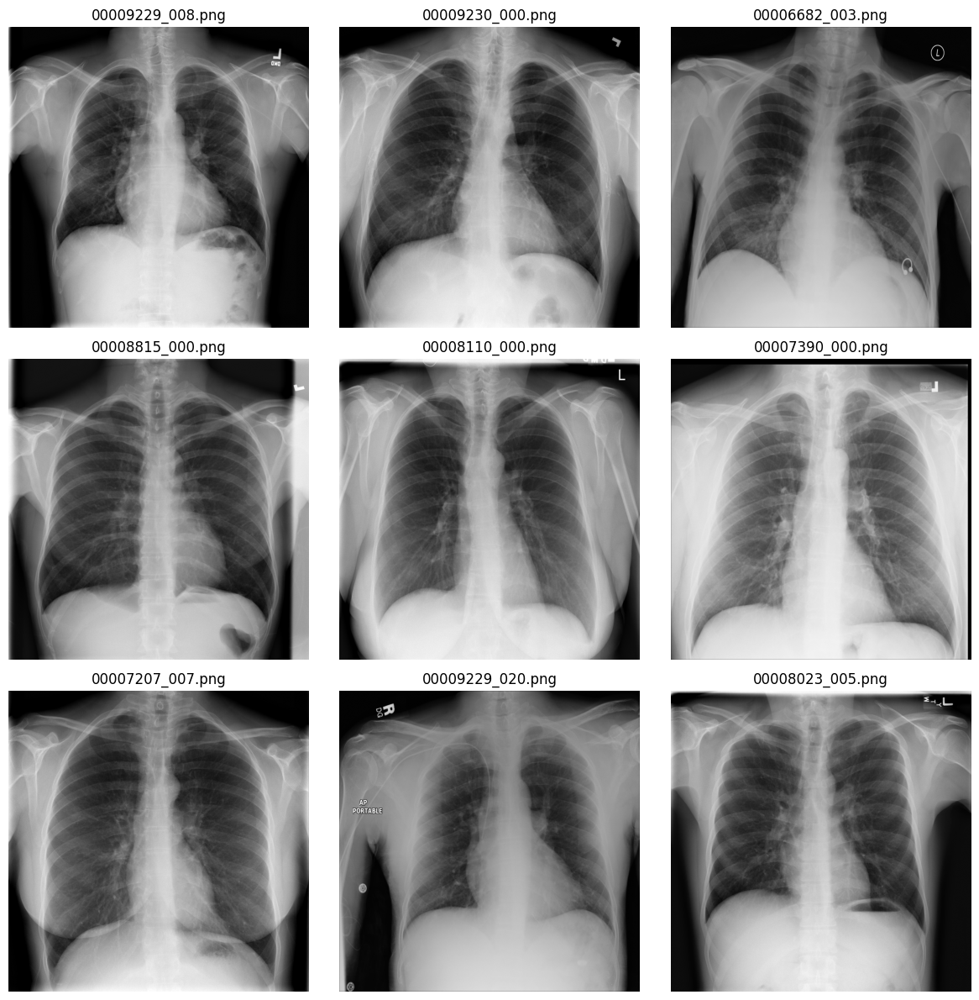

In [ ]:
plt.figure(figsize=(12, 12))
for i, img in enumerate(selected_images):
    plt.subplot(3, 3, i + 1)  # 3x3
    plt.imshow(img, cmap='gray')
    plt.title(random_images['Image'].iloc[i])
    plt.axis('off')
plt.tight_layout()
plt.show()

#3. Görüntü İşleme ve İyileştirme (Pre-processing)

###3.1. Crop, görüntüyü kenarlardan kırpmak için kullanılan basit bir fonksiyon. Varsayılan olarak her kenardan 50 piksel kırpar. Manuel ya da dinamik olarak seçim yapılabilir.

  Parametreler:
  
    - top: Üstten kırpılacak piksel sayısı
    - bottom: Alttan kırpılacak piksel sayısı
    - left: Soldan kırpılacak piksel sayısı
    - right: Sağdan kırpılacak piksel sayısı

  # Görüntüyü sabit parametrelerle kırpma fonksiyonu kullanarak yeniden ölçeklendiriyoruz

In [ ]:

  def crop_image(image, top=60, bottom=160, left=100, right=100):
      """Görüntüyü her bir kenardan sabit piksel değerleriyle kırpar."""
      if image.shape[0] <= (top + bottom) or image.shape[1] <= (left + right):
            raise ValueError("Kırpma parametreleri görüntü boyutlarından büyük olamaz.")
      return image[top:image.shape[0]-bottom, left:image.shape[1]-right]

# Orijinal ve kırpılmış görüntüleri görselleştiriyoruz

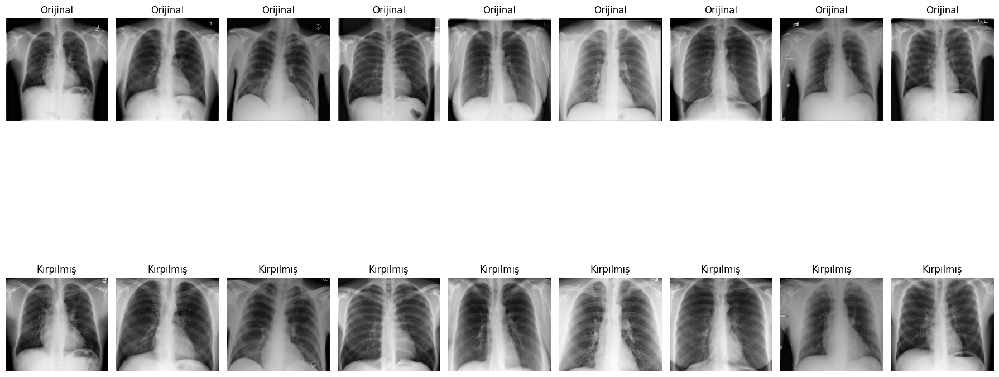

In [ ]:

    cropped_images = [crop_image(img, top=80, bottom=150, left=80, right=80) for img in selected_images]

    plt.figure(figsize=(18, 12))

    for i, (original, cropped) in enumerate(zip(selected_images, cropped_images)):
        # Orijinal görüntü
        plt.subplot(2, 9, i + 1)
        plt.imshow(original, cmap='gray')
        plt.title("Orijinal")
        plt.axis("off")

        # Kırpılmış görüntü
        plt.subplot(2, 9, i + 10)
        plt.imshow(cropped, cmap='gray')
        plt.title("Kırpılmış")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


###3.2. Kontrast Germe (Stretching) ve Histogram Eşitleme (Equalization)

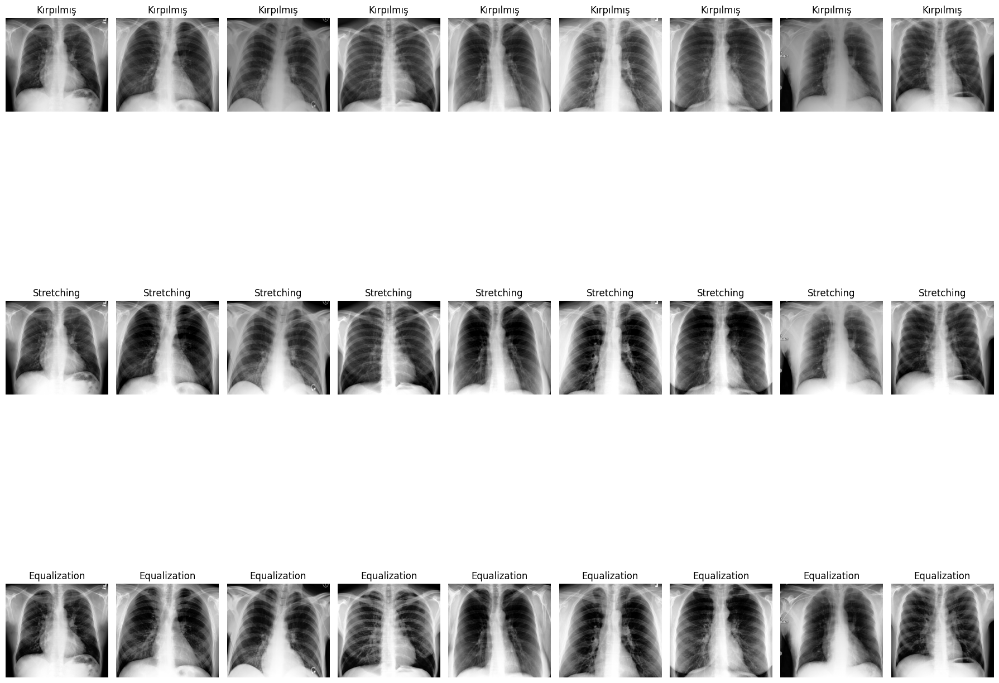

In [ ]:
    def contrast_stretching(image):
        """Görüntüye kontrast germe işlemi uygular."""
        p2, p98 = np.percentile(image, (2, 98))  # %2 ve %98 yüzdelik değerlerini alıyoruz
        stretched_image = exposure.rescale_intensity(image, in_range=(p2, p98))
        return stretched_image

    def histogram_equalization(image):
        """Görüntüye histogram eşitleme işlemi uygular."""
        equalized_image = exposure.equalize_hist(image)
        return equalized_image

    # Kontrast germe ve histogram eşitleme işlemlerini uyguluyoruz
    stretched_images = [contrast_stretching(img) for img in cropped_images]
    equalized_images = [histogram_equalization(img) for img in cropped_images]

    # Görselleştiriyoruz
    plt.figure(figsize=(18, 18))

    for i, (cropped, stretched, equalized) in enumerate(zip(cropped_images, stretched_images, equalized_images)):
        # Kırpılmış görüntü
        plt.subplot(3, 9, i + 1)
        plt.imshow(cropped, cmap='gray')
        plt.title("Kırpılmış")
        plt.axis("off")

        # Kontrast gerilmiş görüntü
        plt.subplot(3, 9, i + 10)
        plt.imshow(stretched, cmap='gray')
        plt.title("Stretching")
        plt.axis("off")

        # Histogram eşitlenmiş görüntü
        plt.subplot(3, 9, i + 19)
        plt.imshow(equalized, cmap='gray')
        plt.title("Equalization")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

### 3.3. Gürültü Azaltma İşlemleri (Median ve Gaussian Blur)

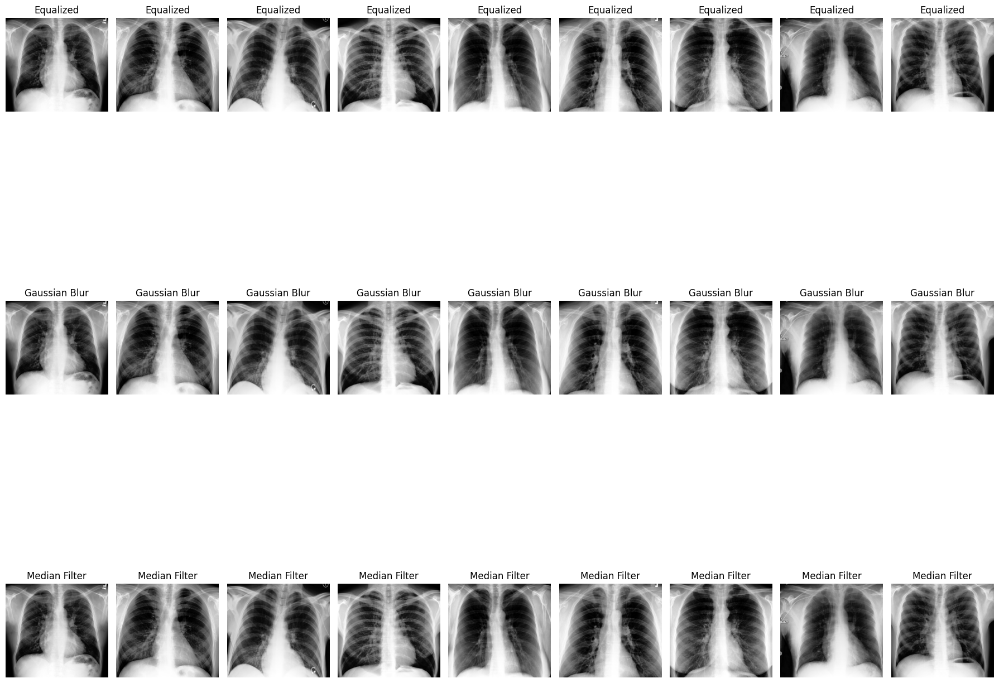

In [ ]:
    def apply_gaussian_blur(image, sigma=1):
        """Gaussian Blur yöntemiyle gürültü azaltır."""
        return gaussian_filter(image, sigma=sigma)

    def apply_median_filter(image, size=3):
        """Median Filter yöntemiyle gürültü azaltır."""
        return median_filter(image, size=size)

    # Gürültü azaltma işlemlerini uyguluyoruz
    gaussian_blurred_images = [apply_gaussian_blur(img) for img in equalized_images]
    median_filtered_images = [apply_median_filter(img) for img in equalized_images]

    # Gürültü azaltılmış görüntüleri görselleştiriyoruz
    plt.figure(figsize=(18, 18))

    for i, (equalized, gaussian_blurred, median_filtered) in enumerate(zip(equalized_images, gaussian_blurred_images, median_filtered_images)):
        # Histogram eşitlenmiş görüntü
        plt.subplot(3, 9, i + 1)
        plt.imshow(equalized, cmap='gray')
        plt.title("Equalized")
        plt.axis("off")

        # Gaussian Blur uygulanmış görüntü
        plt.subplot(3, 9, i + 10)
        plt.imshow(gaussian_blurred, cmap='gray')
        plt.title("Gaussian Blur")
        plt.axis("off")

        # Median Filter uygulanmış görüntü
        plt.subplot(3, 9, i + 19)
        plt.imshow(median_filtered, cmap='gray')
        plt.title("Median Filter")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


# 3.4. Gauss Yoğunluk Dönüşümü ile Eşikleme

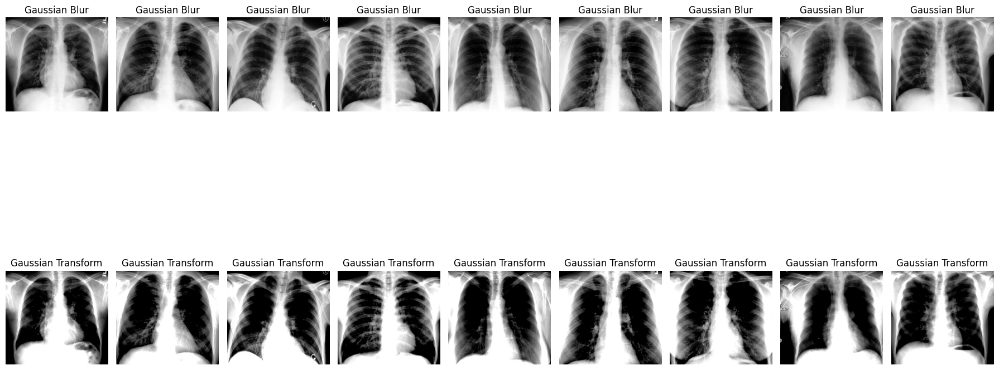

In [ ]:
    def gaussian_intensity_transform(image, mean=None, std=None):
        """Görüntüye Gauss yoğunluk dönüşümü uygular ve eşikleme yapar."""
        if mean is None:
            mean = np.mean(image)
        if std is None:
            std = np.std(image)

        lower_bound = mean - std
        upper_bound = mean + std

        transformed_image = np.clip(image, lower_bound, upper_bound)
        transformed_image = (transformed_image - lower_bound) / (upper_bound - lower_bound)  # Normalize et
        return transformed_image

    # Eşikleme işlemini uyguluyoruz
    gaussian_transformed_images = [gaussian_intensity_transform(img) for img in gaussian_blurred_images]

    # Eşiklenmiş görüntüleri görselleştiriyoruz
    plt.figure(figsize=(18, 12))

    for i, (original, transformed) in enumerate(zip(gaussian_blurred_images, gaussian_transformed_images)):
        # Orijinal Gaussian Blur görüntü
        plt.subplot(2, 9, i + 1)
        plt.imshow(original, cmap='gray')
        plt.title("Gaussian Blur")
        plt.axis("off")

        # Gauss yoğunluk dönüşümü uygulanmış görüntü
        plt.subplot(2, 9, i + 10)
        plt.imshow(transformed, cmap='gray')
        plt.title("Gaussian Transform")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


#Görüntülerin Gauss Yoğunluk Dağılımı
### Her kırpılmış görüntü için ortalama ve standart sapma hesaplıyoruz ve görselleştiriyoruz.

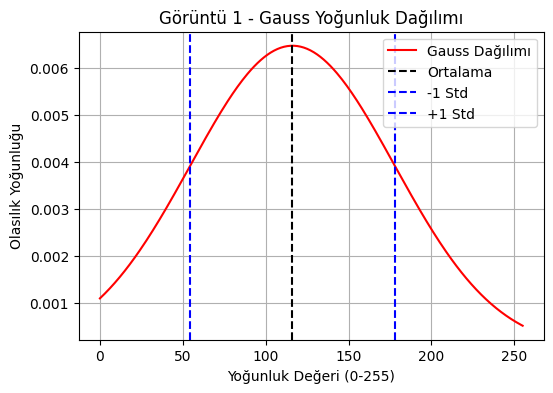

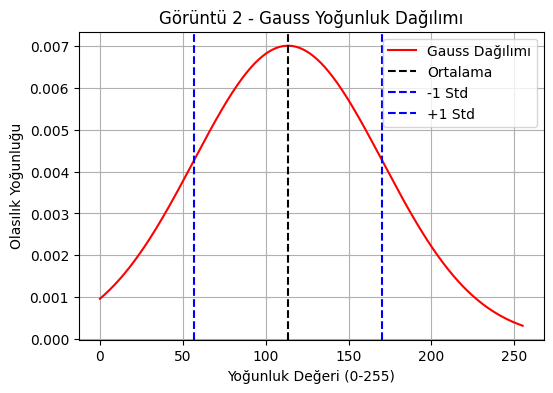

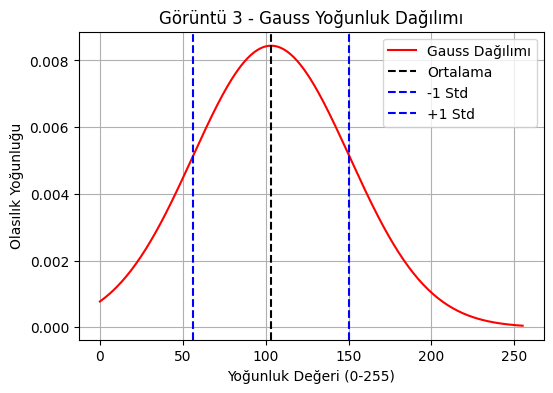

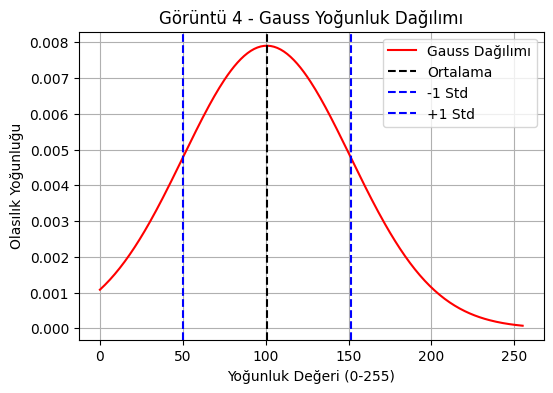

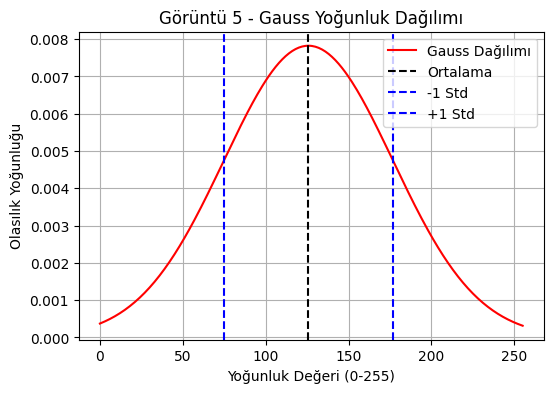

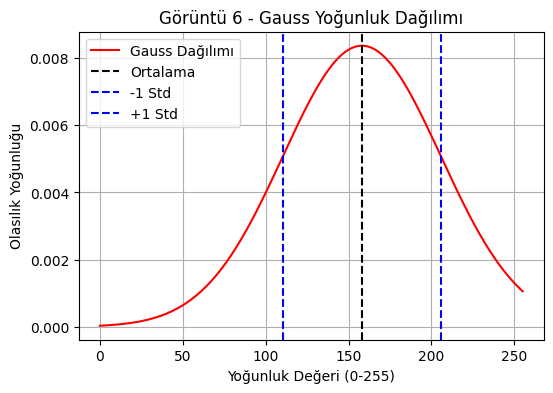

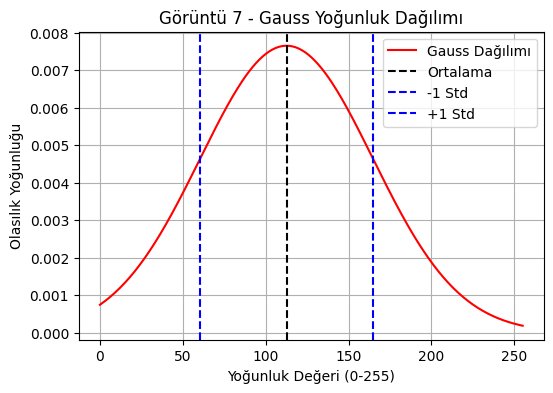

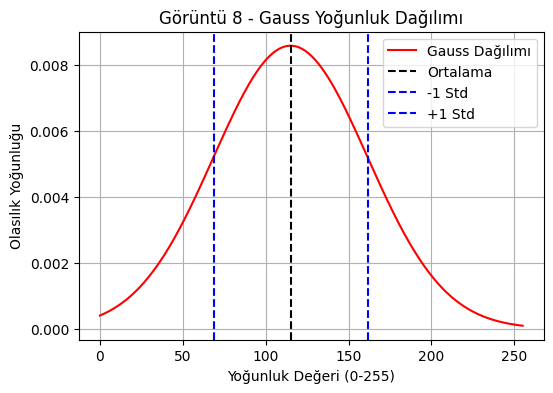

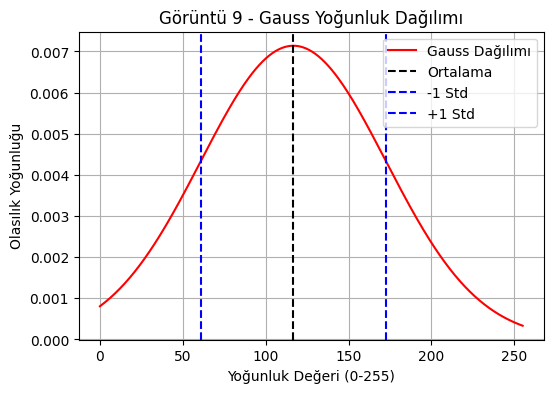

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


means = [np.mean(img) for img in cropped_images]
stds = [np.std(img) for img in cropped_images]


for i, (image, mean, std) in enumerate(zip(cropped_images, means, stds)):
    plt.figure(figsize=(6, 4))  # Grafik boyutunu ayarla

    # Yoğunluk değerlerini temsil eden x ekseni (0-255 arası)
    x = np.linspace(0, 255, 256)

    # Gauss yoğunluk fonksiyonunu hesaplıyoruz
    gauss_curve = (1 / (std * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mean) / std) ** 2)

    # Gauss eğrisini çiziyoruz
    plt.plot(x, gauss_curve, color='red', label='Gauss Dağılımı')

    # Ortalama değeri gösteren dikey çizgi
    plt.axvline(mean, color='black', linestyle='--', label='Ortalama')

    # -1 ve +1 standart sapmaları gösteren dikey çizgiler
    plt.axvline(mean - std, color='blue', linestyle='--', label='-1 Std')
    plt.axvline(mean + std, color='blue', linestyle='--', label='+1 Std')

    # Grafik çiziyoruz
    plt.title(f"Görüntü {i + 1} - Gauss Yoğunluk Dağılımı")
    plt.xlabel("Yoğunluk Değeri (0-255)")
    plt.ylabel("Olasılık Yoğunluğu")
    plt.legend()
    plt.grid()
    plt.show()



### 3.4.	Eşik Sayısı Eelirleme

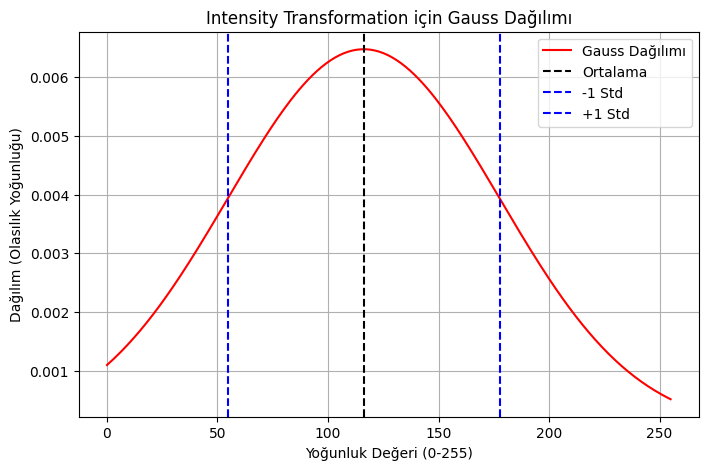

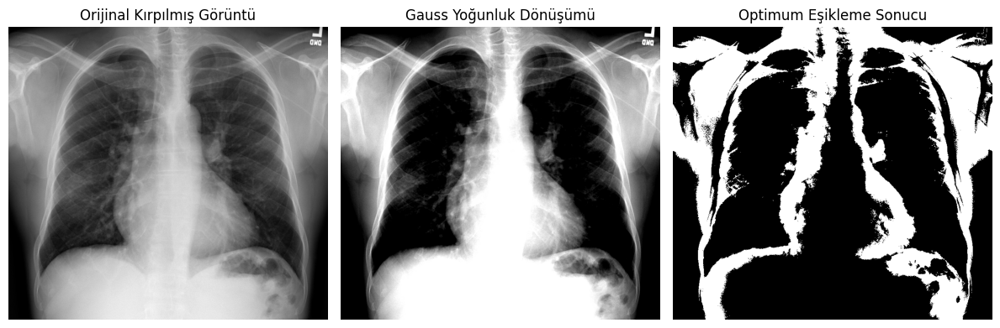

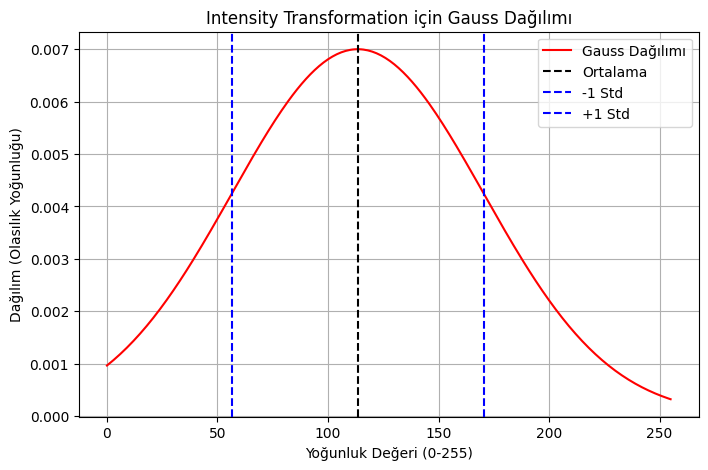

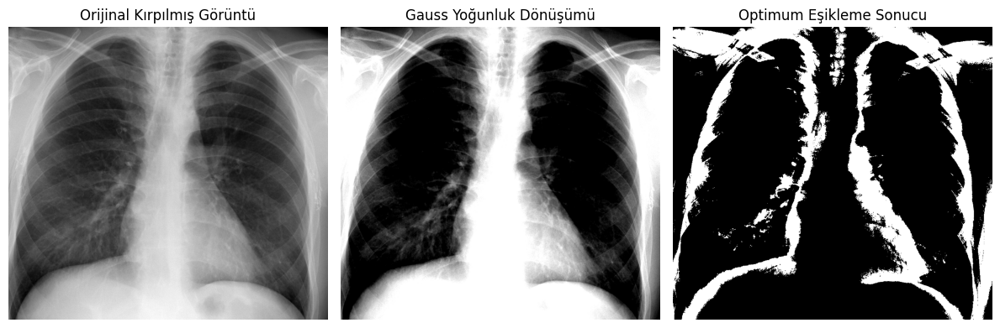

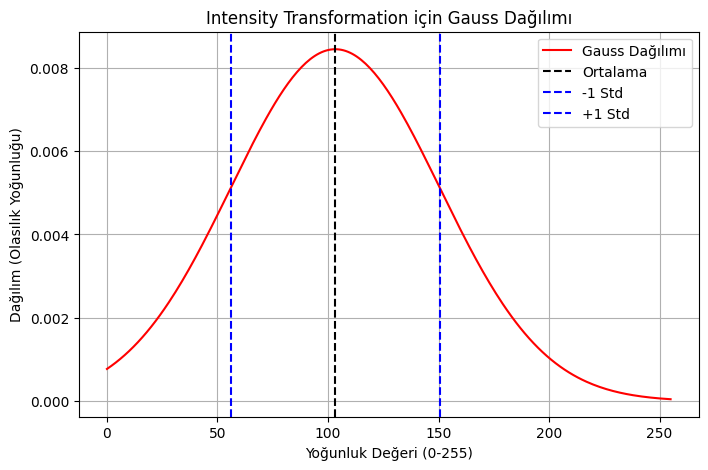

...

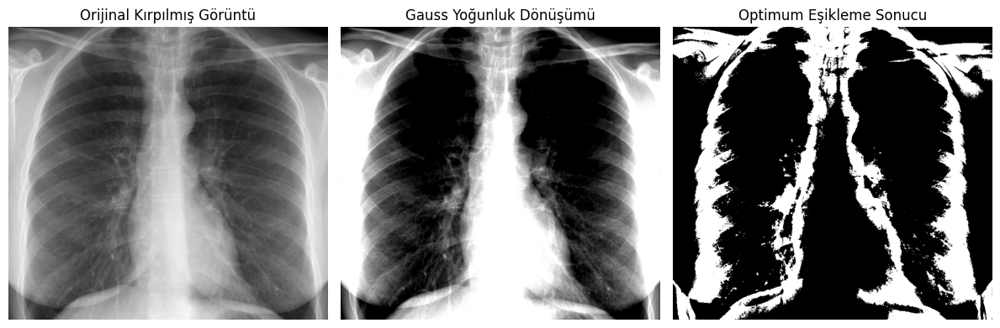

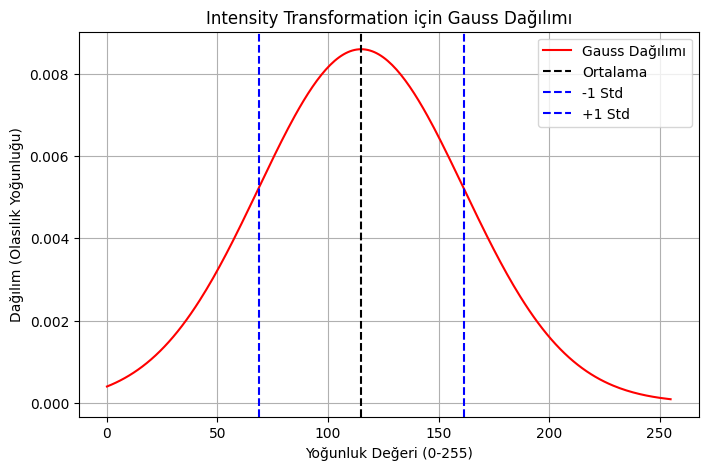

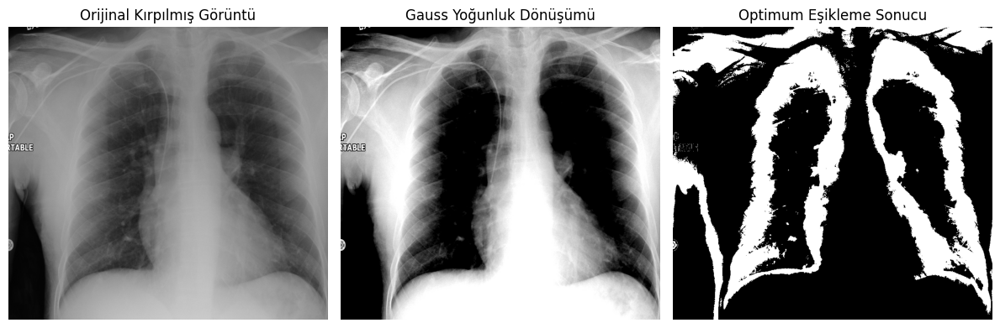

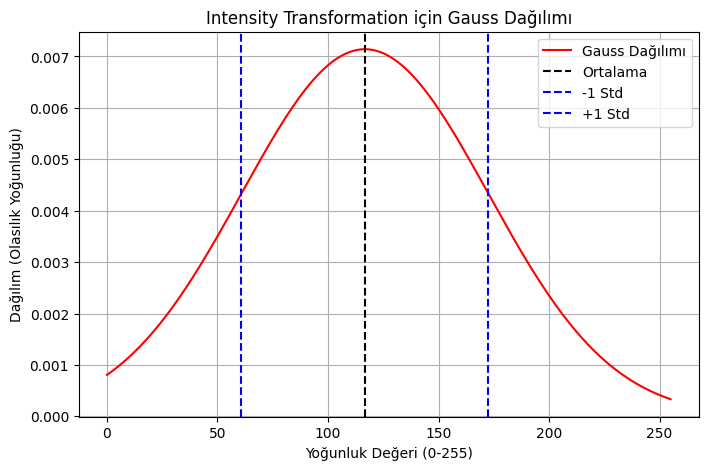

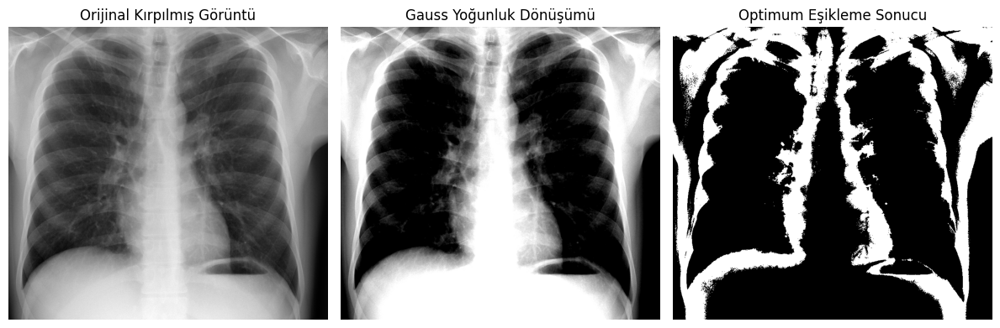

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import threshold_multiotsu
from scipy.stats import norm

def gaussian_intensity_transform(image):
    """Görüntüye Gauss yoğunluk dönüşümü uygular ve dinamik eşikleme yapar."""

    mean = np.mean(image)  # Dinamik Ortalama
    std = np.std(image)    # Dinamik Standart Sapma

    lower_bound = mean - std
    upper_bound = mean + std

    # Yoğunluğu normalize et (Bu aralıkta kalan pikseller vurgulanacak)
    transformed_image = np.clip(image, lower_bound, upper_bound)
    transformed_image = (transformed_image - lower_bound) / (upper_bound - lower_bound)

    return transformed_image, mean, std

# Örnek: Kırpılmış Görüntüler için Gauss Dönüşümü ve Histogram Çizimi
for i, cropped_image in enumerate(cropped_images):
    transformed_image, mean, std = gaussian_intensity_transform(cropped_image)

    # Histogram Grafiği
    plt.figure(figsize=(8, 5))
    x = np.linspace(0, 255, 256)
    gauss_curve = norm.pdf(x, mean, std)  # Gauss Dağılımı
    plt.plot(x, gauss_curve, color='red', label='Gauss Dağılımı')

    # Ortalama ve Standart Sapma Çizgileri
    plt.axvline(mean, color='black', linestyle='--', label='Ortalama')
    plt.axvline(mean - std, color='blue', linestyle='--', label='-1 Std')
    plt.axvline(mean + std, color='blue', linestyle='--', label='+1 Std')

    plt.title("Intensity Transformation için Gauss Dağılımı")
    plt.xlabel("Yoğunluk Değeri (0-255)")
    plt.ylabel("Dağılım (Olasılık Yoğunluğu)")
    plt.legend()
    plt.grid()
    plt.show()

    # Tek eşik mi? Çoklu eşik mi?
    num_thresholds = 2  # 2 için alt-orta-üst, 5 için detaylı bölgeleme

    # Multi-Otsu ile Bölgelere Ayırma
    thresholds = threshold_multiotsu(cropped_image, classes=num_thresholds + 1)
    multi_thresholded_image = np.digitize(cropped_image, bins=thresholds)

    # Orta bölgeyi 1, diğer her şeyi 0 yap
    binary_segmented = np.where((multi_thresholded_image == 1), 1, 0)

    # Segmentasyonu Görselleştir
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(cropped_image, cmap='gray')
    plt.title("Orijinal Kırpılmış Görüntü")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(transformed_image, cmap='gray')
    plt.title("Gauss Yoğunluk Dönüşümü")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(binary_segmented, cmap='gray')
    plt.title("Optimum Eşikleme Sonucu")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


# 4. Thresholding
### 4.1. Thresholding (Global ve Otsu): Eşik değerlerini görüntülere uygulayarak binary görüntüleri görselleştirip uygun thresholding yöntemini seçildi ve yorumlar eklendi.

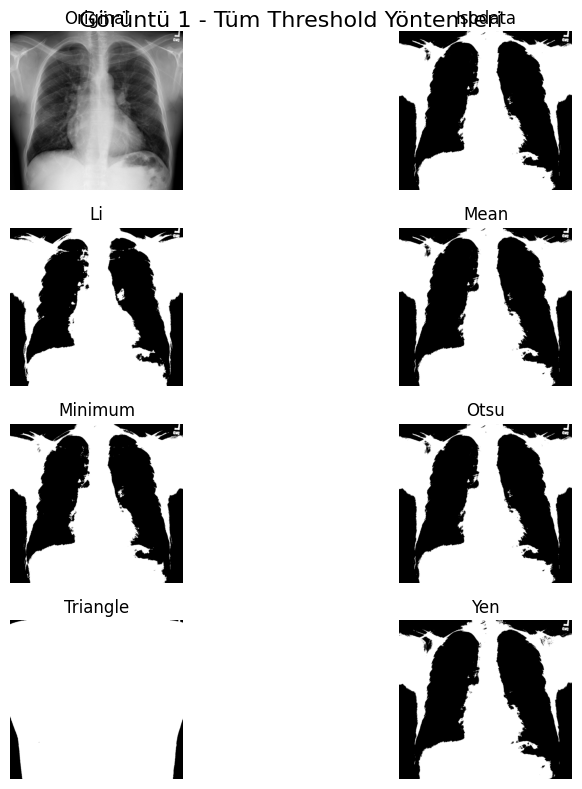

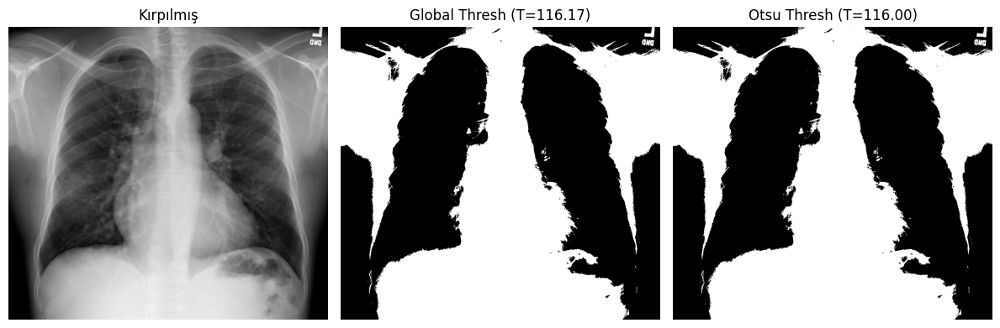

Görüntü 1:
  - Global Thresholding ile belirlenen eşik: 116.17
  - Otsu Thresholding ile belirlenen eşik: 116.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




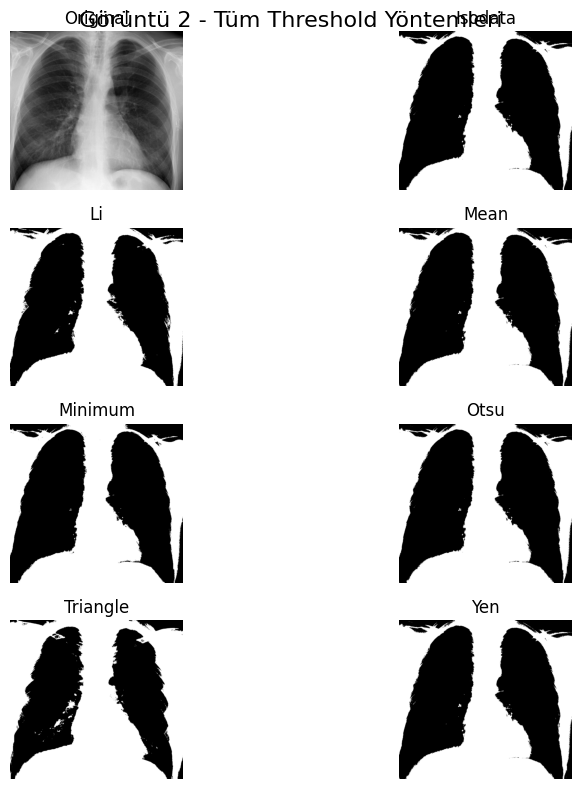

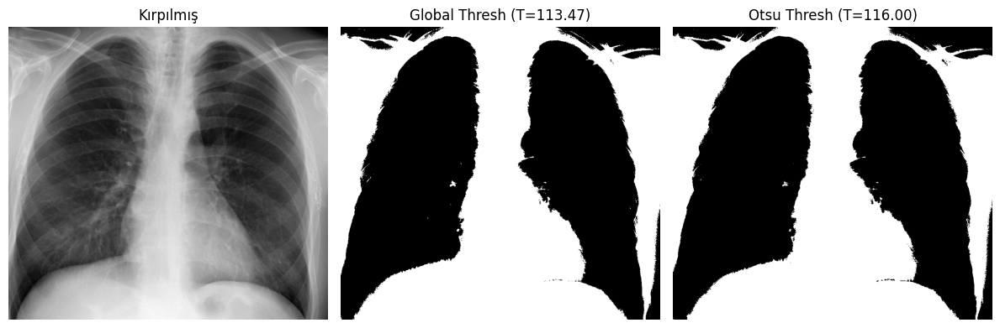

Görüntü 2:
  - Global Thresholding ile belirlenen eşik: 113.47
  - Otsu Thresholding ile belirlenen eşik: 116.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




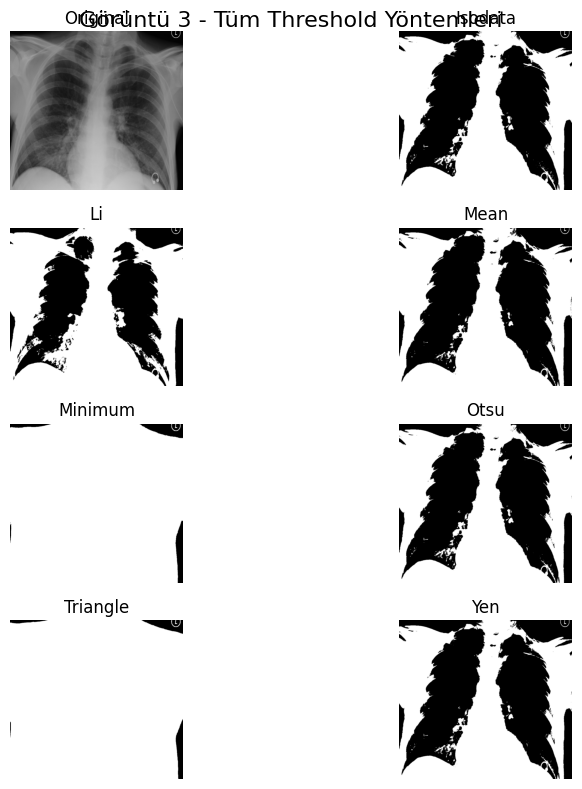

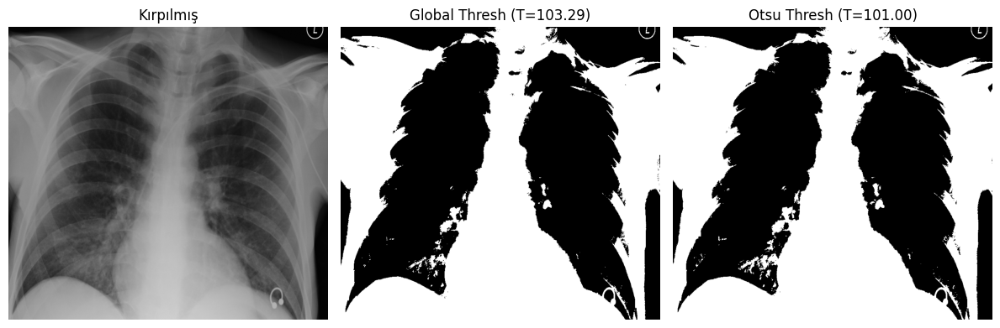

Görüntü 3:
  - Global Thresholding ile belirlenen eşik: 103.29
  - Otsu Thresholding ile belirlenen eşik: 101.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




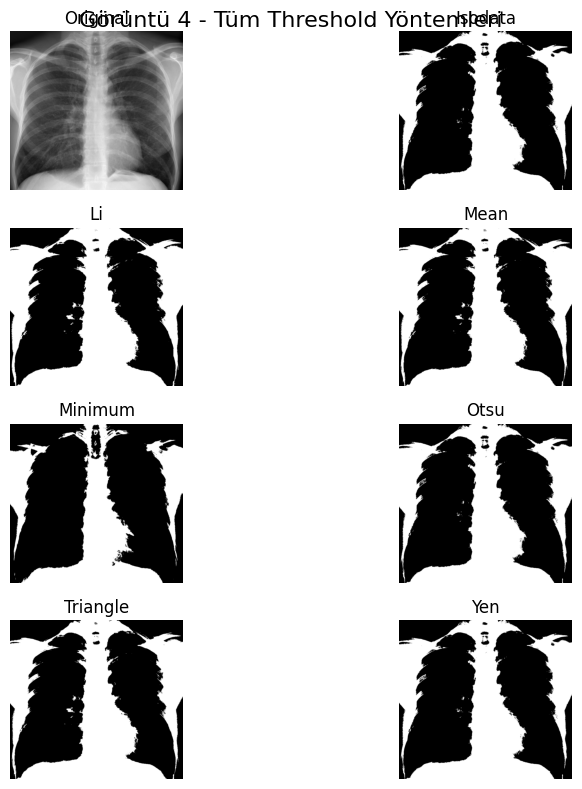

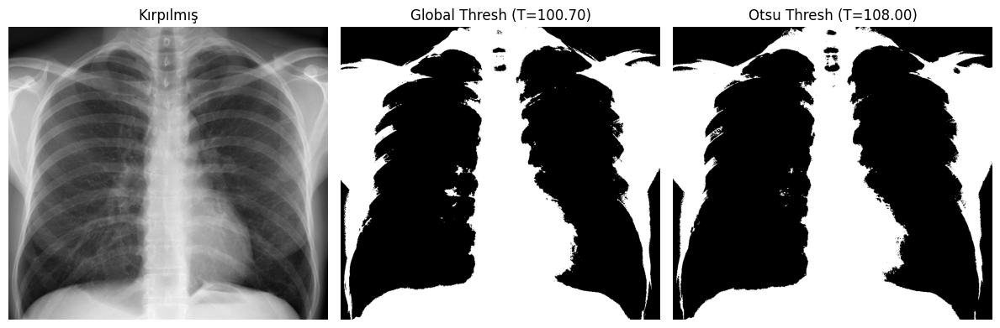

Görüntü 4:
  - Global Thresholding ile belirlenen eşik: 100.70
  - Otsu Thresholding ile belirlenen eşik: 108.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




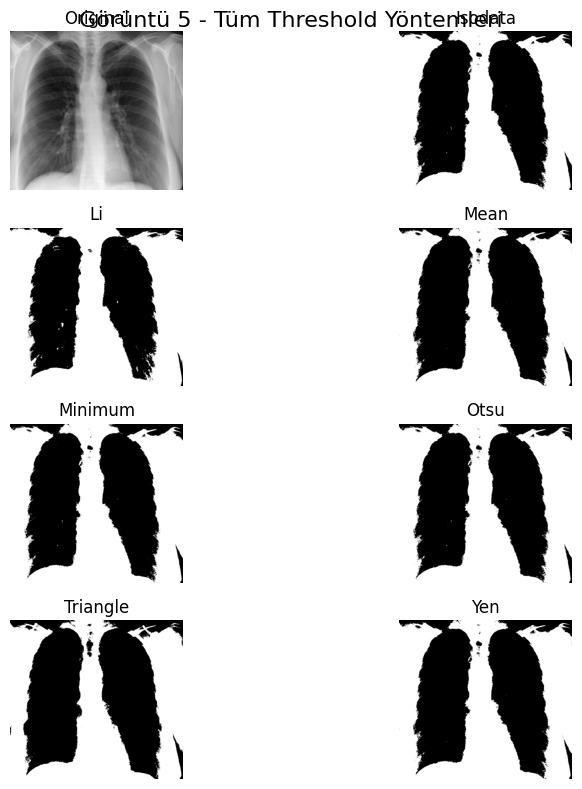

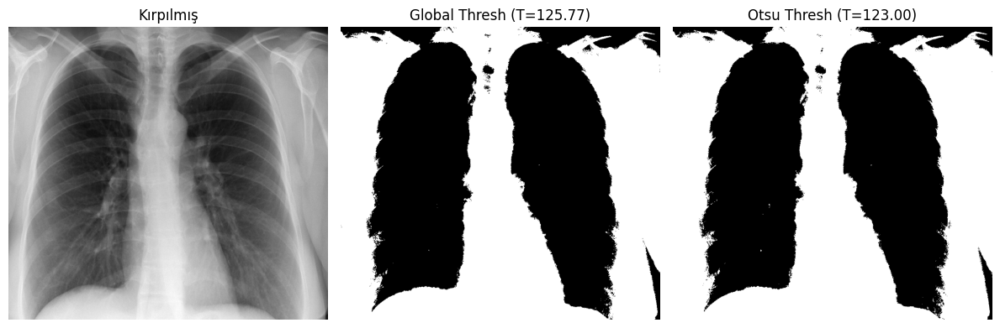

Görüntü 5:
  - Global Thresholding ile belirlenen eşik: 125.77
  - Otsu Thresholding ile belirlenen eşik: 123.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




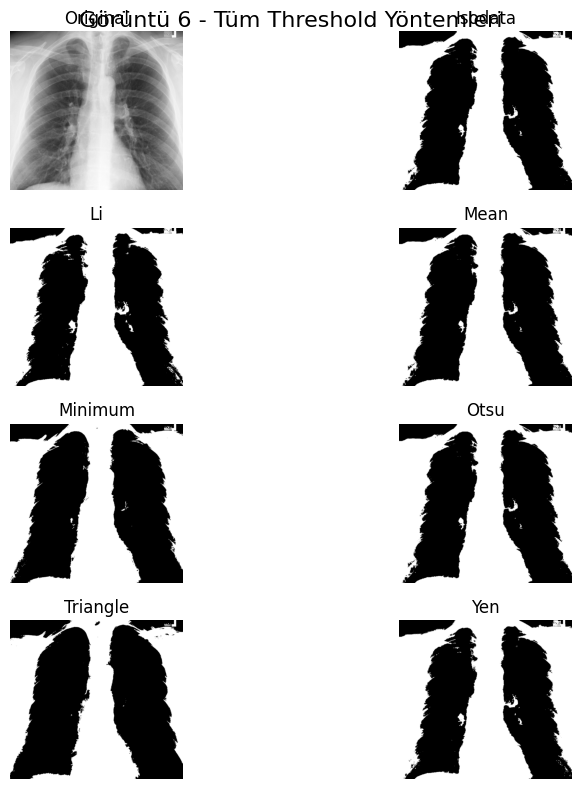

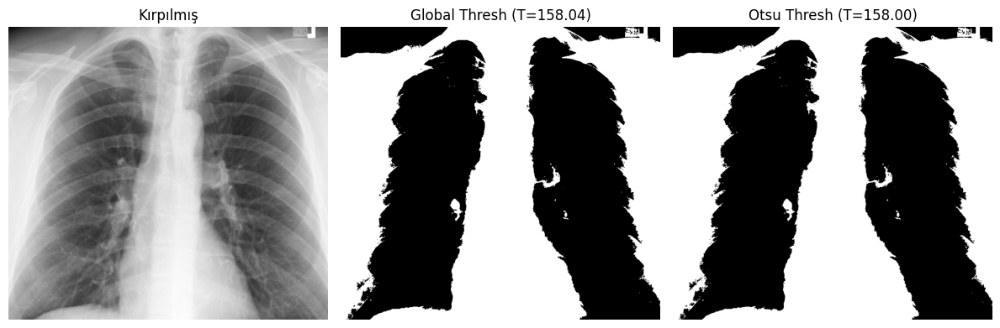

Görüntü 6:
  - Global Thresholding ile belirlenen eşik: 158.04
  - Otsu Thresholding ile belirlenen eşik: 158.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




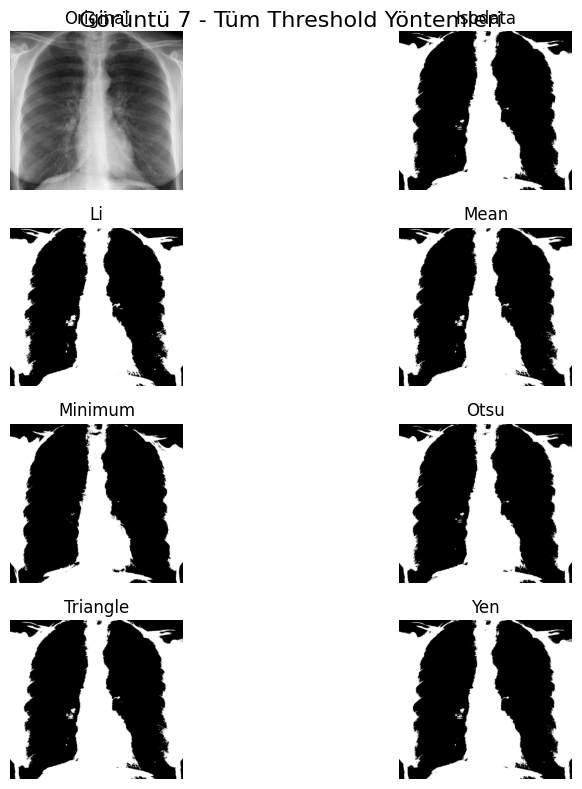

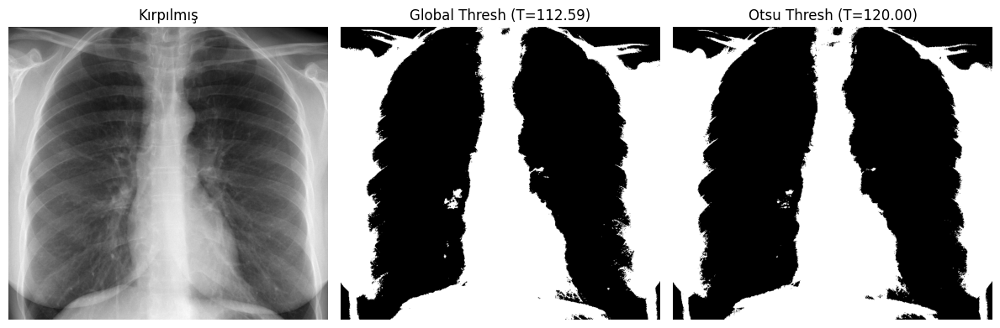

Görüntü 7:
  - Global Thresholding ile belirlenen eşik: 112.59
  - Otsu Thresholding ile belirlenen eşik: 120.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




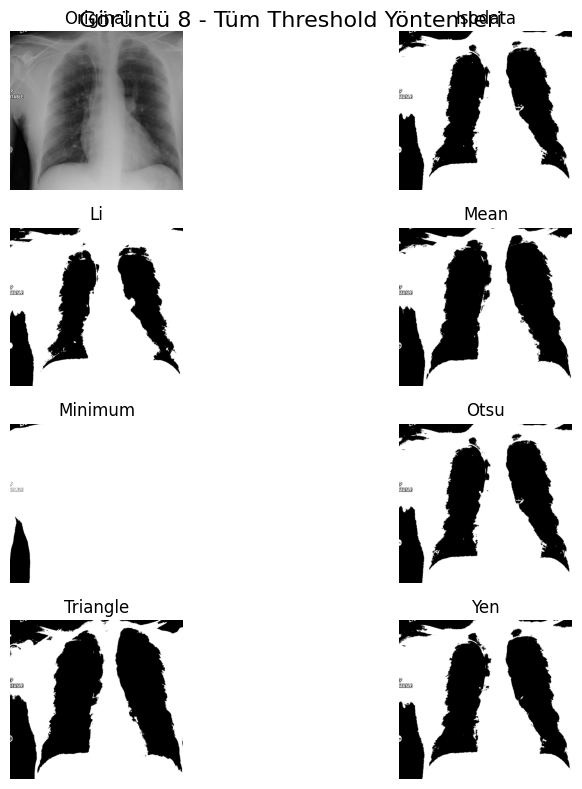

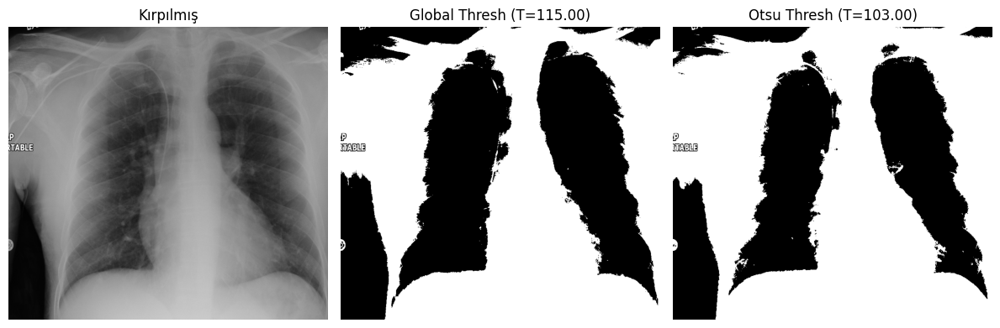

Görüntü 8:
  - Global Thresholding ile belirlenen eşik: 115.00
  - Otsu Thresholding ile belirlenen eşik: 103.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




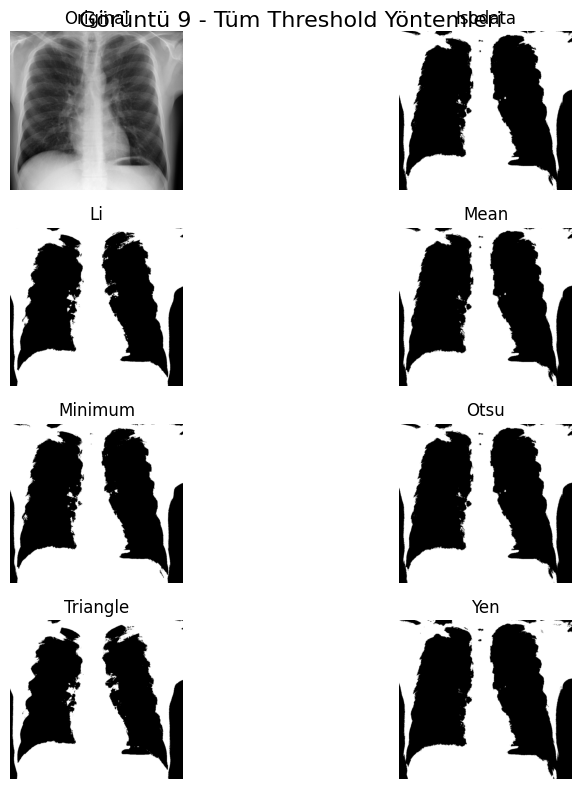

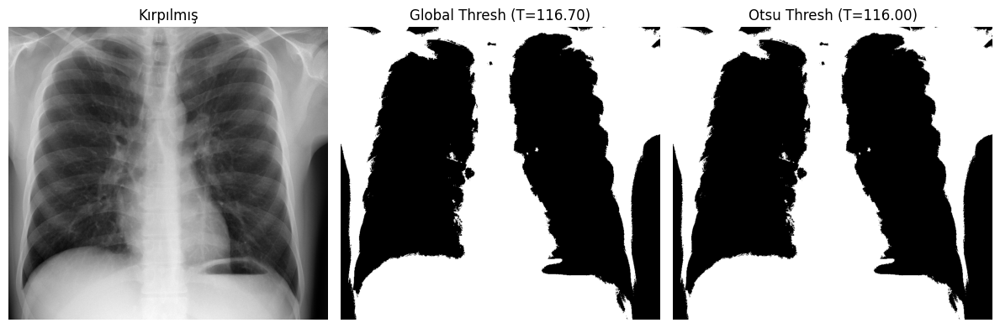

Görüntü 9:
  - Global Thresholding ile belirlenen eşik: 116.70
  - Otsu Thresholding ile belirlenen eşik: 116.00
  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. 
         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.




In [ ]:
    binary_images = []
    for i, cropped in enumerate(cropped_images):
        # Global Thresholding
        global_thresh = np.mean(cropped)
        binary_global = cropped > global_thresh

        # Otsu Thresholding
        otsu_thresh = threshold_otsu(cropped)
        binary_otsu = cropped > otsu_thresh

        # Otsu sonucu seçimi
        binary_images.append(binary_otsu)

        # Tüm threshold yöntemlerini gösteriyoruz
        fig, ax = try_all_threshold(cropped, figsize=(10, 8), verbose=False)
        plt.suptitle(f"Görüntü {i+1} - Tüm Threshold Yöntemleri", fontsize=16)
        plt.show()
        plt.figure(figsize=(12, 6))

        # Orijinal görüntü
        plt.subplot(1, 3, 1)
        plt.imshow(cropped, cmap='gray')
        plt.title("Kırpılmış")
        plt.axis("off")

        # Global Thresholding sonucu
        plt.subplot(1, 3, 2)
        plt.imshow(binary_global, cmap='gray')
        plt.title(f"Global Thresh (T={global_thresh:.2f})")
        plt.axis("off")

        # Otsu Thresholding sonucu
        plt.subplot(1, 3, 3)
        plt.imshow(binary_otsu, cmap='gray')
        plt.title(f"Otsu Thresh (T={otsu_thresh:.2f})")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        # Yorum için sonuçlar yazdırıyoruz
        print(f"Görüntü {i+1}:")
        print(f"  - Global Thresholding ile belirlenen eşik: {global_thresh:.2f}")
        print(f"  - Otsu Thresholding ile belirlenen eşik: {otsu_thresh:.2f}")
        print("  Yorum: Global Thresholding, sabit bir eşik değerine dayalıdır ve kontrast düşükse yetersiz kalabilir. ")
        print("         Otsu Thresholding ise histogram bilgisine dayalıdır ve daha adaptiftir, genellikle daha iyi sonuç verir.")
        print("\n")

# 5. Post-Processing (Morfolojik Operasyonlar)

### 5.1.	Uygun morfolojik operatörleri, uygun structural element yapısı ve boyutunu seçerek görüntüye uyguluyoruz. Giriş ve Çıkış görüntülerini görseleştiriyoruz.


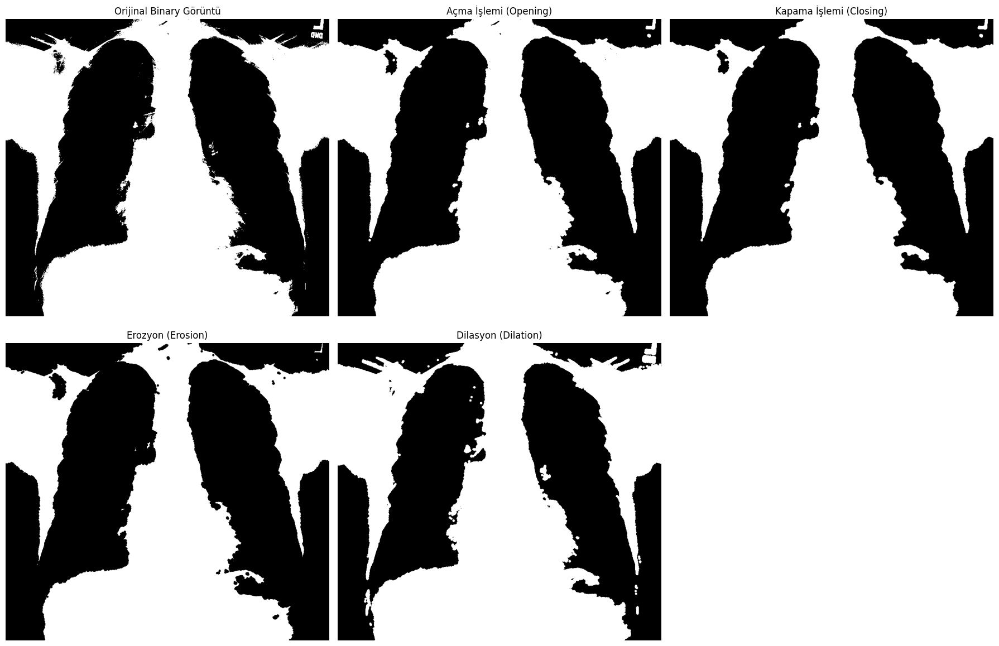

Görüntü 1 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




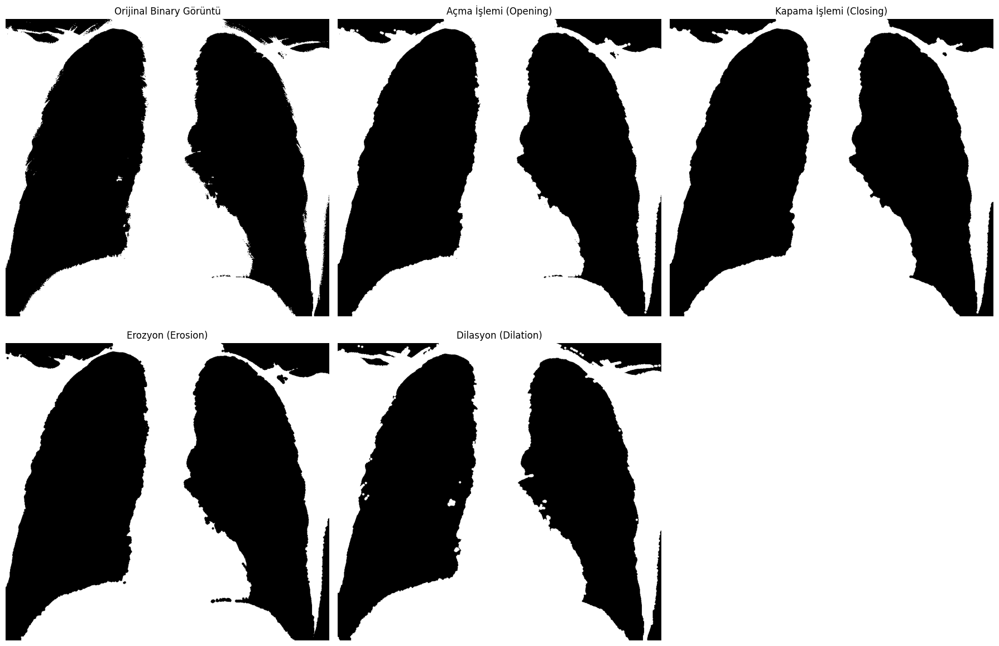

Görüntü 2 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




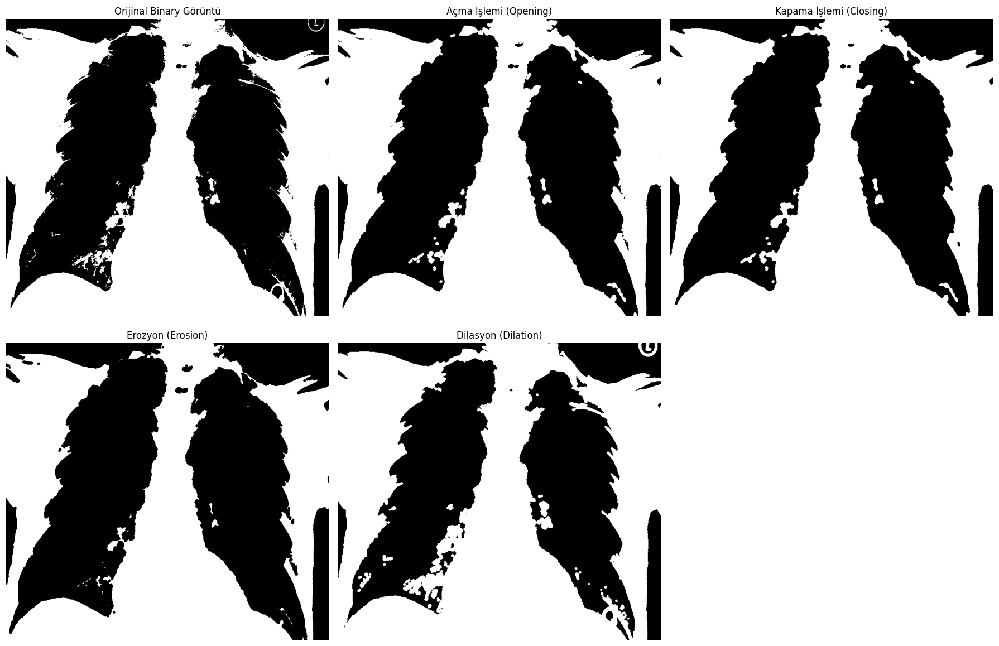

Görüntü 3 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




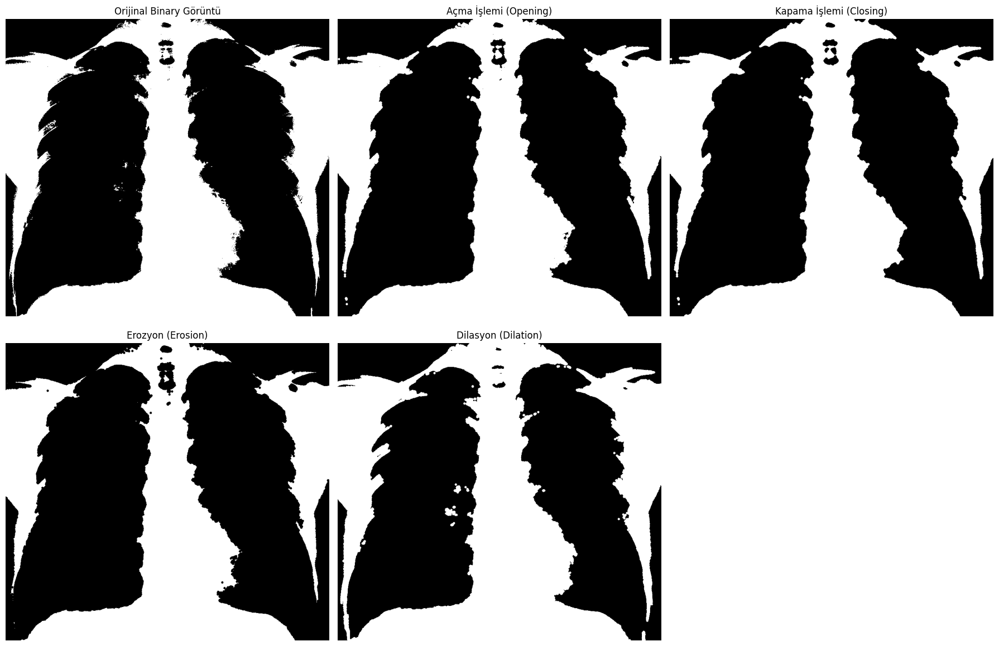

Görüntü 4 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




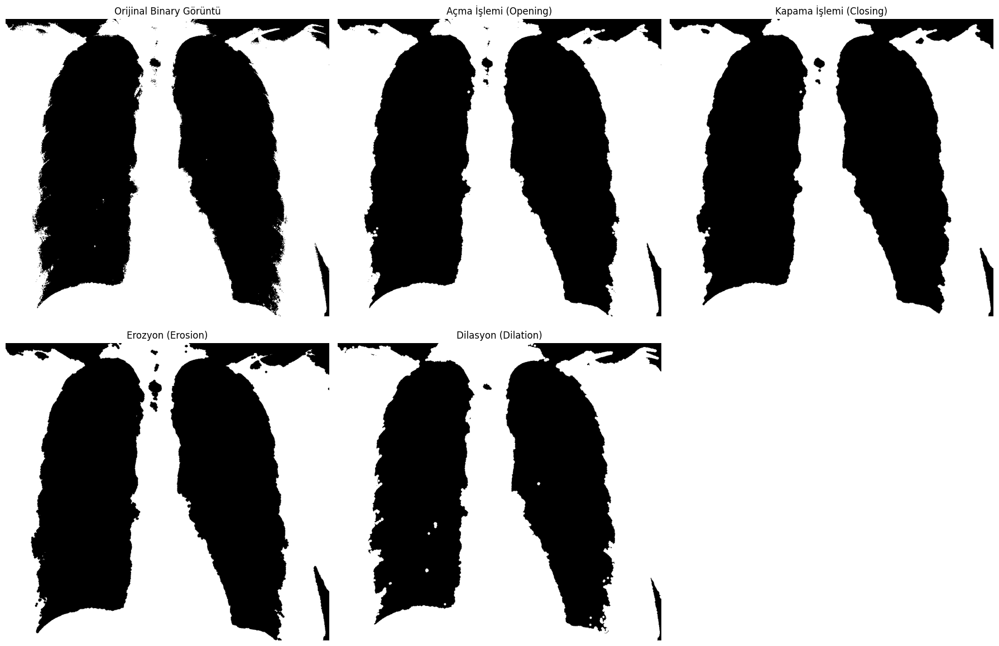

Görüntü 5 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




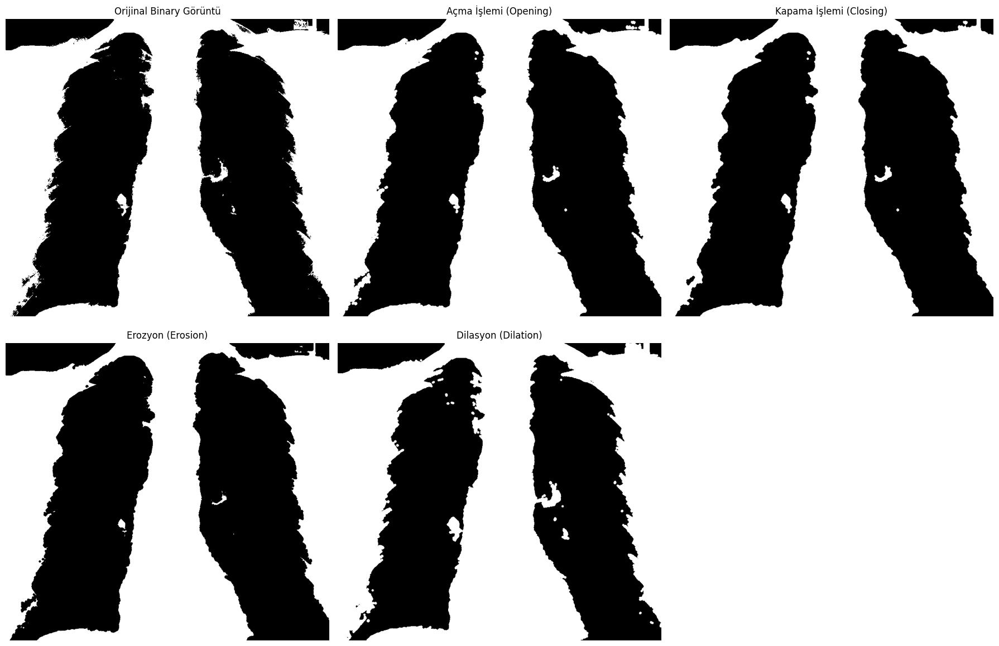

Görüntü 6 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




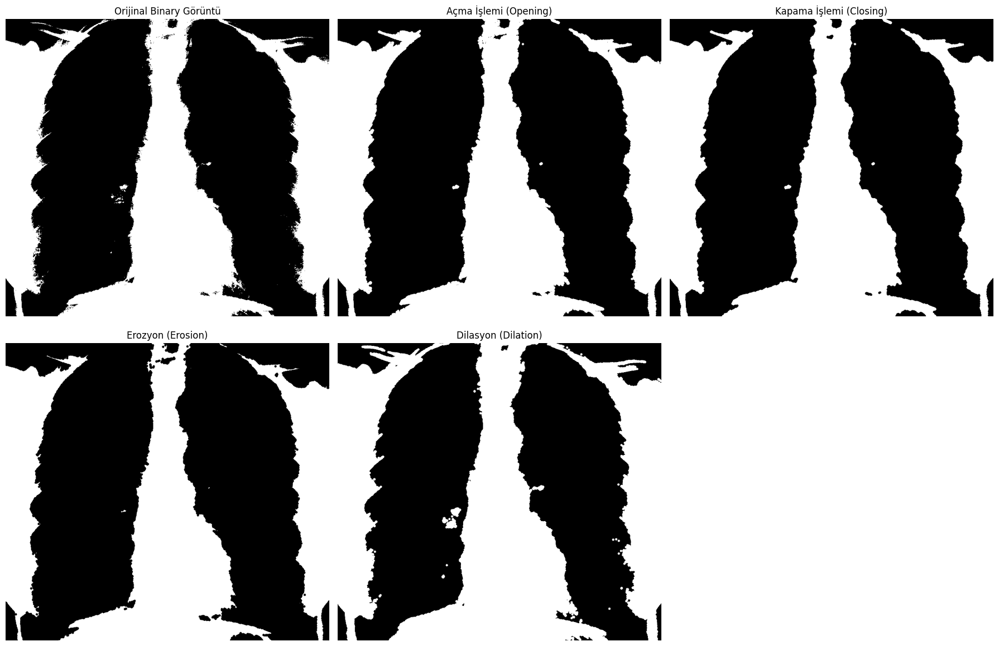

Görüntü 7 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




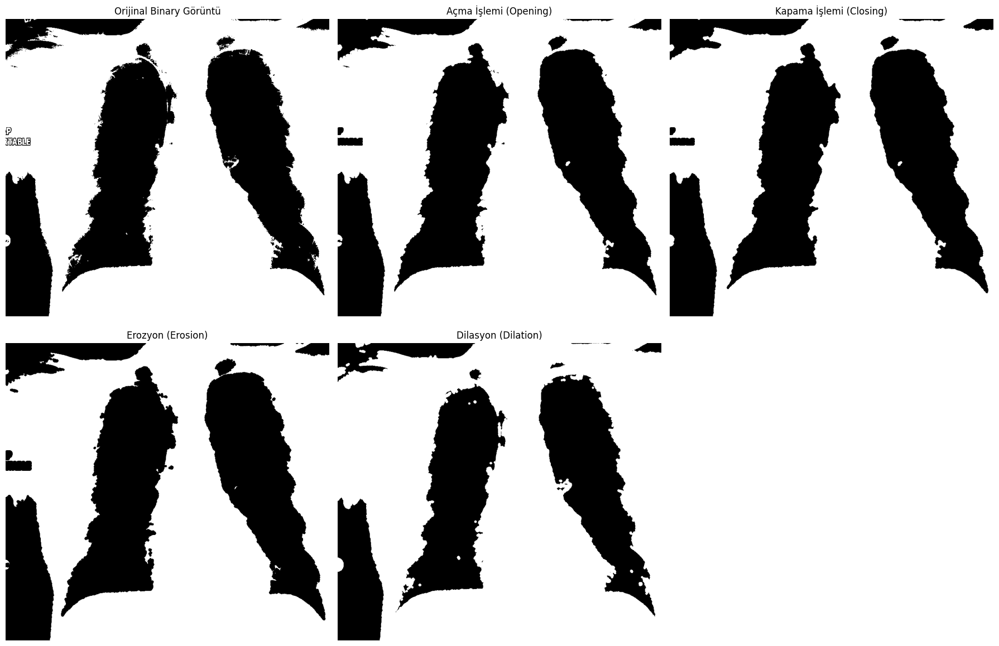

Görüntü 8 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




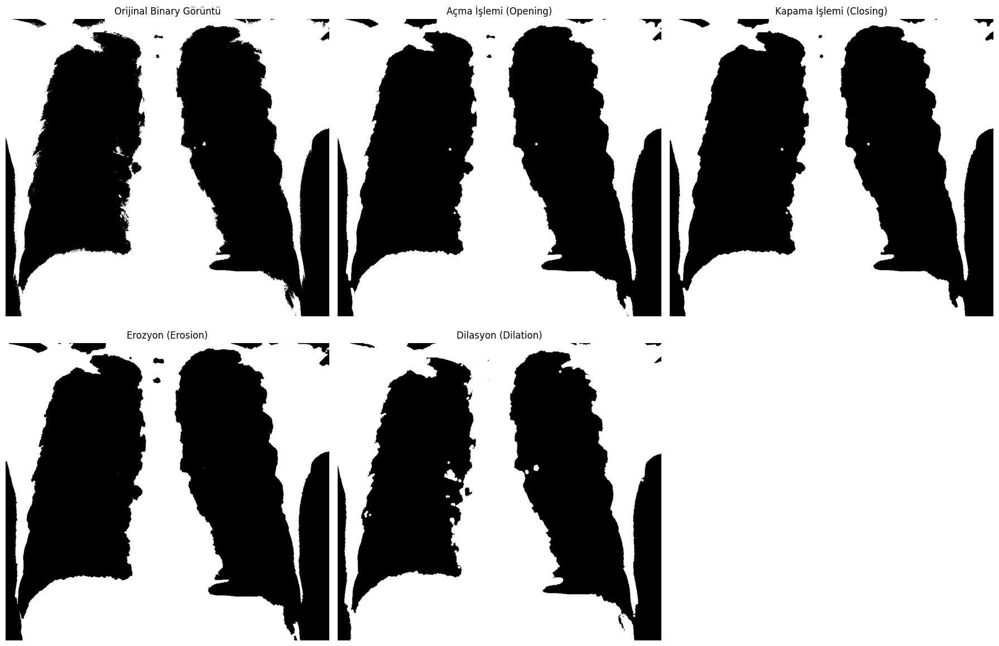

Görüntü 9 için Morfolojik İşlemler Tamamlandı.
  - Açma (Opening): Küçük gürültüler temizlendi.
  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.
  - Erozyon: Nesne sınırları daraltıldı.
  - Dilasyon: Nesne sınırları genişletildi.




In [ ]:
from skimage import morphology
import matplotlib.pyplot as plt

# Structural Element Seçimi
struct_elem = morphology.disk(3)  # Disk şeklinde kernel

for i, binary_image in enumerate(binary_images):
    # Açma İşlemi (Opening) → Küçük gürültüleri temizler
    opened_image = morphology.binary_opening(binary_image, struct_elem)

    # Kapama İşlemi (Closing) → Küçük boşlukları kapatır
    closed_image = morphology.binary_closing(opened_image, struct_elem)

    # Erozyon ve Dilasyon Testi
    eroded_image = morphology.binary_erosion(binary_image, struct_elem)
    dilated_image = morphology.binary_dilation(binary_image, struct_elem)

    # Görselleştirme
    plt.figure(figsize=(18, 12))

    plt.subplot(2, 3, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title("Orijinal Binary Görüntü")
    plt.axis("off")

    plt.subplot(2, 3, 2)
    plt.imshow(opened_image, cmap='gray')
    plt.title("Açma İşlemi (Opening)")
    plt.axis("off")

    plt.subplot(2, 3, 3)
    plt.imshow(closed_image, cmap='gray')
    plt.title("Kapama İşlemi (Closing)")
    plt.axis("off")

    plt.subplot(2, 3, 4)
    plt.imshow(eroded_image, cmap='gray')
    plt.title("Erozyon (Erosion)")
    plt.axis("off")

    plt.subplot(2, 3, 5)
    plt.imshow(dilated_image, cmap='gray')
    plt.title("Dilasyon (Dilation)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    # Bilgilendirme
    print(f"Görüntü {i+1} için Morfolojik İşlemler Tamamlandı.")
    print("  - Açma (Opening): Küçük gürültüler temizlendi.")
    print("  - Kapama (Closing): Nesne üzerindeki boşluklar dolduruldu.")
    print("  - Erozyon: Nesne sınırları daraltıldı.")
    print("  - Dilasyon: Nesne sınırları genişletildi.")
    print("\n")


### 5.2.	Görüntüye bağlantı bileşen analizi

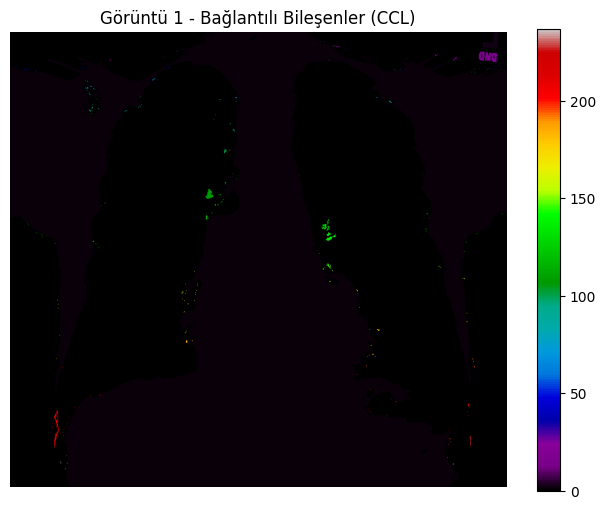

Görüntü 1 için bağlantılı bileşen sayısı: 238

Görüntü 1 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 340007
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [428.98098863 428.80004529]
  - Bölge 2:
    - Alan: 410
    - Bounding Box: (x=821, y=0, w=28, h=31)
    - Merkez Koordinatları: [838.21219512  18.5       ]
  - Bölge 3:
    - Alan: 2
    - Bounding Box: (x=337, y=7, w=1, h=2)
    - Merkez Koordinatları: [337.    7.5]
  - Bölge 4:
    - Alan: 2
    - Bounding Box: (x=335, y=11, w=2, h=2)
    - Merkez Koordinatları: [335.5  11.5]
  - Bölge 5:
    - Alan: 2
    - Bounding Box: (x=330, y=14, w=2, h=1)
    - Merkez Koordinatları: [330.5  14. ]
  - Bölge 6:
    - Alan: 1
    - Bounding Box: (x=330, y=19, w=1, h=1)
    - Merkez Koordinatları: [330.  19.]
  - Bölge 7:
    - Alan: 2
    - Bounding Box: (x=539, y=18, w=2, h=1)
    - Merkez Koordinatları: [539.5  18. ]
  - Bölge 8:
    - Alan: 2
    - Bounding Box: (x=545, y=18, w=2, h=2)
    

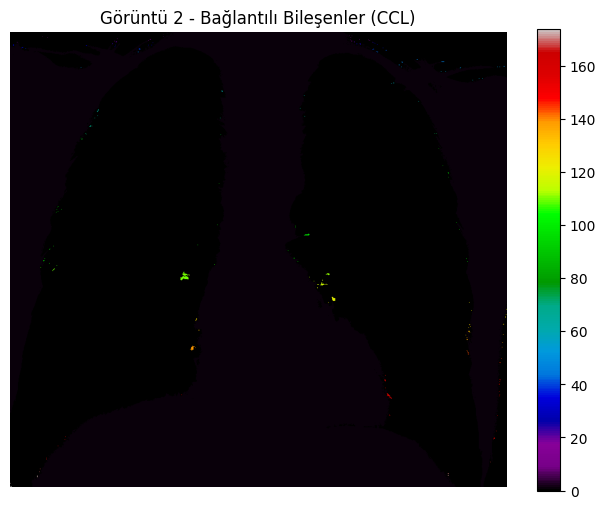

Görüntü 2 için bağlantılı bileşen sayısı: 175

Görüntü 2 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 324104
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [434.44760015 430.29635549]
  - Bölge 2:
    - Alan: 3
    - Bounding Box: (x=272, y=3, w=3, h=2)
    - Merkez Koordinatları: [273.           3.33333333]
  - Bölge 3:
    - Alan: 1
    - Bounding Box: (x=266, y=6, w=1, h=1)
    - Merkez Koordinatları: [266.   6.]
  - Bölge 4:
    - Alan: 2
    - Bounding Box: (x=589, y=7, w=2, h=1)
    - Merkez Koordinatları: [589.5   7. ]
  - Bölge 5:
    - Alan: 1
    - Bounding Box: (x=56, y=9, w=1, h=1)
    - Merkez Koordinatları: [56.  9.]
  - Bölge 6:
    - Alan: 1
    - Bounding Box: (x=266, y=9, w=1, h=1)
    - Merkez Koordinatları: [266.   9.]
  - Bölge 7:
    - Alan: 1
    - Bounding Box: (x=594, y=8, w=1, h=1)
    - Merkez Koordinatları: [594.   8.]
  - Bölge 8:
    - Alan: 1
    - Bounding Box: (x=65, y=11, w=1, h=1)
    - Merkez Koordinat

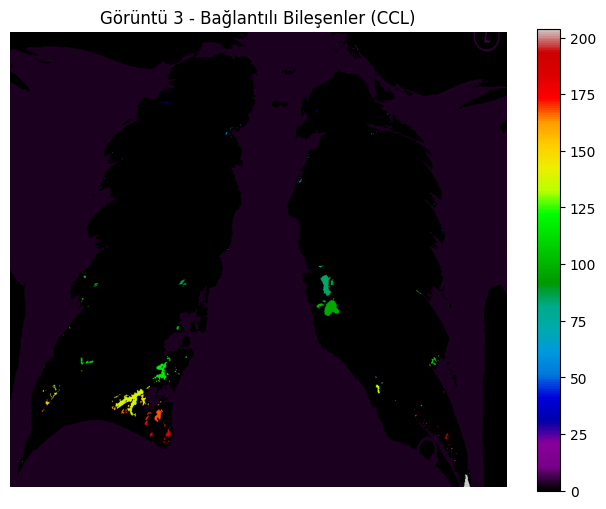

Görüntü 3 için bağlantılı bileşen sayısı: 205

Görüntü 3 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 6
    - Bounding Box: (x=396, y=1, w=5, h=3)
    - Merkez Koordinatları: [397.83333333   2.5       ]
  - Bölge 2:
    - Alan: 10
    - Bounding Box: (x=404, y=0, w=5, h=4)
    - Merkez Koordinatları: [406.4   1.1]
  - Bölge 3:
    - Alan: 355431
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [409.60202121 431.21936185]
  - Bölge 4:
    - Alan: 2
    - Bounding Box: (x=559, y=0, w=1, h=2)
    - Merkez Koordinatları: [5.59e+02 5.00e-01]
  - Bölge 5:
    - Alan: 215
    - Bounding Box: (x=806, y=0, w=45, h=35)
    - Merkez Koordinatları: [828.31627907  20.93023256]
  - Bölge 6:
    - Alan: 77
    - Bounding Box: (x=824, y=0, w=11, h=20)
    - Merkez Koordinatları: [827.85714286  12.44155844]
  - Bölge 7:
    - Alan: 3
    - Bounding Box: (x=401, y=5, w=2, h=2)
    - Merkez Koordinatları: [401.33333333   5.66666667]
  - Bölge 8:
    - Alan: 

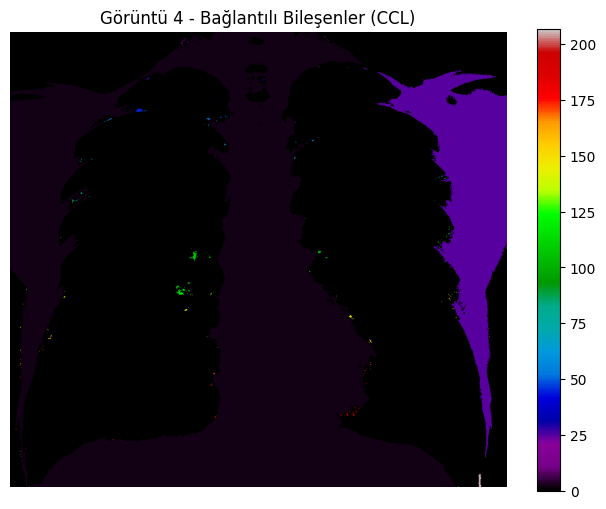

Görüntü 4 için bağlantılı bileşen sayısı: 208

Görüntü 4 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 4
    - Bounding Box: (x=354, y=0, w=4, h=3)
    - Merkez Koordinatları: [355.5    0.75]
  - Bölge 2:
    - Alan: 231655
    - Bounding Box: (x=0, y=0, w=776, h=794)
    - Merkez Koordinatları: [363.0046362  457.48768643]
  - Bölge 3:
    - Alan: 1
    - Bounding Box: (x=513, y=1, w=1, h=1)
    - Merkez Koordinatları: [513.   1.]
  - Bölge 4:
    - Alan: 1
    - Bounding Box: (x=518, y=3, w=1, h=1)
    - Merkez Koordinatları: [518.   3.]
  - Bölge 5:
    - Alan: 2
    - Bounding Box: (x=515, y=4, w=2, h=2)
    - Merkez Koordinatları: [515.5   4.5]
  - Bölge 6:
    - Alan: 1
    - Bounding Box: (x=328, y=7, w=1, h=1)
    - Merkez Koordinatları: [328.   7.]
  - Bölge 7:
    - Alan: 1
    - Bounding Box: (x=538, y=7, w=1, h=1)
    - Merkez Koordinatları: [538.   7.]
  - Bölge 8:
    - Alan: 2
    - Bounding Box: (x=330, y=9, w=2, h=1)
    - Merkez Koordinatları: [33

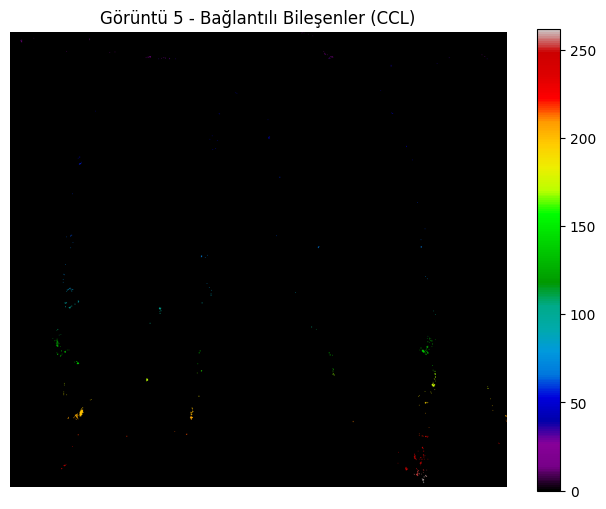

Görüntü 5 için bağlantılı bileşen sayısı: 263

Görüntü 5 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 360722
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [441.9437212  426.30080228]
  - Bölge 2:
    - Alan: 2
    - Bounding Box: (x=510, y=0, w=1, h=2)
    - Merkez Koordinatları: [5.1e+02 5.0e-01]
  - Bölge 3:
    - Alan: 1
    - Bounding Box: (x=515, y=0, w=1, h=1)
    - Merkez Koordinatları: [515.   0.]
  - Bölge 4:
    - Alan: 1
    - Bounding Box: (x=518, y=0, w=1, h=1)
    - Merkez Koordinatları: [518.   0.]
  - Bölge 5:
    - Alan: 2
    - Bounding Box: (x=520, y=0, w=2, h=1)
    - Merkez Koordinatları: [520.5   0. ]
  - Bölge 6:
    - Alan: 4
    - Bounding Box: (x=506, y=2, w=4, h=2)
    - Merkez Koordinatları: [507.5    2.75]
  - Bölge 7:
    - Alan: 1
    - Bounding Box: (x=511, y=3, w=1, h=1)
    - Merkez Koordinatları: [511.   3.]
  - Bölge 8:
    - Alan: 1
    - Bounding Box: (x=518, y=5, w=1, h=1)
    - Merkez Koordinatlar

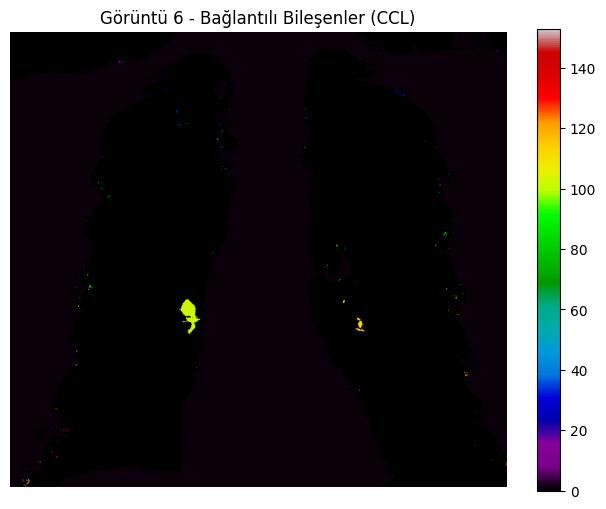

Görüntü 6 için bağlantılı bileşen sayısı: 154

Görüntü 6 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 339667
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [419.62921332 392.84766551]
  - Bölge 2:
    - Alan: 3
    - Bounding Box: (x=787, y=2, w=2, h=2)
    - Merkez Koordinatları: [787.33333333   2.33333333]
  - Bölge 3:
    - Alan: 2
    - Bounding Box: (x=626, y=26, w=2, h=1)
    - Merkez Koordinatları: [626.5  26. ]
  - Bölge 4:
    - Alan: 4
    - Bounding Box: (x=635, y=28, w=3, h=3)
    - Merkez Koordinatları: [636.    28.75]
  - Bölge 5:
    - Alan: 1
    - Bounding Box: (x=639, y=30, w=1, h=1)
    - Merkez Koordinatları: [639.  30.]
  - Bölge 6:
    - Alan: 1
    - Bounding Box: (x=633, y=32, w=1, h=1)
    - Merkez Koordinatları: [633.  32.]
  - Bölge 7:
    - Alan: 1
    - Bounding Box: (x=638, y=32, w=1, h=1)
    - Merkez Koordinatları: [638.  32.]
  - Bölge 8:
    - Alan: 5
    - Bounding Box: (x=846, y=34, w=3, h=2)
    - Mer

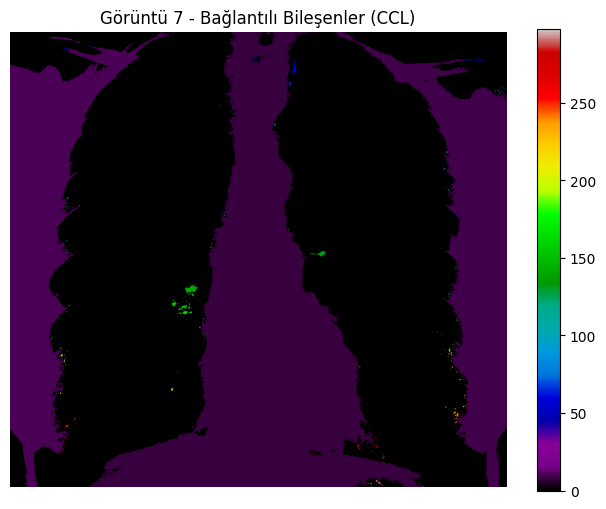

Görüntü 7 için bağlantılı bileşen sayısı: 299

Görüntü 7 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 16
    - Bounding Box: (x=287, y=0, w=9, h=4)
    - Merkez Koordinatları: [291.5625   1.8125]
  - Bölge 2:
    - Alan: 1
    - Bounding Box: (x=297, y=0, w=1, h=1)
    - Merkez Koordinatları: [297.   0.]
  - Bölge 3:
    - Alan: 2
    - Bounding Box: (x=367, y=0, w=2, h=1)
    - Merkez Koordinatları: [367.5   0. ]
  - Bölge 4:
    - Alan: 1
    - Bounding Box: (x=370, y=0, w=1, h=1)
    - Merkez Koordinatları: [370.   0.]
  - Bölge 5:
    - Alan: 1
    - Bounding Box: (x=372, y=0, w=1, h=1)
    - Merkez Koordinatları: [372.   0.]
  - Bölge 6:
    - Alan: 4
    - Bounding Box: (x=374, y=0, w=2, h=3)
    - Merkez Koordinatları: [374.25   1.  ]
  - Bölge 7:
    - Alan: 152175
    - Bounding Box: (x=139, y=0, w=578, h=794)
    - Merkez Koordinatları: [439.89546246 520.22361097]
  - Bölge 8:
    - Alan: 1
    - Bounding Box: (x=563, y=0, w=1, h=1)
    - Merkez Koordin

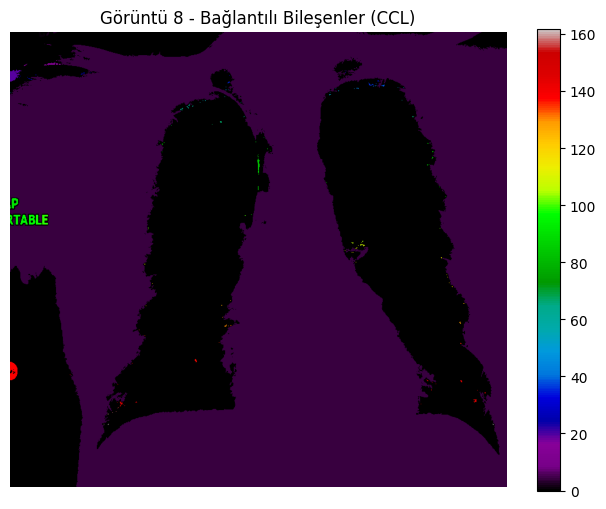

Görüntü 8 için bağlantılı bileşen sayısı: 163

Görüntü 8 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 64
    - Bounding Box: (x=50, y=0, w=11, h=11)
    - Merkez Koordinatları: [54.46875  6.     ]
  - Bölge 2:
    - Alan: 23
    - Bounding Box: (x=63, y=0, w=5, h=8)
    - Merkez Koordinatları: [65.39130435  3.95652174]
  - Bölge 3:
    - Alan: 31
    - Bounding Box: (x=74, y=0, w=12, h=4)
    - Merkez Koordinatları: [78.58064516  1.06451613]
  - Bölge 4:
    - Alan: 437793
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [448.58929448 402.56346949]
  - Bölge 5:
    - Alan: 1
    - Bounding Box: (x=60, y=22, w=1, h=1)
    - Merkez Koordinatları: [60. 22.]
  - Bölge 6:
    - Alan: 9
    - Bounding Box: (x=64, y=23, w=8, h=2)
    - Merkez Koordinatları: [67.66666667 23.33333333]
  - Bölge 7:
    - Alan: 2
    - Bounding Box: (x=816, y=28, w=1, h=2)
    - Merkez Koordinatları: [816.   28.5]
  - Bölge 8:
    - Alan: 1
    - Bounding Box: (x=844

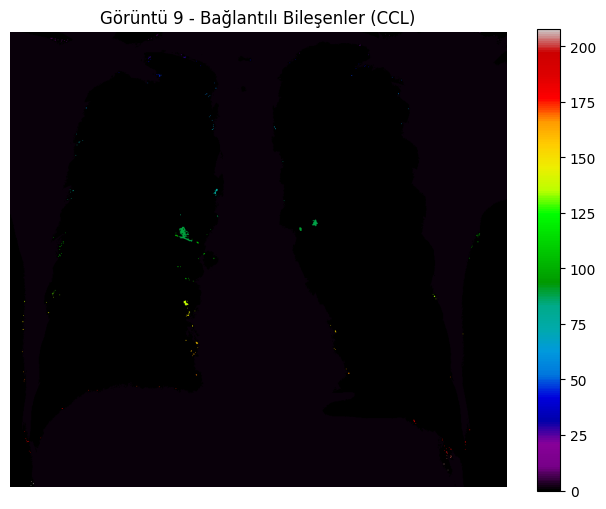

Görüntü 9 için bağlantılı bileşen sayısı: 209

Görüntü 9 için bağlantılı bileşen analizi sonuçları:
  - Bölge 1:
    - Alan: 344652
    - Bounding Box: (x=0, y=0, w=864, h=794)
    - Merkez Koordinatları: [422.87043162 408.07883024]
  - Bölge 2:
    - Alan: 1
    - Bounding Box: (x=72, y=0, w=1, h=1)
    - Merkez Koordinatları: [72.  0.]
  - Bölge 3:
    - Alan: 3
    - Bounding Box: (x=74, y=0, w=3, h=1)
    - Merkez Koordinatları: [75.  0.]
  - Bölge 4:
    - Alan: 1
    - Bounding Box: (x=679, y=1, w=1, h=1)
    - Merkez Koordinatları: [679.   1.]
  - Bölge 5:
    - Alan: 4
    - Bounding Box: (x=815, y=1, w=4, h=2)
    - Merkez Koordinatları: [816.5    1.75]
  - Bölge 6:
    - Alan: 7
    - Bounding Box: (x=254, y=5, w=4, h=4)
    - Merkez Koordinatları: [255.28571429   6.57142857]
  - Bölge 7:
    - Alan: 1
    - Bounding Box: (x=652, y=5, w=1, h=1)
    - Merkez Koordinatları: [652.   5.]
  - Bölge 8:
    - Alan: 1
    - Bounding Box: (x=659, y=7, w=1, h=1)
    - Merkez Koordinatl

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

for i, binary_image in enumerate(binary_images):
    # OpenCV'nin connectedComponents fonksiyonunu kullanarak CCL uygulama
    num_labels, labels_im = cv2.connectedComponents(binary_image.astype(np.uint8))

    # CCL Çıktısını Görselleştirme (Her bölge farklı renk alır)
    plt.figure(figsize=(8, 6))
    plt.imshow(labels_im, cmap='nipy_spectral')
    plt.title(f"Görüntü {i+1} - Bağlantılı Bileşenler (CCL)")
    plt.axis("off")
    plt.colorbar()
    plt.show()

    print(f"Görüntü {i+1} için bağlantılı bileşen sayısı: {num_labels}")

    # Detaylı Bölge Bilgileri (Connected Components with Stats)
    num_labels, labels_im, stats, centroids = cv2.connectedComponentsWithStats(binary_image.astype(np.uint8))

    print(f"\nGörüntü {i+1} için bağlantılı bileşen analizi sonuçları:")
    for label in range(1, num_labels):  # 0 etiketi arka plan olduğu için atlanır
        print(f"  - Bölge {label}:")
        print(f"    - Alan: {stats[label, cv2.CC_STAT_AREA]}")
        print(f"    - Bounding Box: (x={stats[label, cv2.CC_STAT_LEFT]}, y={stats[label, cv2.CC_STAT_TOP]},"
              f" w={stats[label, cv2.CC_STAT_WIDTH]}, h={stats[label, cv2.CC_STAT_HEIGHT]})")
        print(f"    - Merkez Koordinatları: {centroids[label]}")
    print("\n" + "=" * 50 + "\n")


### 5.3.	Elde ettiğiniz labellar için, Centroid ve Area bilgilerinin kesinlikle olacağı, ayrıca bölgelerin yoğunluk ve şekilsel özelliklerini belirten özniteliği yazdırıyoruz.
 (cv2.connectedComponentsWithStats önerebilirim ama scikit-image’ın regionprops daha iyi)


/usr/local/lib/python3.11/dist-packages/skimage/exposure/exposure.py:306: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
  hist, bin_edges = np.histogram(image, bins=bins, range=hist_range)



Görüntü 1 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (428.54893831916195, 428.9002530887396)
    - Alan (Area): 340592.0
    - Çevre (Perimeter): 9455.681271659101
    - Eksantriklik (Eccentricity): 0.35
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (18.5, 838.2121951219513)
    - Alan (Area): 410.0
    - Çevre (Perimeter): 108.38477631085024
    - Eksantriklik (Eccentricity): 0.83
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (43.18705035971223, 819.7194244604317)
    - Alan (Area): 139.0
    - Çevre (Perimeter): 44.14213562373095
    - Eksantriklik (Eccentricity): 0.77
    - Ortalama Yoğunluk (Mean Intensity): 0.91
------------------------------------------------------------
  - Bölge ID: 4
    - Merkez (Centroid): (44.87591240875913, 836.21167883211

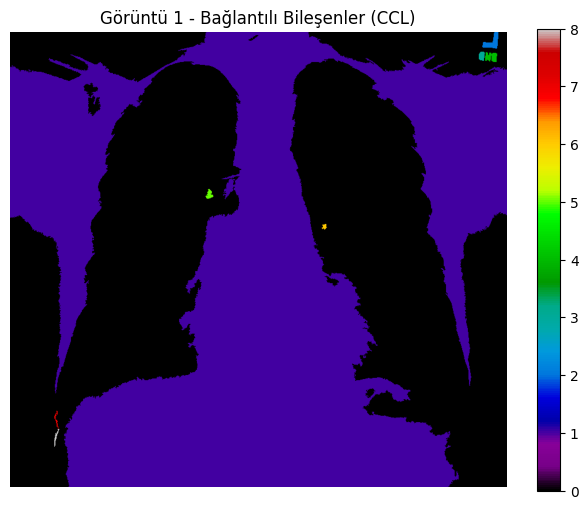


Görüntü 2 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (430.2808921259624, 434.6895397953619)
    - Alan (Area): 324573.0
    - Çevre (Perimeter): 8989.231344722046
    - Eksantriklik (Eccentricity): 0.33
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (427.44329896907215, 302.9381443298969)
    - Alan (Area): 97.0
    - Çevre (Perimeter): 64.49137802864846
    - Eksantriklik (Eccentricity): 0.48
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------


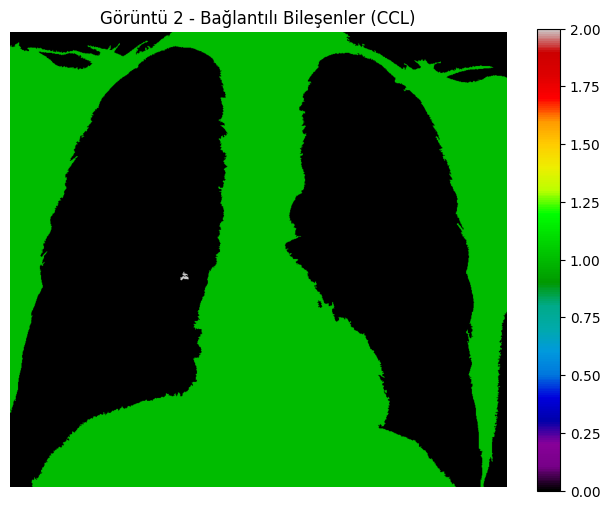


Görüntü 3 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (431.374296960506, 409.51383851826427)
    - Alan (Area): 355421.0
    - Çevre (Perimeter): 11176.343356011228
    - Eksantriklik (Eccentricity): 0.39
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (20.930232558139537, 828.3162790697675)
    - Alan (Area): 215.0
    - Çevre (Perimeter): 151.39087296526012
    - Eksantriklik (Eccentricity): 0.76
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (12.441558441558442, 827.8571428571429)
    - Alan (Area): 77.0
    - Çevre (Perimeter): 51.72792206135786
    - Eksantriklik (Eccentricity): 0.93
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 4
    - Merkez (Centroid): (169.42611683848799, 

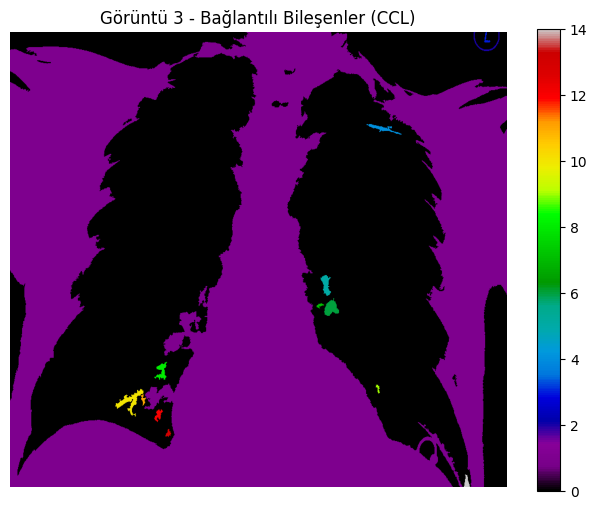


Görüntü 4 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (499.9330112528459, 442.5781980195863)
    - Alan (Area): 183598.0
    - Çevre (Perimeter): 5093.658438676267
    - Eksantriklik (Eccentricity): 0.87
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (283.2772714441263, 796.4727588014679)
    - Alan (Area): 49594.0
    - Çevre (Perimeter): 2461.967783624396
    - Eksantriklik (Eccentricity): 0.96
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (295.44253909081493, 61.84926995961479)
    - Alan (Area): 48285.0
    - Çevre (Perimeter): 2612.0094141847385
    - Eksantriklik (Eccentricity): 0.97
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 4
    - Merkez (Centroid): (282.5853658536585

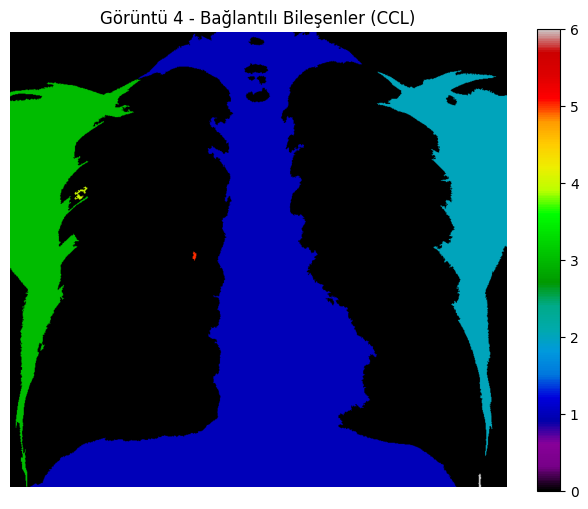


Görüntü 5 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (426.1758571938435, 441.8377245525549)
    - Alan (Area): 361441.0
    - Çevre (Perimeter): 9751.30555059549
    - Eksantriklik (Eccentricity): 0.46
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (664.3584905660377, 123.33962264150944)
    - Alan (Area): 53.0
    - Çevre (Perimeter): 32.14213562373095
    - Eksantriklik (Eccentricity): 0.89
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------


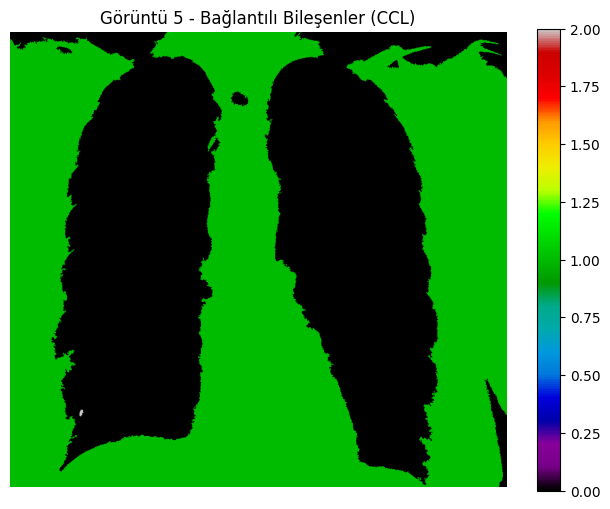


Görüntü 6 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (392.83977900552486, 419.6455208630428)
    - Alan (Area): 340099.0
    - Çevre (Perimeter): 9846.595918497364
    - Eksantriklik (Eccentricity): 0.47
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (491.65972222222223, 311.97569444444446)
    - Alan (Area): 864.0
    - Çevre (Perimeter): 191.0304832720494
    - Eksantriklik (Eccentricity): 0.91
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (508.1279069767442, 607.7558139534884)
    - Alan (Area): 86.0
    - Çevre (Perimeter): 47.42031021678297
    - Eksantriklik (Eccentricity): 0.92
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------


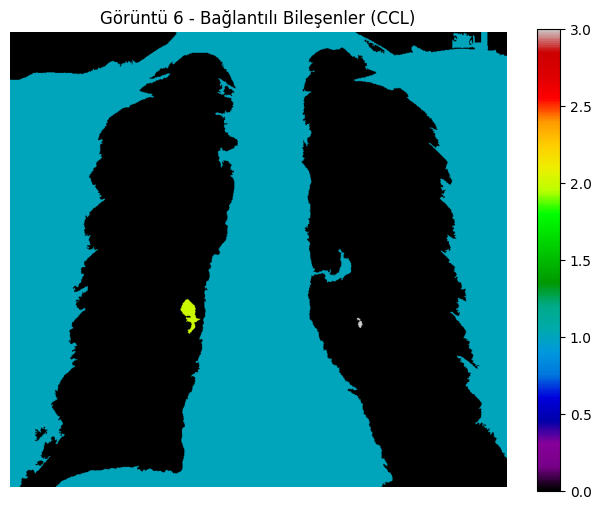


Görüntü 7 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (519.8168929149651, 439.84805422093456)
    - Alan (Area): 152561.0
    - Çevre (Perimeter): 4176.513164990956
    - Eksantriklik (Eccentricity): 0.91
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (369.8606598428647, 805.9567408520362)
    - Alan (Area): 63894.0
    - Çevre (Perimeter): 2902.483548270684
    - Eksantriklik (Eccentricity): 0.98
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (350.4114020898002, 57.5757006077034)
    - Alan (Area): 68619.0
    - Çevre (Perimeter): 3087.839933350538
    - Eksantriklik (Eccentricity): 0.98
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 4
    - Merkez (Centroid): (12.341772151898734,

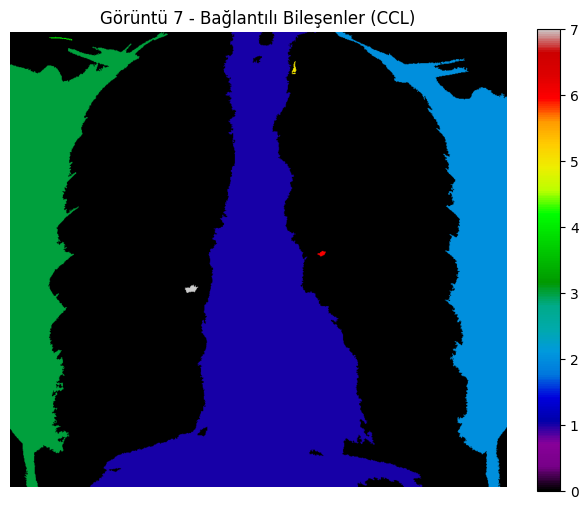


Görüntü 8 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (6.0, 54.46875)
    - Alan (Area): 64.0
    - Çevre (Perimeter): 40.3492424049175
    - Eksantriklik (Eccentricity): 0.70
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (402.39040723692625, 448.37234460335725)
    - Alan (Area): 437976.0
    - Çevre (Perimeter): 9816.518754031087
    - Eksantriklik (Eccentricity): 0.40
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (76.30084745762711, 6.601694915254237)
    - Alan (Area): 236.0
    - Çevre (Perimeter): 85.5269119345812
    - Eksantriklik (Eccentricity): 0.76
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 4
    - Merkez (Centroid): (233.26666666666668, 431.56666666666666)
    - A

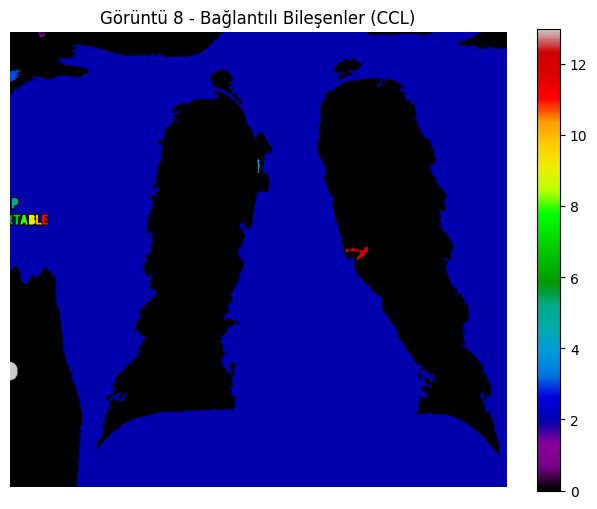


Görüntü 9 için bağlantılı bileşen analizi:
  - Bölge ID: 1
    - Merkez (Centroid): (408.0152469513344, 422.9383426042141)
    - Alan (Area): 344987.0
    - Çevre (Perimeter): 9771.542094628201
    - Eksantriklik (Eccentricity): 0.44
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 2
    - Merkez (Centroid): (333.875, 529.71875)
    - Alan (Area): 64.0
    - Çevre (Perimeter): 36.798989873223334
    - Eksantriklik (Eccentricity): 0.65
    - Ortalama Yoğunluk (Mean Intensity): 1.00
------------------------------------------------------------
  - Bölge ID: 3
    - Merkez (Centroid): (352.78280542986425, 302.0995475113122)
    - Alan (Area): 221.0
    - Çevre (Perimeter): 107.46194077712559
    - Eksantriklik (Eccentricity): 0.87
    - Ortalama Yoğunluk (Mean Intensity): 0.96
------------------------------------------------------------


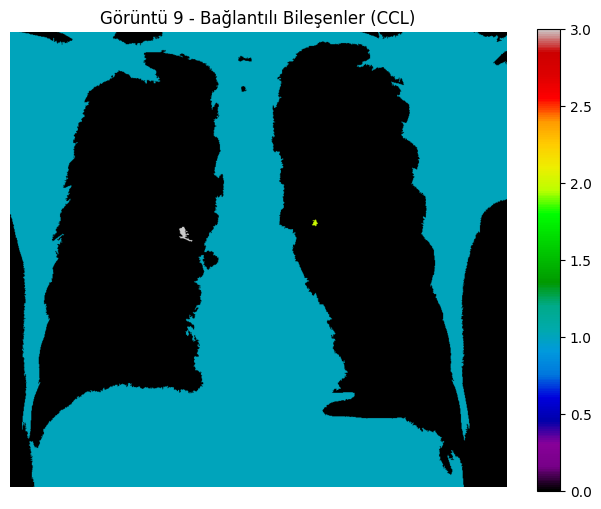

In [ ]:
from skimage.measure import regionprops, label
from skimage import morphology, filters
import numpy as np
import matplotlib.pyplot as plt

for i, binary_image in enumerate(binary_images):
    # Otsu Thresholding
    threshold = filters.threshold_otsu(binary_image)
    mask = binary_image > threshold

    # Morfolojik İşlemler
    mask = morphology.remove_small_objects(mask, 50)
    mask = morphology.remove_small_holes(mask, 50)

    # Bağlantılı Bileşenler Etiketleme
    labels = label(mask)

    # Regionprops ile Öznitelik Çıkartıyoruz
    regions = regionprops(labels, intensity_image=binary_image)

    print(f"\nGörüntü {i+1} için bağlantılı bileşen analizi:")
    print("=" * 60)

    for region in regions:
        centroid = region.centroid
        area = region.area
        perimeter = region.perimeter
        eccentricity = region.eccentricity
        mean_intensity = region.mean_intensity

        print(f"  - Bölge ID: {region.label}")
        print(f"    - Merkez (Centroid): {centroid}")
        print(f"    - Alan (Area): {area}")
        print(f"    - Çevre (Perimeter): {perimeter}")
        print(f"    - Eksantriklik (Eccentricity): {eccentricity:.2f}")
        print(f"    - Ortalama Yoğunluk (Mean Intensity): {mean_intensity:.2f}")
        print("-" * 60)

    # CCL Çıktısını Görselleştiriyoruz
    plt.figure(figsize=(8, 6))
    plt.imshow(labels, cmap='nipy_spectral')
    plt.title(f"Görüntü {i+1} - Bağlantılı Bileşenler (CCL)")
    plt.axis("off")
    plt.colorbar()
    plt.show()


### 5.4.	Elde ettiğiniz stats ve labelsları inceleyerek akciğer alanlarını en iyi ifade eden öznitelikleri yorumluyoruz.



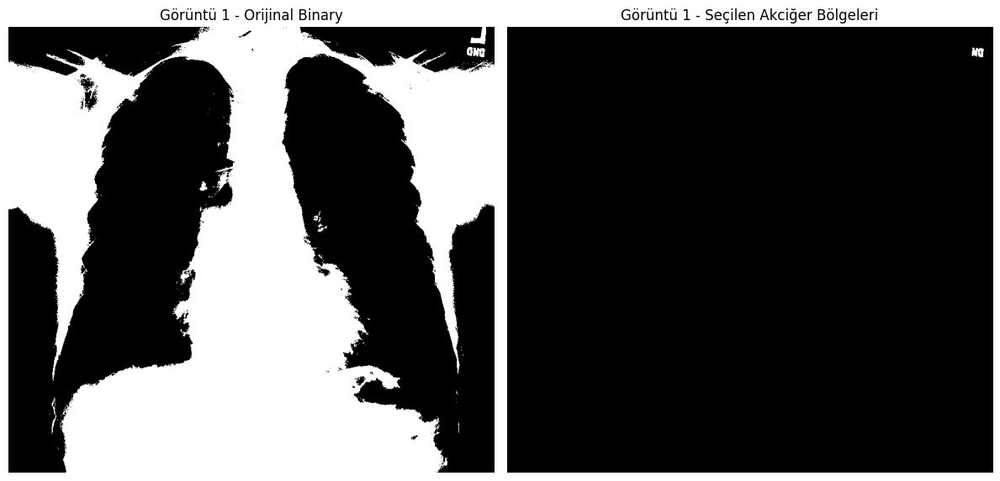


Görüntü 1 için seçilen akciğer bölgeleri:
  - Bölge ID: 16
    - Merkez (Centroid): (44.87169811320755, 836.0490566037736)
    - Alan (Area): 265.0
    - Eksantriklik (Eccentricity): 0.70
------------------------------------------------------------


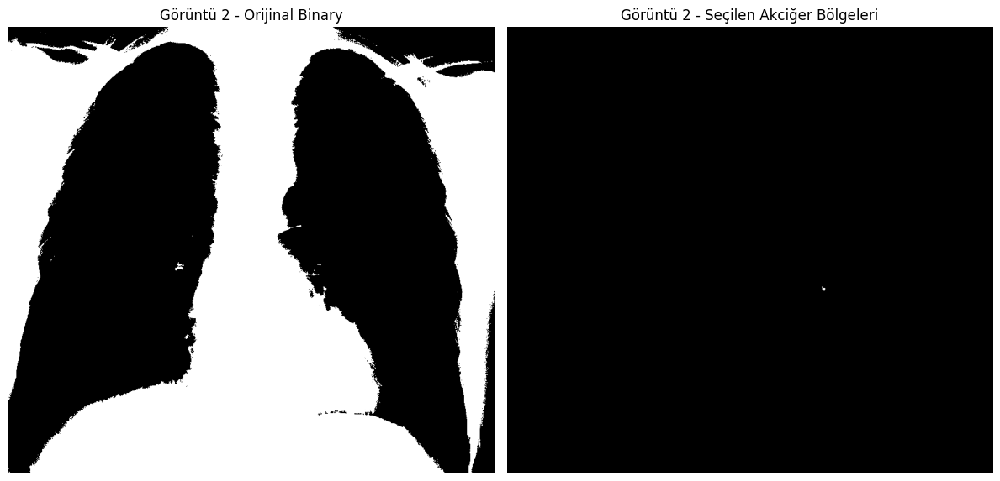


Görüntü 2 için seçilen akciğer bölgeleri:
  - Bölge ID: 120
    - Merkez (Centroid): (466.3, 562.0333333333333)
    - Alan (Area): 30.0
    - Eksantriklik (Eccentricity): 0.79
------------------------------------------------------------
  - Bölge ID: 120
    - Merkez (Centroid): (466.3, 562.0333333333333)
    - Alan (Area): 30.0
    - Eksantriklik (Eccentricity): 0.79
------------------------------------------------------------


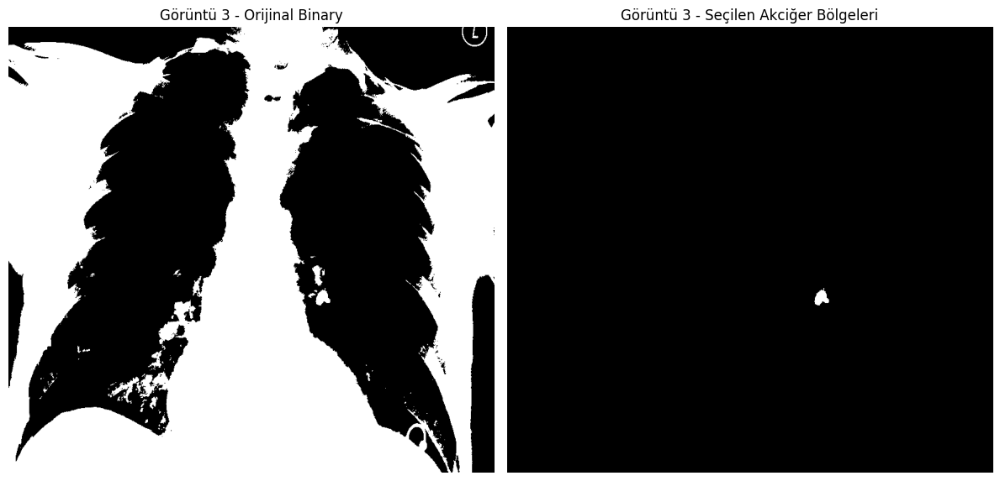


Görüntü 3 için seçilen akciğer bölgeleri:
  - Bölge ID: 97
    - Merkez (Centroid): (482.19532908704883, 557.9087048832272)
    - Alan (Area): 471.0
    - Eksantriklik (Eccentricity): 0.52
------------------------------------------------------------


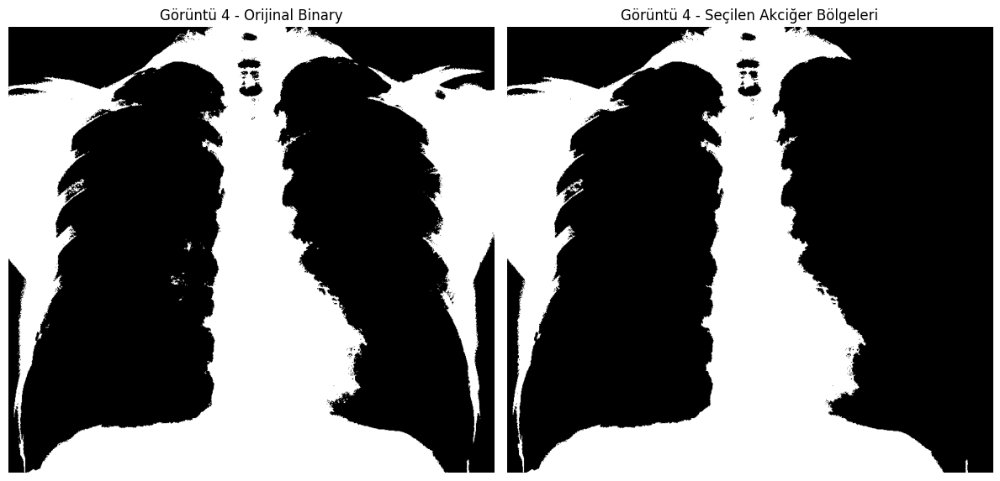


Görüntü 4 için seçilen akciğer bölgeleri:
  - Bölge ID: 2
    - Merkez (Centroid): (457.48768643025187, 363.00463620470094)
    - Alan (Area): 231655.0
    - Eksantriklik (Eccentricity): 0.73
------------------------------------------------------------
  - Bölge ID: 205
    - Merkez (Centroid): (782.3717948717949, 816.2051282051282)
    - Alan (Area): 78.0
    - Eksantriklik (Eccentricity): 0.99
------------------------------------------------------------


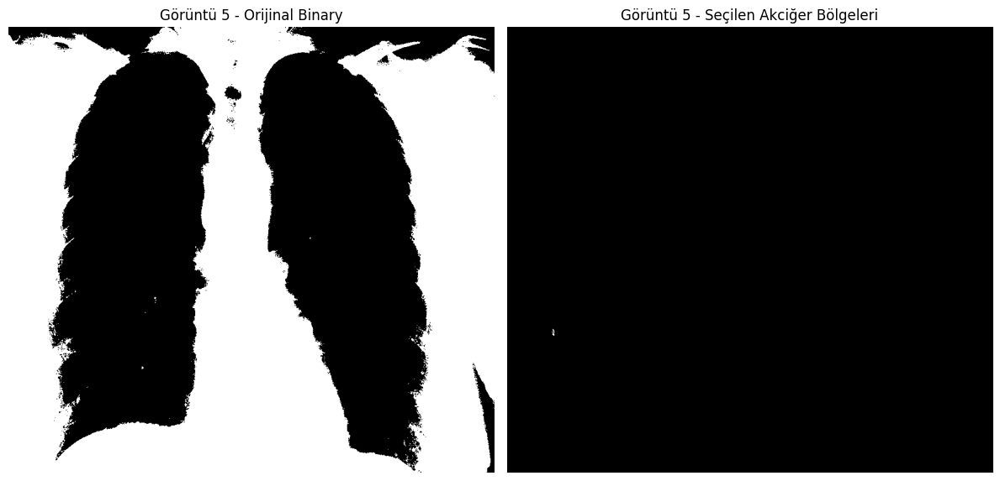


Görüntü 5 için seçilen akciğer bölgeleri:
  - Bölge ID: 122
    - Merkez (Centroid): (544.0714285714286, 81.75)
    - Alan (Area): 28.0
    - Eksantriklik (Eccentricity): 0.95
------------------------------------------------------------
  - Bölge ID: 122
    - Merkez (Centroid): (544.0714285714286, 81.75)
    - Alan (Area): 28.0
    - Eksantriklik (Eccentricity): 0.95
------------------------------------------------------------


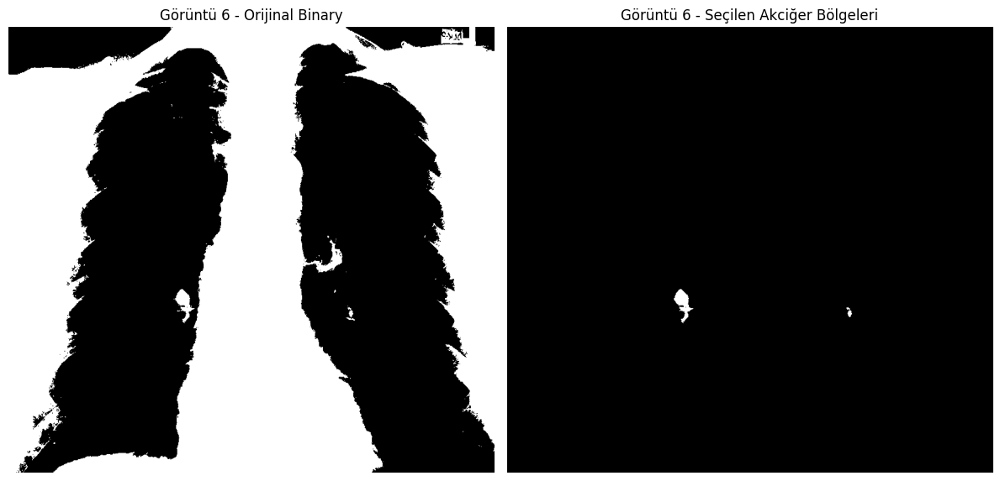


Görüntü 6 için seçilen akciğer bölgeleri:
  - Bölge ID: 102
    - Merkez (Centroid): (491.6921296296296, 311.97106481481484)
    - Alan (Area): 864.0
    - Eksantriklik (Eccentricity): 0.91
------------------------------------------------------------
  - Bölge ID: 112
    - Merkez (Centroid): (508.1279069767442, 607.7558139534884)
    - Alan (Area): 86.0
    - Eksantriklik (Eccentricity): 0.92
------------------------------------------------------------


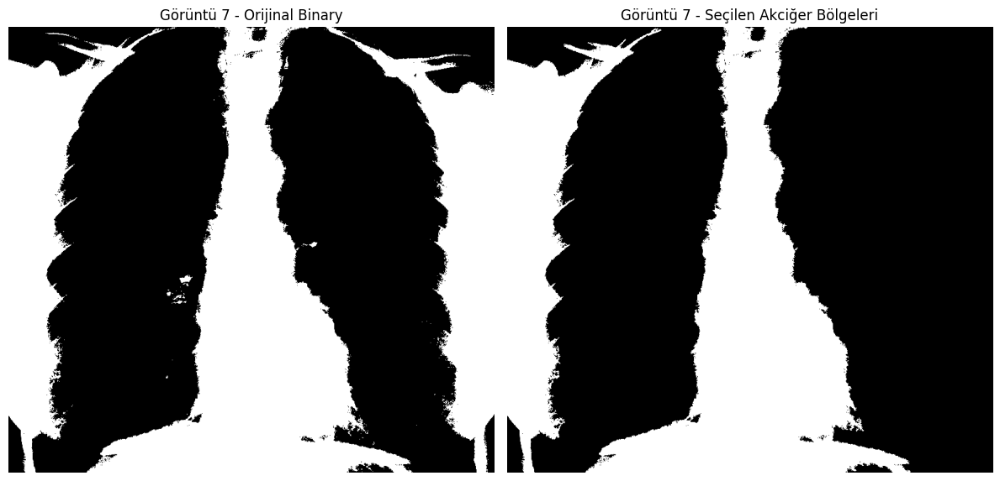


Görüntü 7 için seçilen akciğer bölgeleri:
  - Bölge ID: 7
    - Merkez (Centroid): (520.2236109742073, 439.8954624609824)
    - Alan (Area): 152175.0
    - Eksantriklik (Eccentricity): 0.91
------------------------------------------------------------
  - Bölge ID: 10
    - Merkez (Centroid): (350.1828769325189, 57.45388257299003)
    - Alan (Area): 68434.0
    - Eksantriklik (Eccentricity): 0.98
------------------------------------------------------------


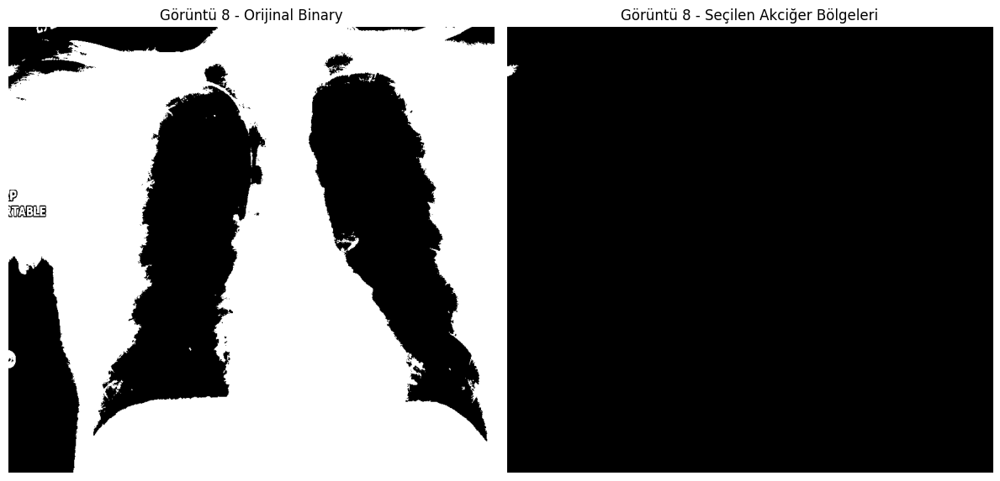


Görüntü 8 için seçilen akciğer bölgeleri:
  - Bölge ID: 19
    - Merkez (Centroid): (76.29113924050633, 6.654008438818566)
    - Alan (Area): 237.0
    - Eksantriklik (Eccentricity): 0.76
------------------------------------------------------------


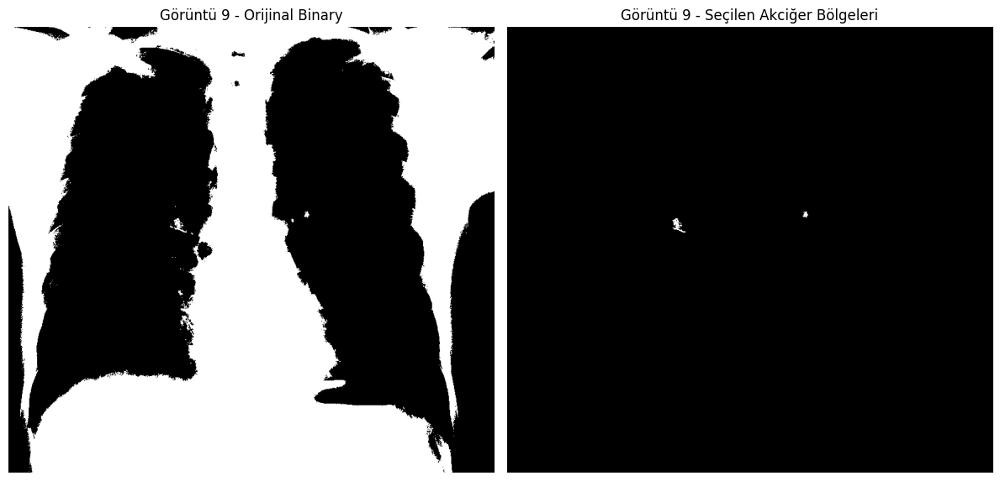


Görüntü 9 için seçilen akciğer bölgeleri:
  - Bölge ID: 89
    - Merkez (Centroid): (352.9065420560748, 302.2710280373832)
    - Alan (Area): 214.0
    - Eksantriklik (Eccentricity): 0.87
------------------------------------------------------------
  - Bölge ID: 88
    - Merkez (Centroid): (333.875, 529.71875)
    - Alan (Area): 64.0
    - Eksantriklik (Eccentricity): 0.65
------------------------------------------------------------


In [ ]:
from skimage.measure import regionprops, label
from skimage import morphology, filters
import numpy as np
import cv2
import matplotlib.pyplot as plt

def detect_lungs(binary_image):
    """ Akciğer alanlarını en iyi ifade eden iki bölgeyi belirle """

    # Bağlantılı Bileşenleri Etiketleme
    labels = label(binary_image)
    regions = regionprops(labels, intensity_image=binary_image)

    # Özniteliklerin Alınması
    lung_regions = sorted(regions, key=lambda x: x.area, reverse=True)[:3]  # En büyük 3 bölgeyi alıyoruz

    # Görüntü Merkezi
    image_center = (binary_image.shape[1] // 2, binary_image.shape[0] // 2)

    selected_regions = []

    for region in lung_regions:
        centroid_x, centroid_y = region.centroid
        area = region.area
        eccentricity = region.eccentricity

        # Şartlar: Alan büyük olacak ve centroid merkeze yakın olacak
        if (abs(centroid_x - image_center[0]) < image_center[0] * 0.3) and (eccentricity > 0.6):
            selected_regions.append(region)

        if len(selected_regions) == 2:
            break  # En iyi 2 bölgeyi seçiyoruz

    # Eğer 2 bölge bulunamadıysa, 3. bölgeyi dene
    if len(selected_regions) < 2 and len(lung_regions) > 2:
        selected_regions.append(lung_regions[2])

    # Sonuçları Görselleştiriyoruz
    mask = np.zeros_like(binary_image)
    for region in selected_regions:
        mask[labels == region.label] = 1

    return mask, selected_regions

# Tüm Görüntüler İçin Uyguluyoruz
for i, binary_image in enumerate(binary_images):
    lung_mask, selected_regions = detect_lungs(binary_image)

    # Sonuçları Görselleştiriyoruz
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title(f"Görüntü {i+1} - Orijinal Binary")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(lung_mask, cmap='gray')
    plt.title(f"Görüntü {i+1} - Seçilen Akciğer Bölgeleri")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    # Seçilen Bölgelere Ait Öznitelikler
    print(f"\nGörüntü {i+1} için seçilen akciğer bölgeleri:")
    print("=" * 60)
    for region in selected_regions:
        print(f"  - Bölge ID: {region.label}")
        print(f"    - Merkez (Centroid): {region.centroid}")
        print(f"    - Alan (Area): {region.area}")
        print(f"    - Eksantriklik (Eccentricity): {region.eccentricity:.2f}")
        print("-" * 60)


### 5.5.	Seçtiğiniz labela sahip filtrelenmiş görüntülere uygun morfolojik işlemleri (structural elemant tipi ve boyutu belirleyerek) uyguluyoruz ve giriş ve çıkış görüntülerini görselleştiriyoruz.

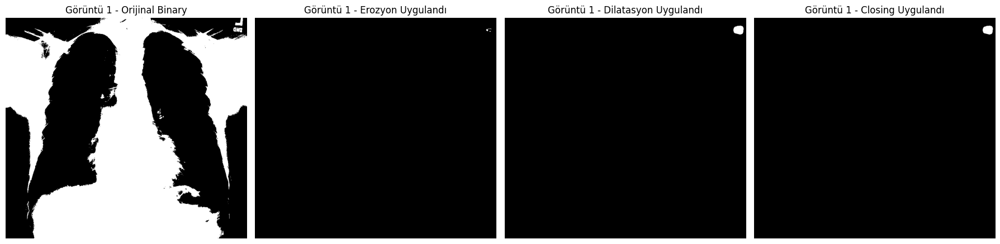

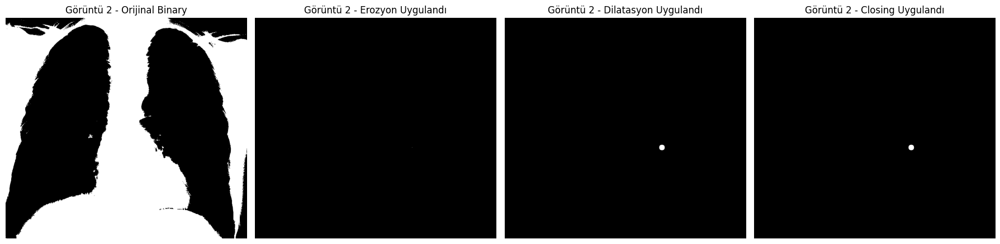

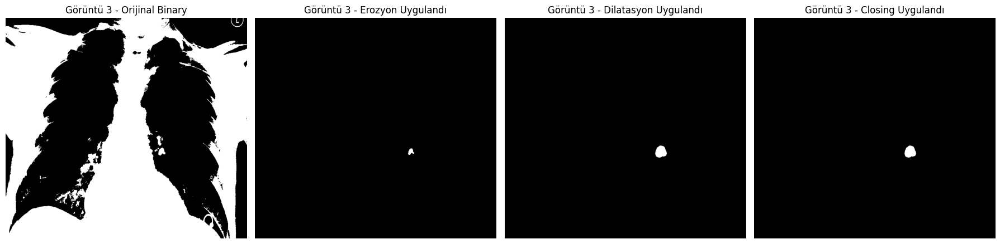

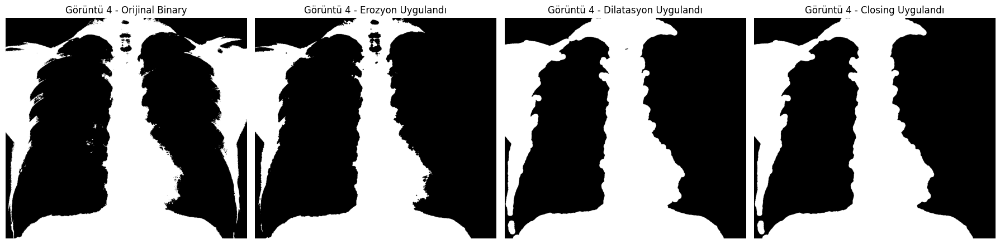

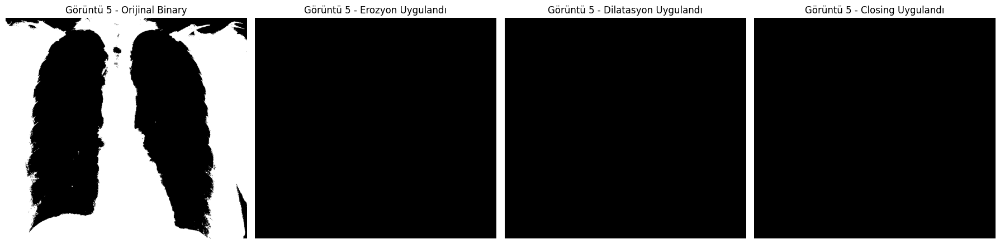

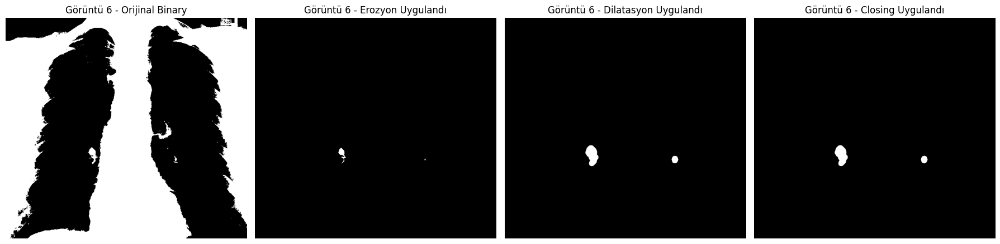

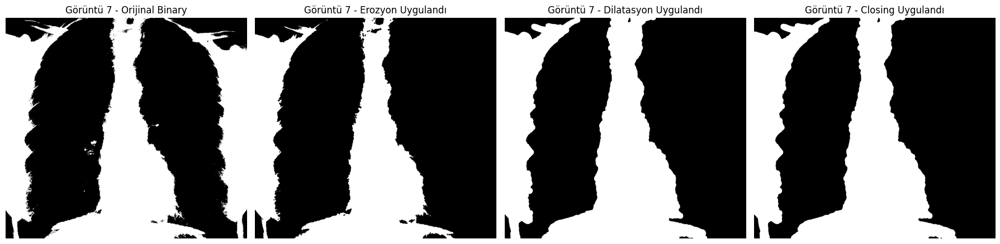

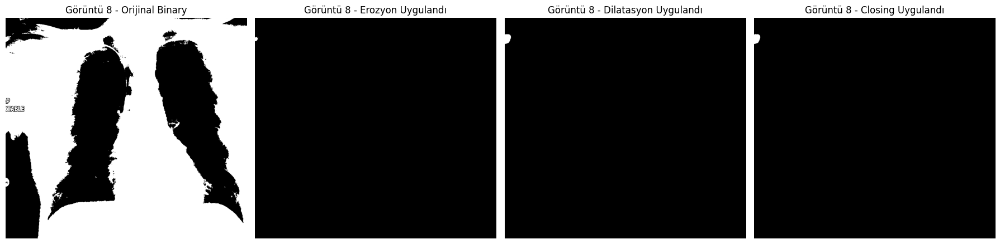

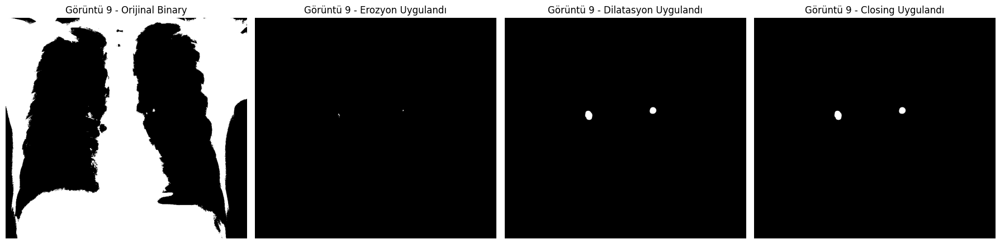

In [ ]:
from skimage.morphology import binary_erosion, binary_dilation, binary_closing, disk
import numpy as np
import matplotlib.pyplot as plt

def apply_morphology_fixed(lung_mask):
    """ Akciğer maskesine uygun morfolojik işlemler uygula. """

    # Maskenin tamamen siyah olup olmadığını kontrol et
    unique_vals = np.unique(lung_mask)
    if len(unique_vals) == 1 and unique_vals[0] == 0:
        print("UYARI: Akciğer maskesi tamamen siyah! İşlemi atlıyoruz.")
        return lung_mask, lung_mask, lung_mask

    # Daha küçük structuring element (Disk, Boyut = 2)
    struct_elem = disk(2)

    # Morfolojik İşlemler
    eroded = binary_erosion(lung_mask, struct_elem)  # Gürültü temizle (çok küçültmesin)
    dilated = binary_dilation(eroded, disk(10))  # Yapıyı biraz daha genişlet
    closed = binary_closing(dilated, struct_elem)  # Küçük boşlukları kapat

    return eroded, dilated, closed

# Tüm Görüntüler İçin Uygula
for i, binary_image in enumerate(binary_images):
    lung_mask, selected_regions = detect_lungs(binary_image)

    # Morfolojik işlemleri uygula
    eroded, dilated, closed = apply_morphology_fixed(lung_mask)

    # Sonuçları Görselleştir
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title(f"Görüntü {i+1} - Orijinal Binary")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(eroded, cmap='gray')
    plt.title(f"Görüntü {i+1} - Erozyon Uygulandı")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(dilated, cmap='gray')
    plt.title(f"Görüntü {i+1} - Dilatasyon Uygulandı")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(closed, cmap='gray')
    plt.title(f"Görüntü {i+1} - Closing Uygulandı")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


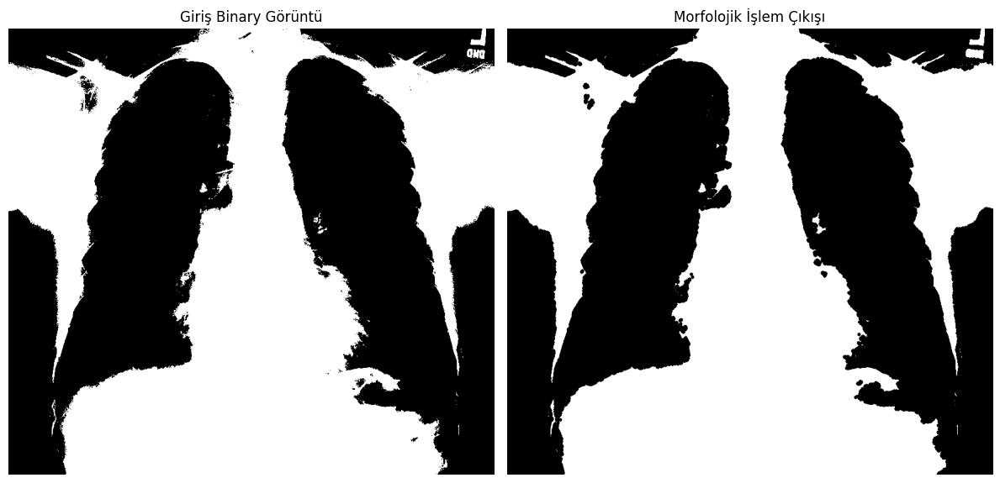

Görüntü 1 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




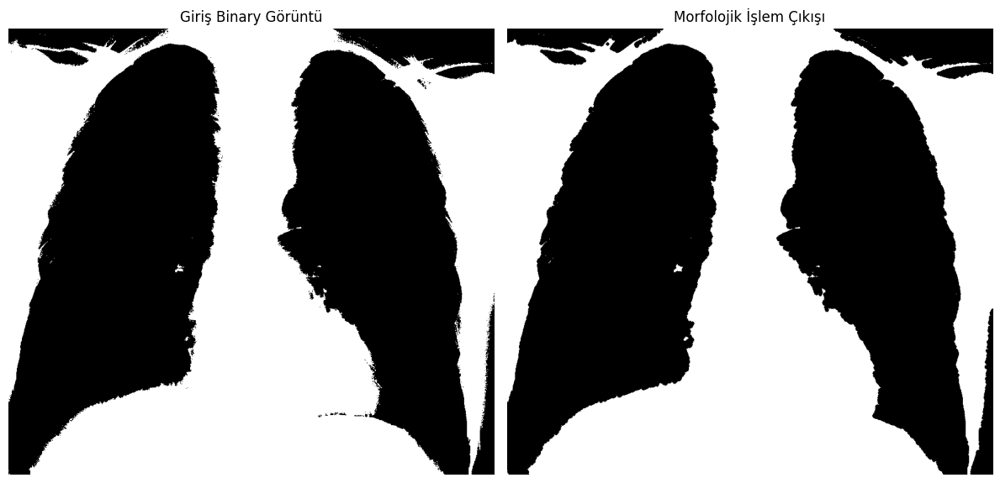

Görüntü 2 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




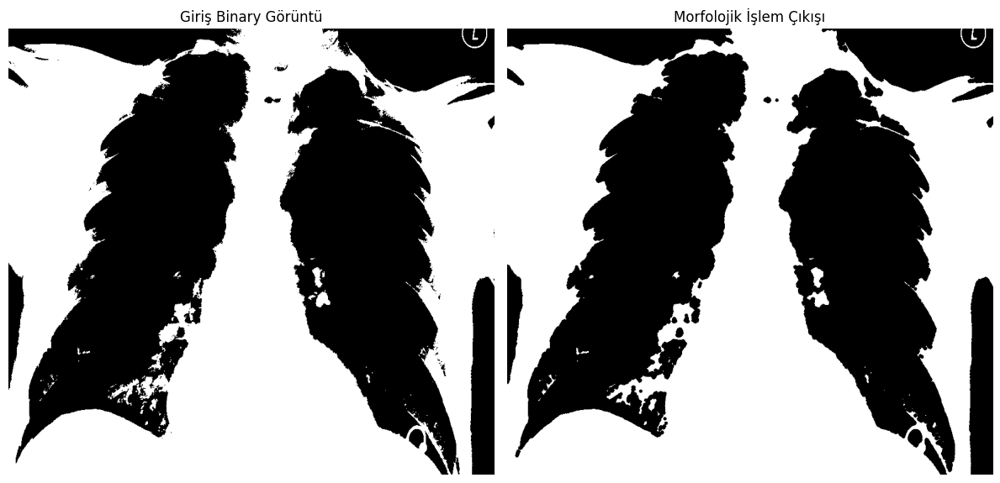

Görüntü 3 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




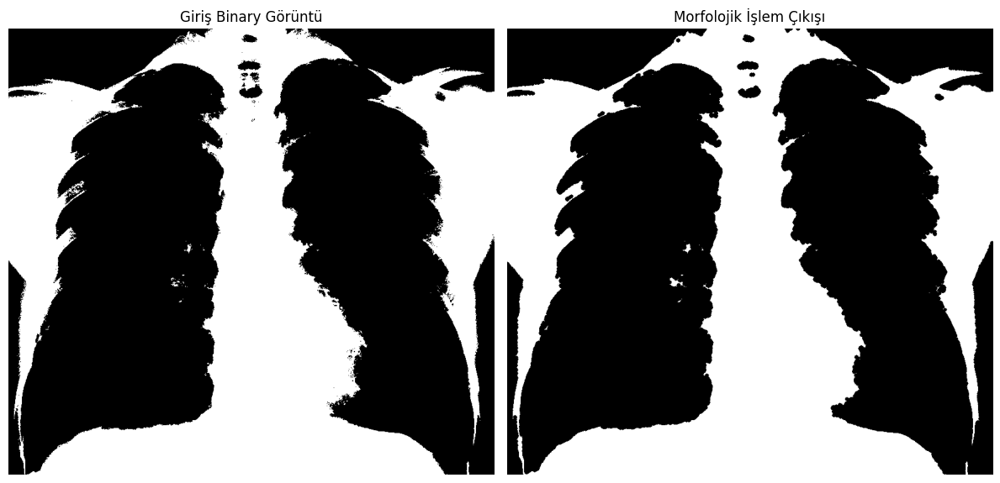

Görüntü 4 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




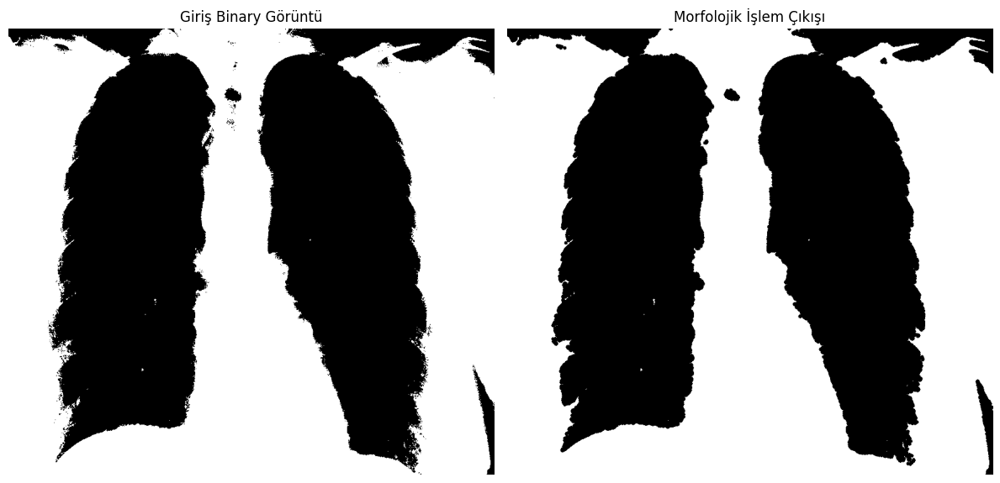

Görüntü 5 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




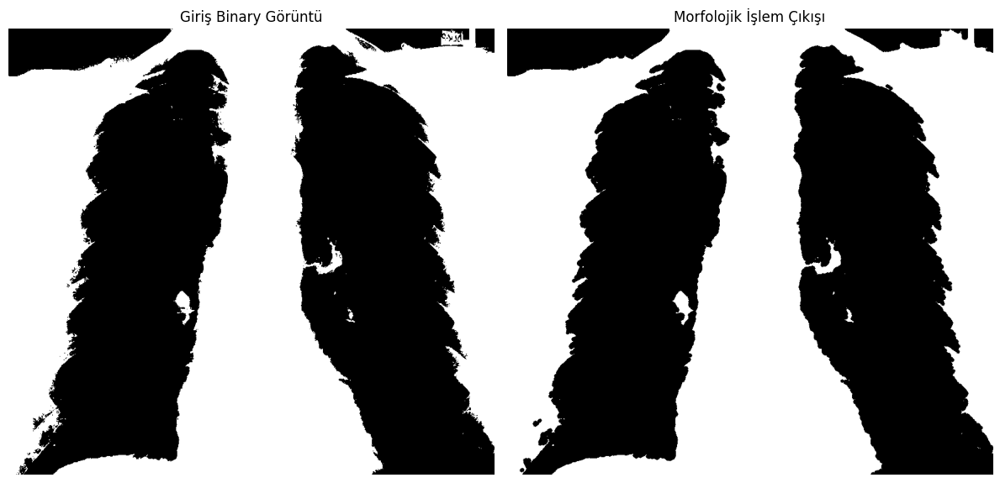

Görüntü 6 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




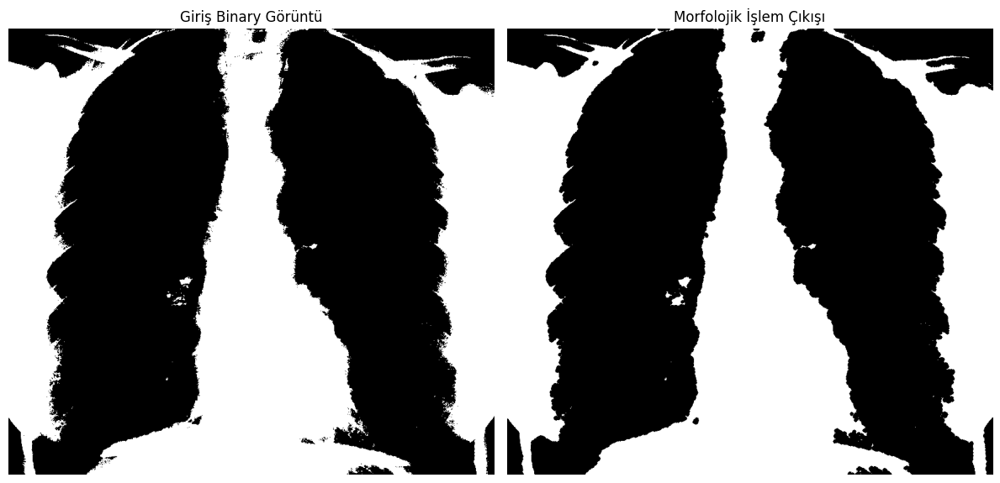

Görüntü 7 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




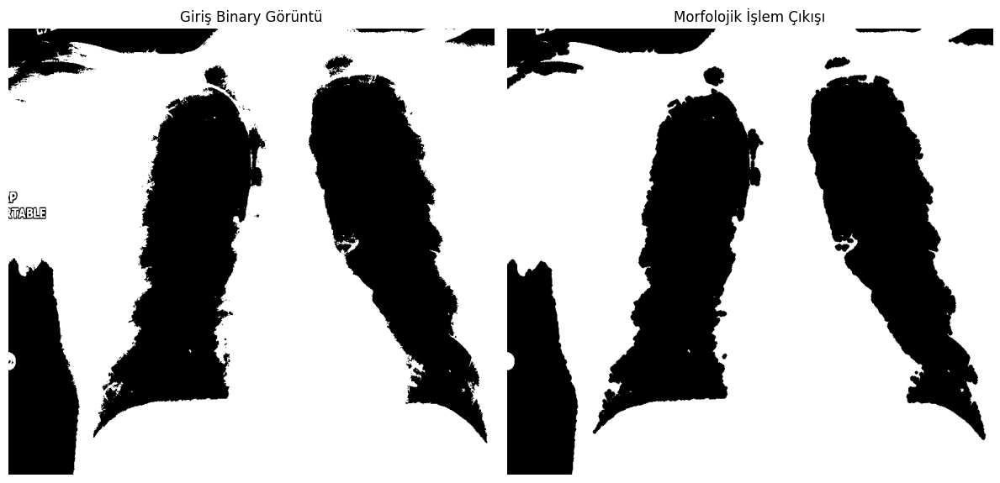

Görüntü 8 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




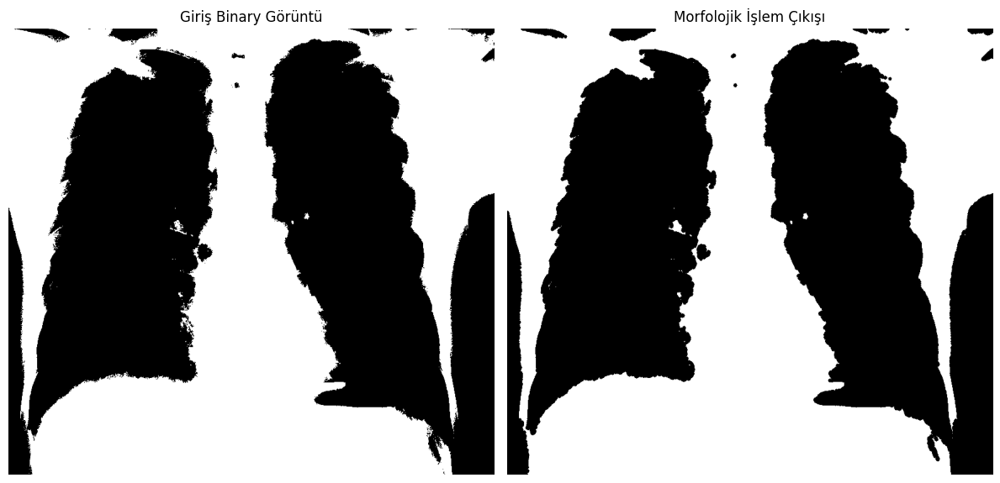

Görüntü 9 için Morfolojik İşlem:
  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).
  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.




In [ ]:
    # Post-Processing (Morfolojik Operasyonlar)
    if not binary_images:
        print("Hata: Binary görüntüler mevcut değil. Thresholding aşamasını kontrol edin.")
    else:
        for i, binary_image in enumerate(binary_images):
            # Structuring Element ve Morfolojik Operasyonlar
            struct_elem = morphology.disk(3)  # Disk şeklinde bir structuring element
            morphed_image = morphology.binary_closing(binary_image, struct_elem)  # Closing işlemi

            # Giriş ve Çıkış Görüntülerini Görselleştir
            plt.figure(figsize=(12, 6))

            # Giriş Binary Görüntü
            plt.subplot(1, 2, 1)
            plt.imshow(binary_image, cmap='gray')
            plt.title("Giriş Binary Görüntü")
            plt.axis("off")

            # Çıkış Morfolojik İşlem Görüntüsü
            plt.subplot(1, 2, 2)
            plt.imshow(morphed_image, cmap='gray')
            plt.title("Morfolojik İşlem Çıkışı")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

            # Yorumlama
            print(f"Görüntü {i+1} için Morfolojik İşlem:")
            print("  - Disk şeklinde structuring element kullanıldı (yarıçap = 3).")
            print("  - Closing işlemi uygulandı: Küçük boşluklar kapatıldı ve nesne kenarları düzeltildi.")
            print("\n")


# Sonuçlar

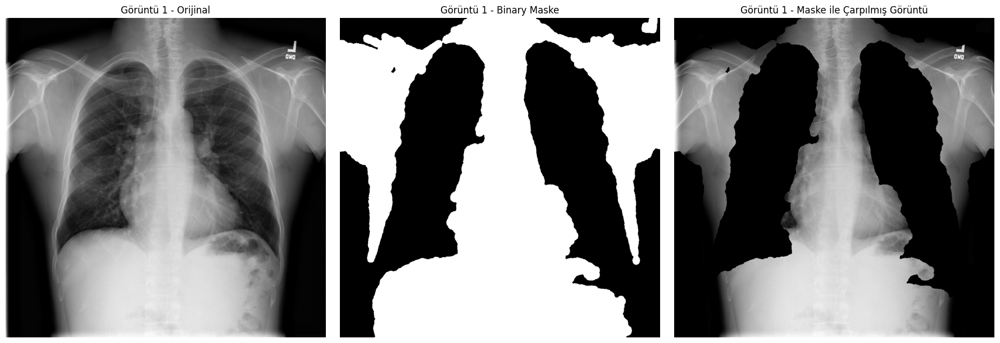

Görüntü 1 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




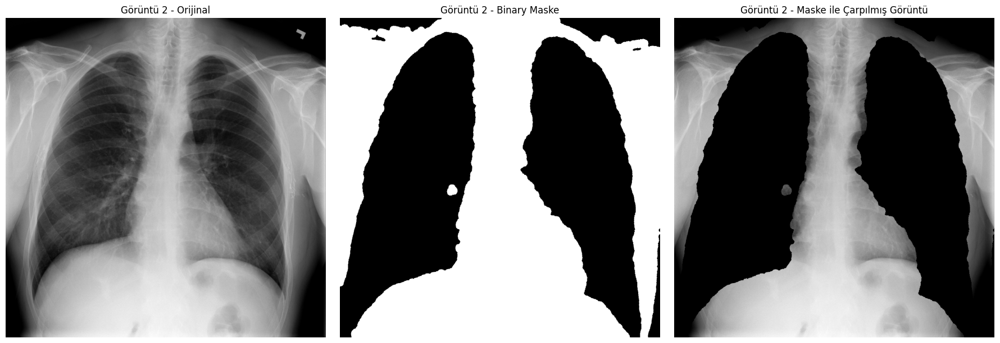

Görüntü 2 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




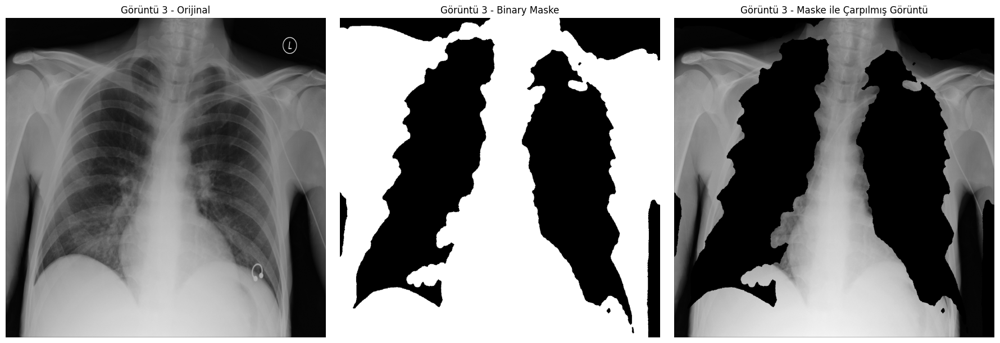

Görüntü 3 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




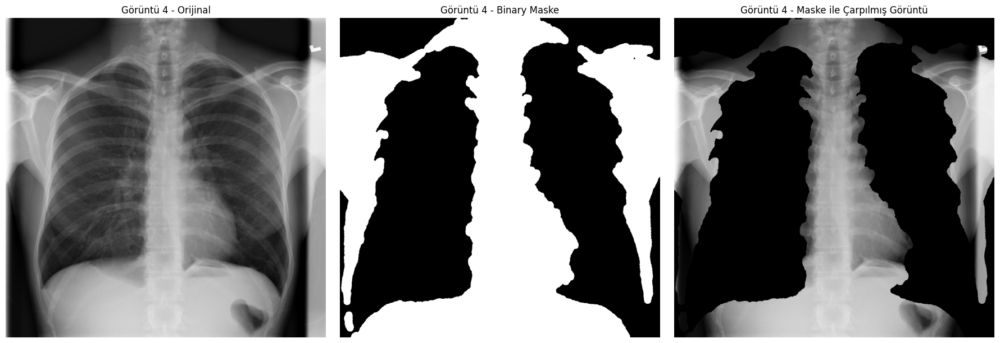

Görüntü 4 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




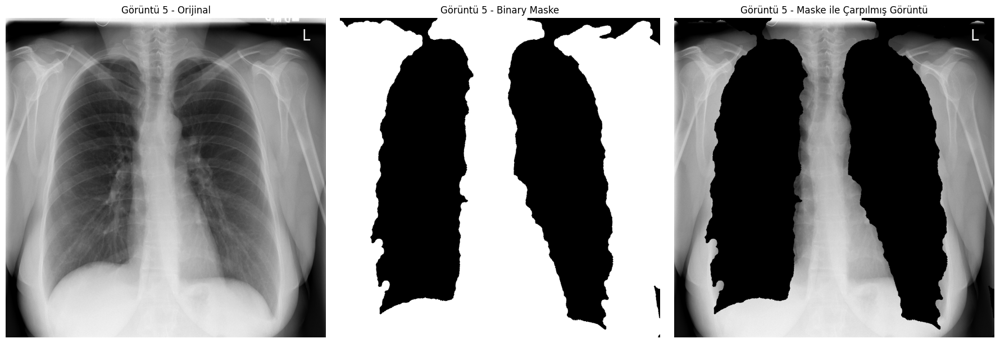

Görüntü 5 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




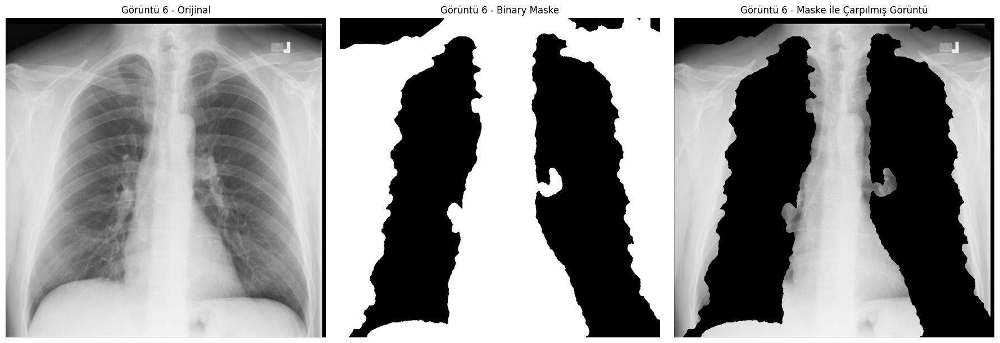

Görüntü 6 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




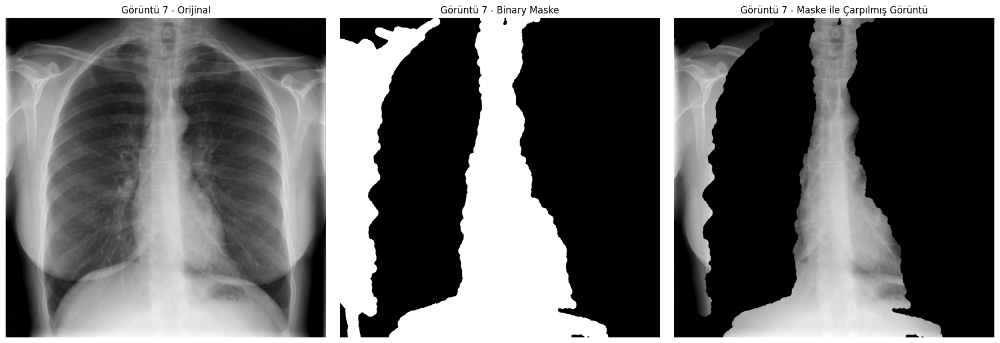

Görüntü 7 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




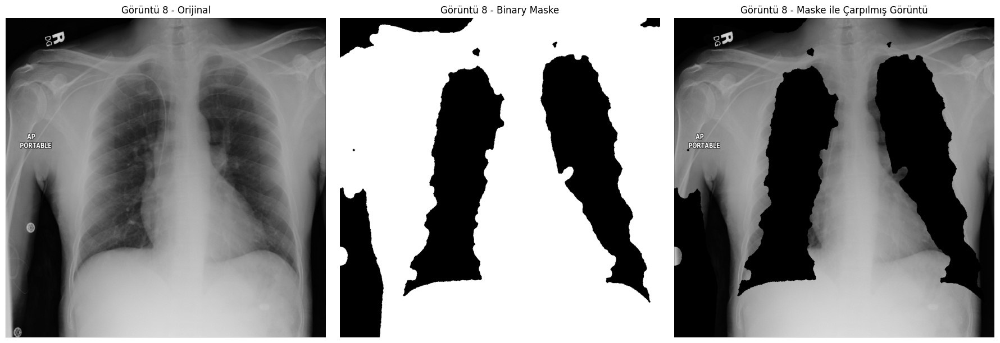

Görüntü 8 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




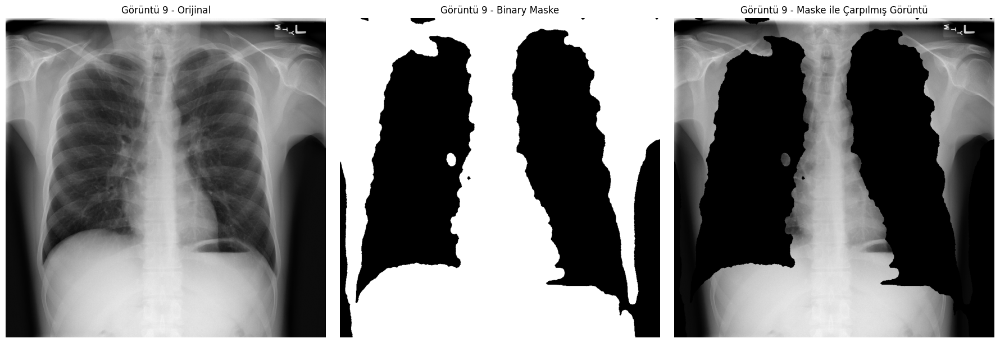

Görüntü 9 İçin Sonuçlar:
  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.
  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**




In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import regionprops, label
from skimage.morphology import binary_erosion, binary_dilation, binary_closing, disk

def detect_lungs_fixed(binary_image):
    """Bağlantılı bileşen analizi ile en büyük akciğer bölgelerini seç"""

    # Bağlantılı bileşenleri bul
    labeled_mask, num_labels = label(binary_image, return_num=True)

    # Regionprops ile bileşenlerin alanlarını ve centroidlerini al
    regions = regionprops(labeled_mask)

    # Eğer hiç bölge yoksa, maskeyi direkt dön
    if not regions:
        return np.zeros_like(binary_image), []

    # Alanlara göre sıralama (Büyükten küçüğe)
    sorted_regions = sorted(regions, key=lambda r: r.area, reverse=True)

    # İlk iki büyük bölgeyi al
    lung_mask = np.zeros_like(binary_image)
    for region in sorted_regions[:2]:  # En büyük 2 bölgeyi seçiyoruz
        lung_mask[labeled_mask == region.label] = 1

    return lung_mask, sorted_regions[:2]

# Görüntüler Üzerinde Uygula
for i, (binary_image, original_image) in enumerate(zip(binary_images, selected_images)):
    lung_mask, selected_regions = detect_lungs_fixed(binary_image)

    # Morfolojik İşlemler
    _, _, closed_mask = apply_morphology_fixed(lung_mask)

    # Maskeyi Orijinal Görüntü ile Çarp (Boyutları Eşitle)
    resized_mask = cv2.resize(closed_mask.astype(np.uint8), (original_image.shape[1], original_image.shape[0]))
    processed_result = original_image * resized_mask  # Maskeyi uygula

    # Sonuçları Görselleştir
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title(f"Görüntü {i+1} - Orijinal")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(resized_mask, cmap='gray')
    plt.title(f"Görüntü {i+1} - Binary Maske")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(processed_result, cmap='gray')
    plt.title(f"Görüntü {i+1} - Maske ile Çarpılmış Görüntü")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    # Yorumlama
    print(f"Görüntü {i+1} İçin Sonuçlar:")
    print("=" * 60)
    print(f"  - Bağlantılı bileşen analiziyle **en büyük 2 bölge** seçildi.")
    print(f"  - Eğer hala yanlış çıktı oluyorsa, **3. en büyük bölge de denenebilir.**")
    print("\n")


# Sonuçlar V2

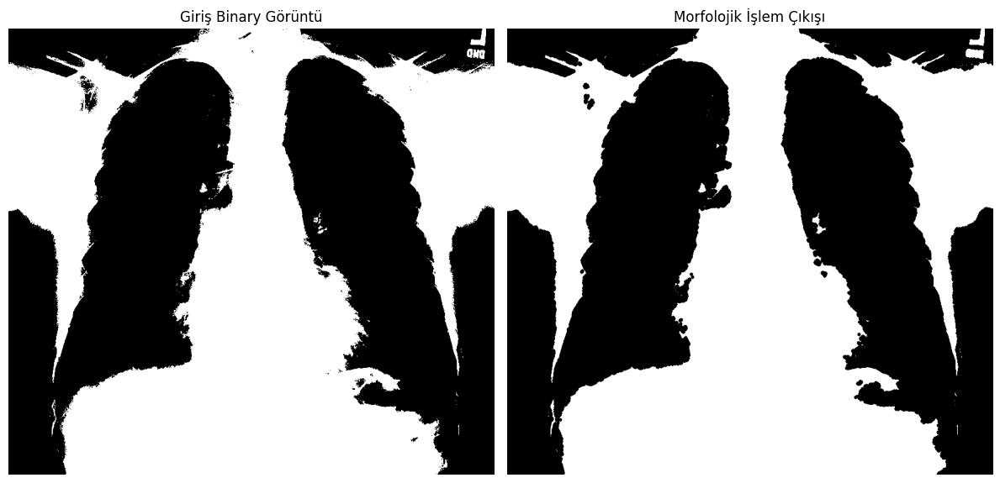

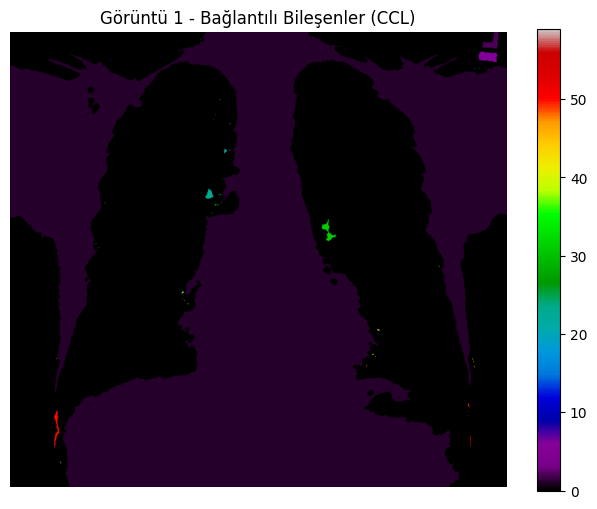

Görüntü 1 için bağlantılı bileşen sayısı: 60


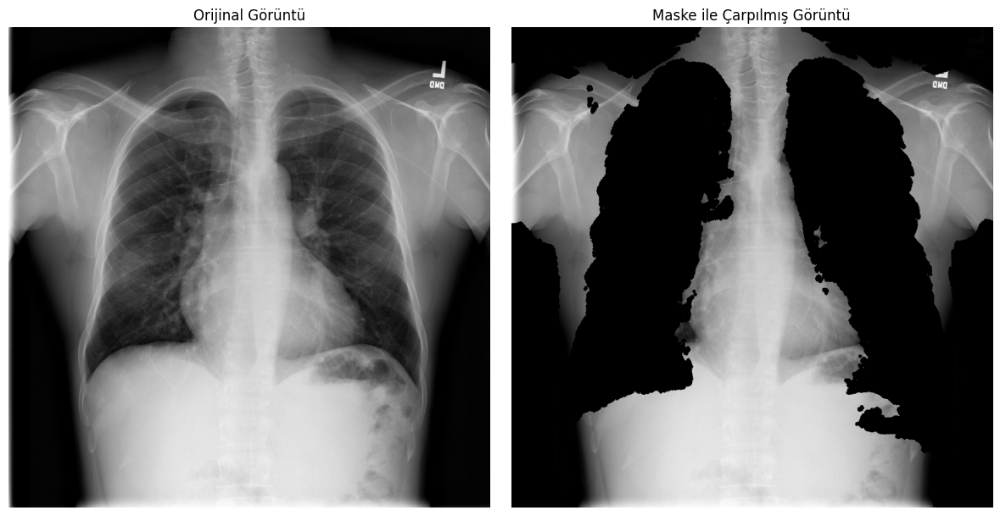

Görüntü 1 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




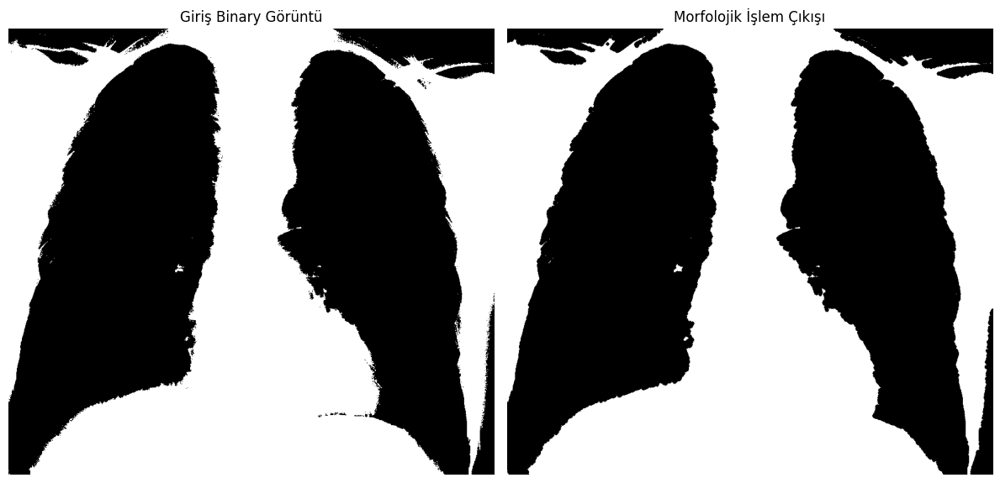

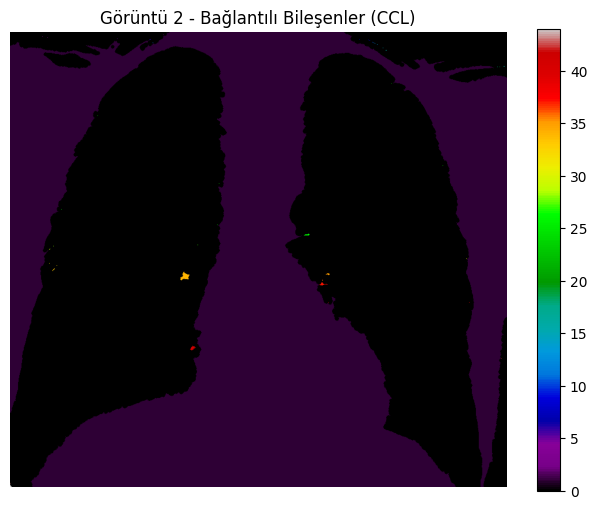

Görüntü 2 için bağlantılı bileşen sayısı: 45


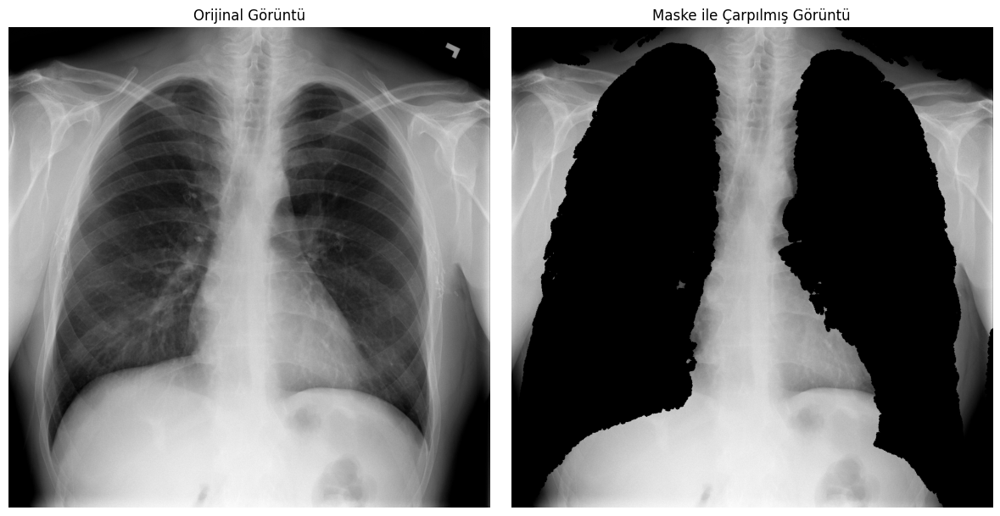

Görüntü 2 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




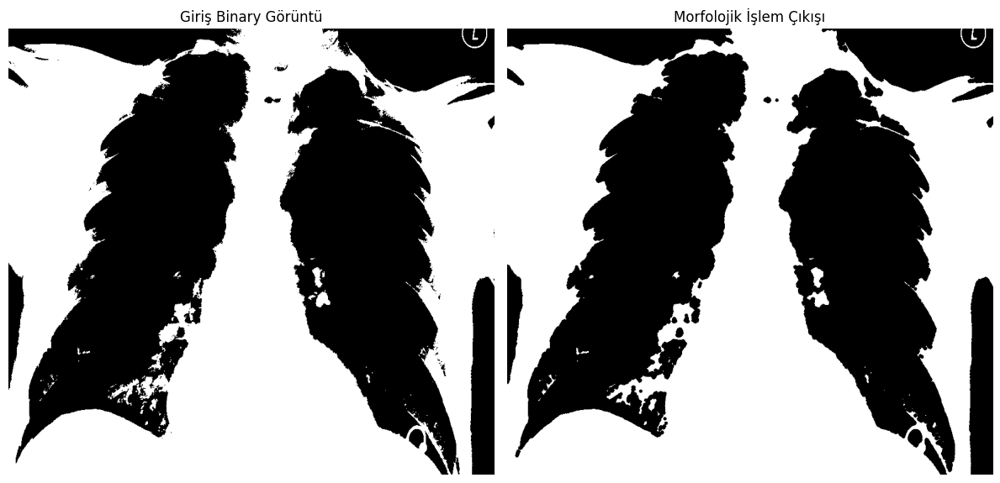

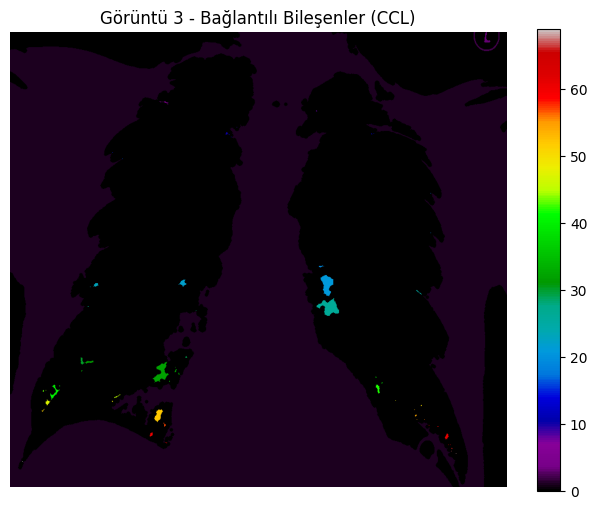

Görüntü 3 için bağlantılı bileşen sayısı: 70


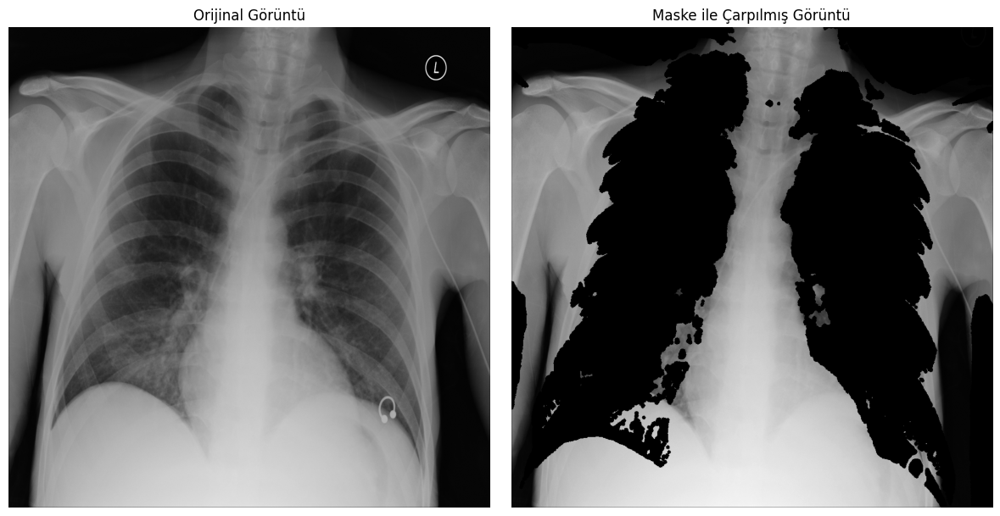

Görüntü 3 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




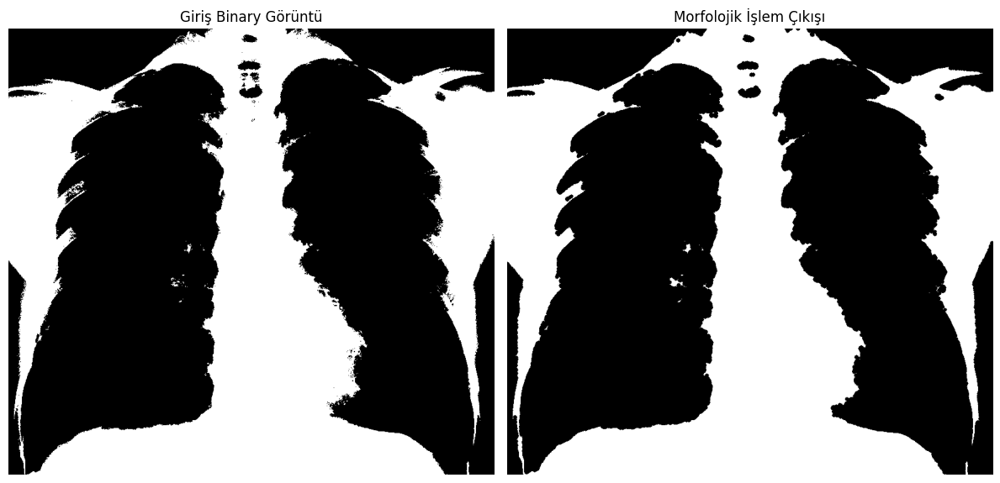

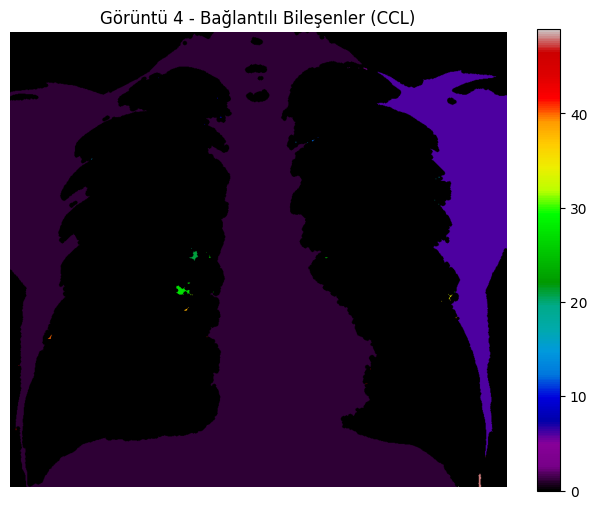

Görüntü 4 için bağlantılı bileşen sayısı: 50


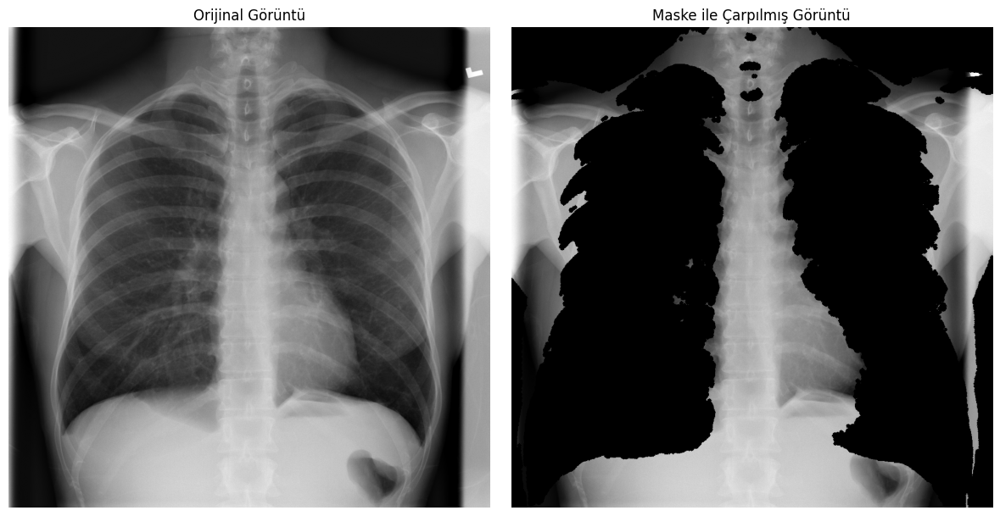

Görüntü 4 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




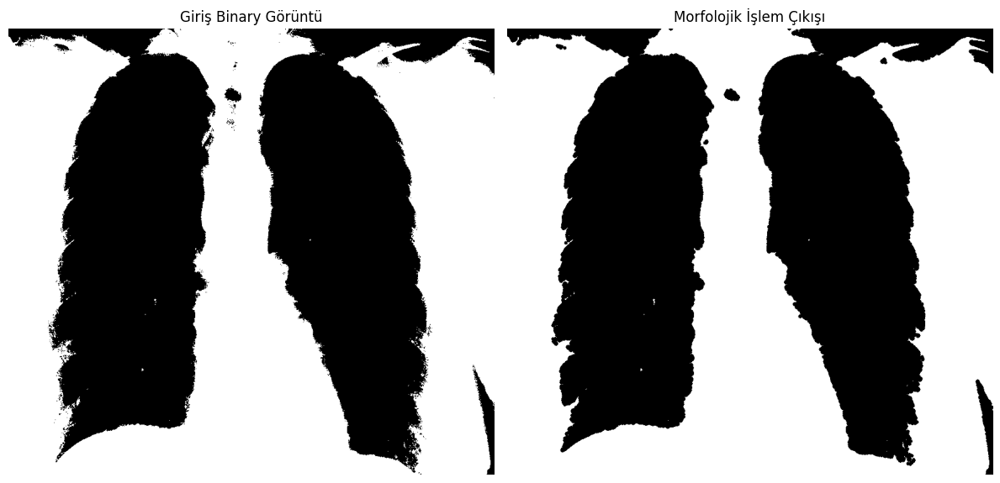

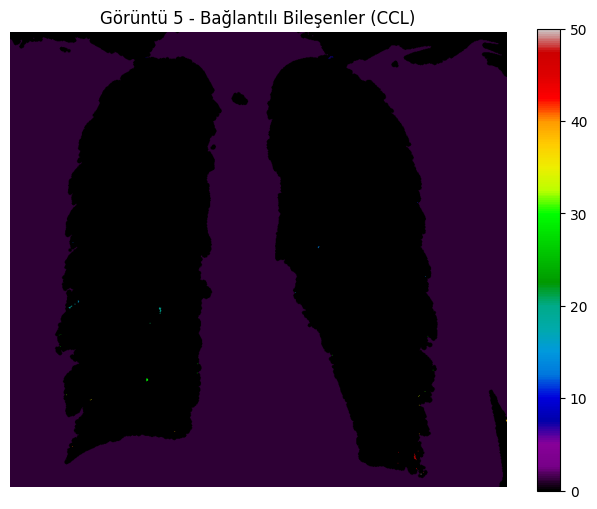

Görüntü 5 için bağlantılı bileşen sayısı: 51


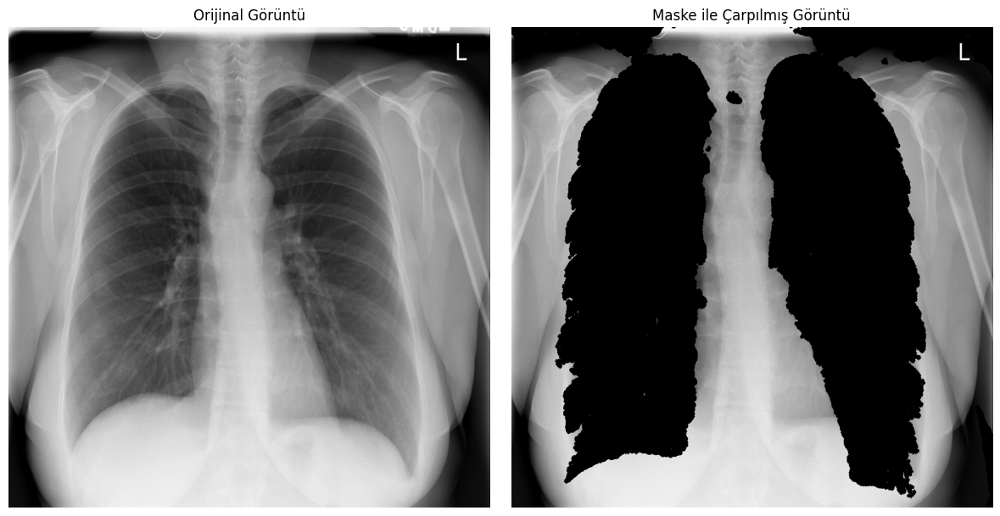

Görüntü 5 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




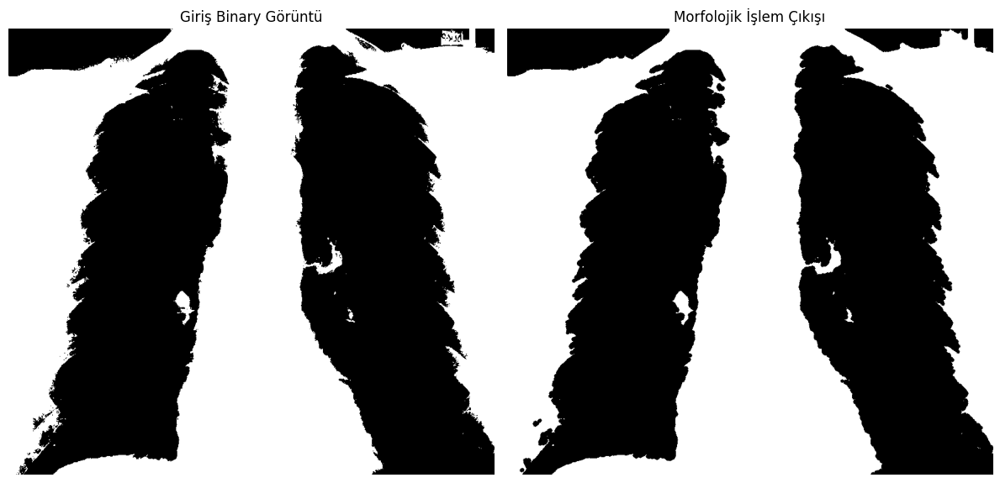

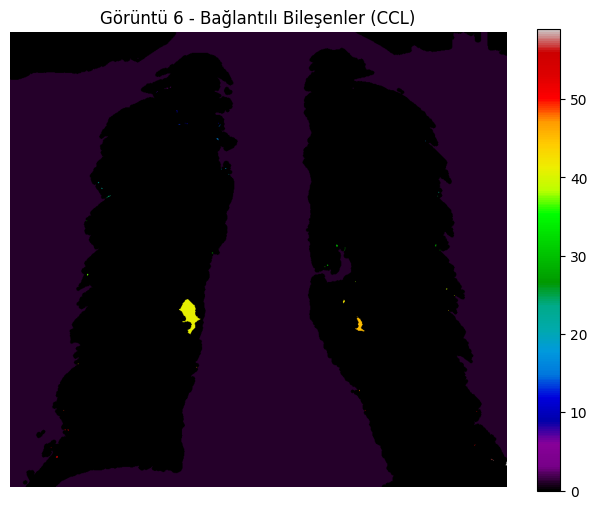

Görüntü 6 için bağlantılı bileşen sayısı: 60


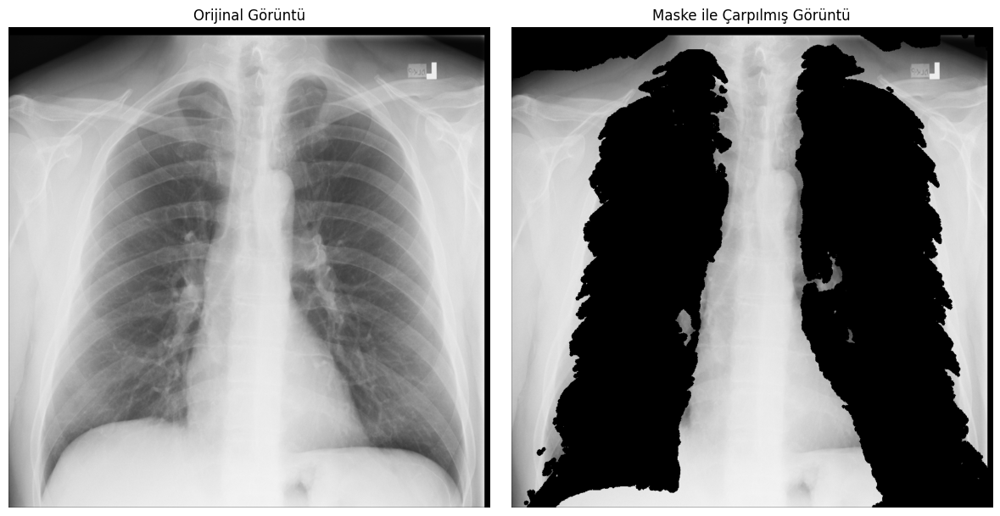

Görüntü 6 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




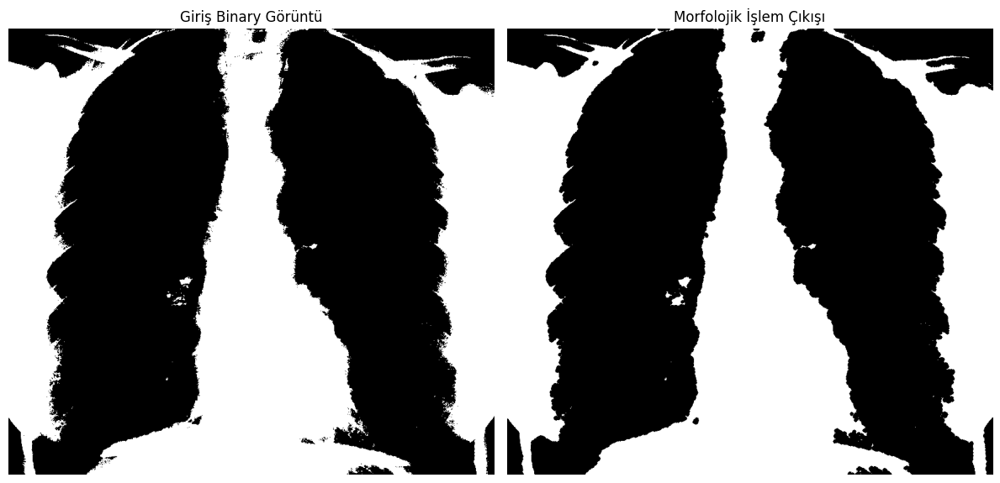

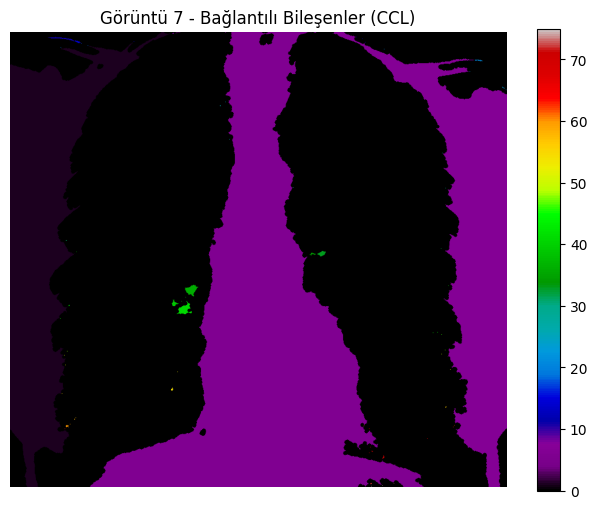

Görüntü 7 için bağlantılı bileşen sayısı: 76


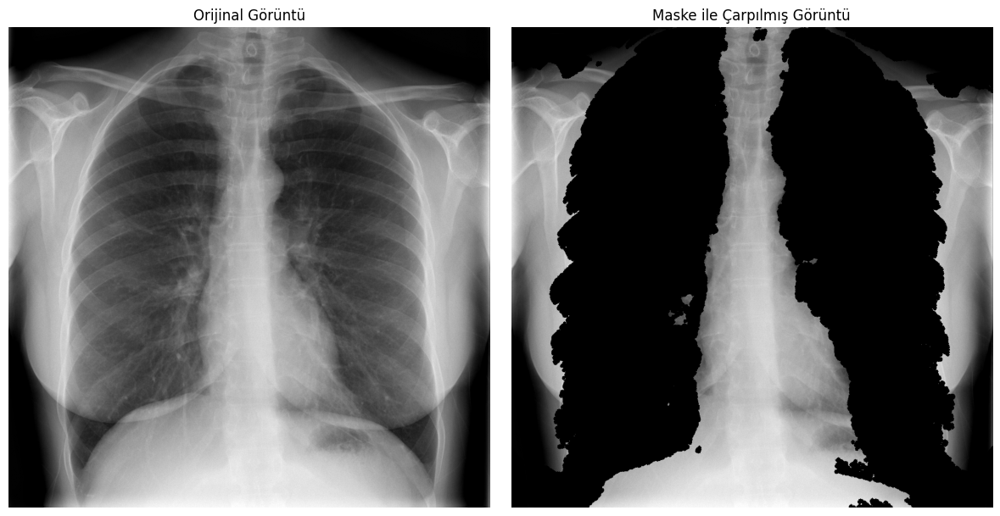

Görüntü 7 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




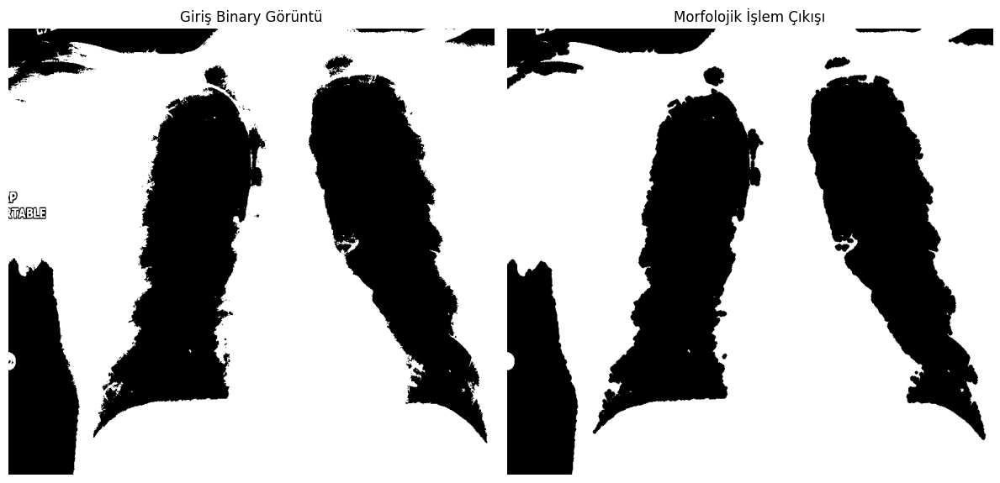

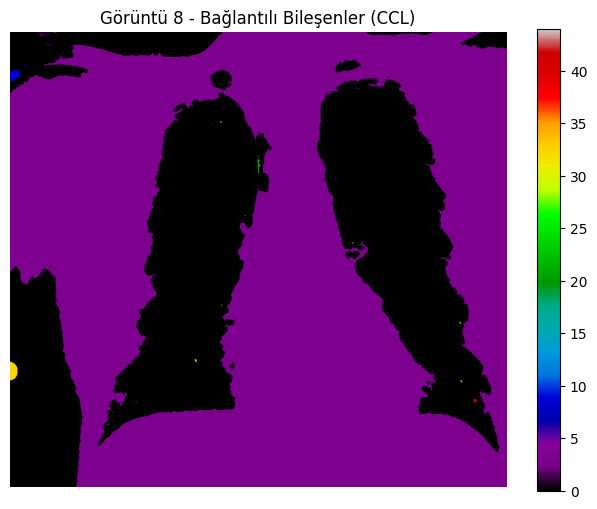

Görüntü 8 için bağlantılı bileşen sayısı: 45


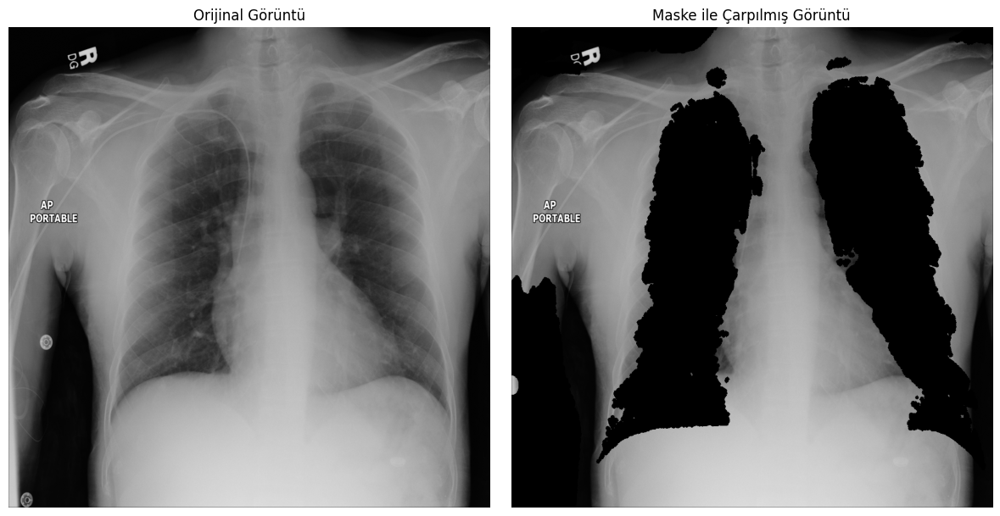

Görüntü 8 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




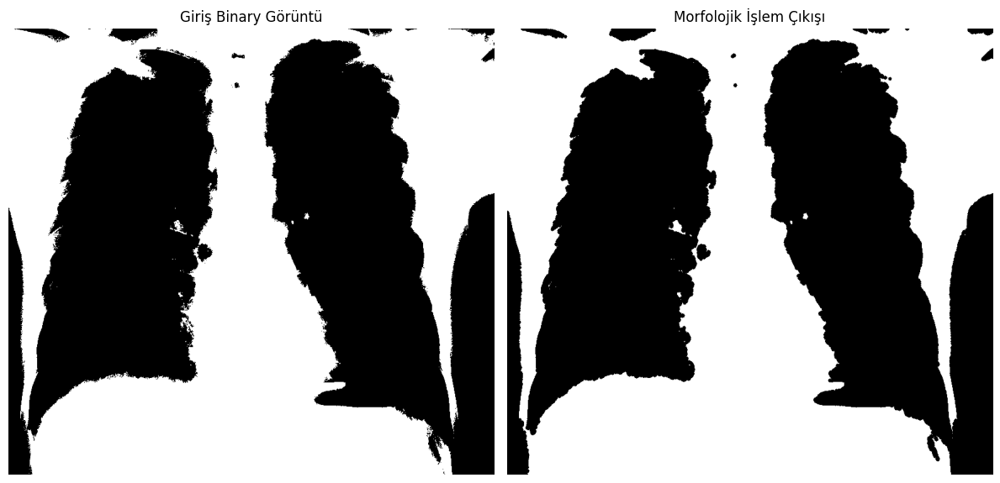

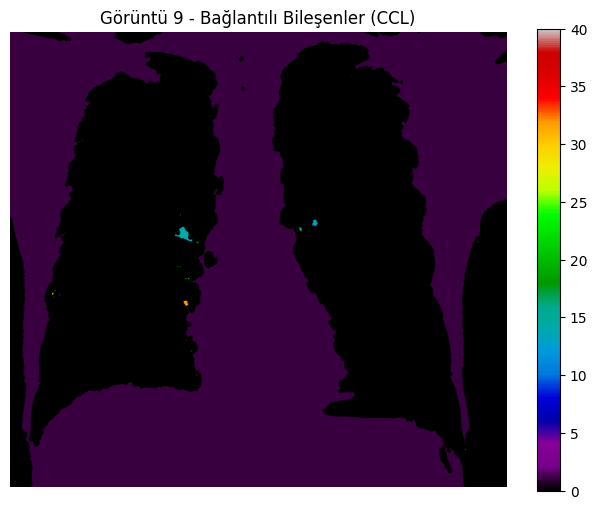

Görüntü 9 için bağlantılı bileşen sayısı: 41


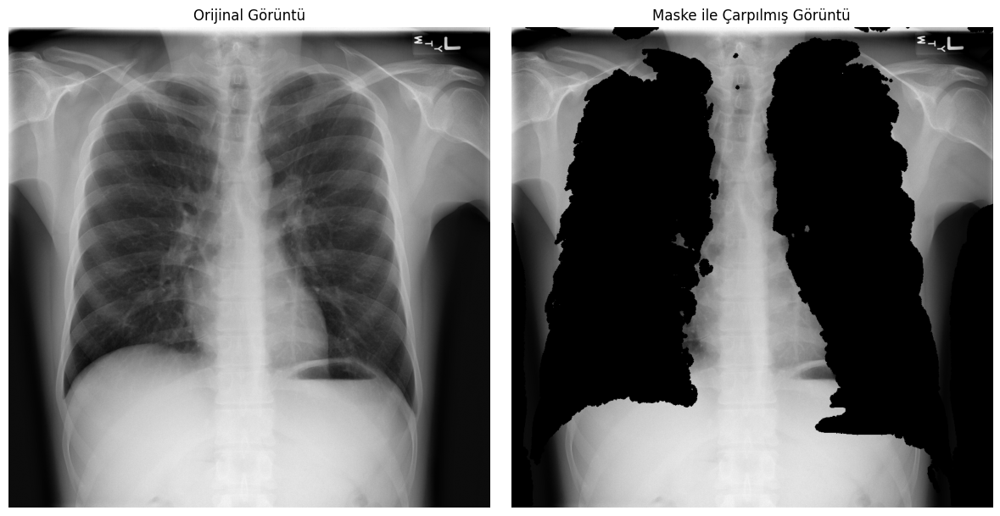

Görüntü 9 için İşlem Sonuçları:
  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.
  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.




In [ ]:


    # Son Aşama: Post-Processing (Morfolojik Operasyonlar ve CCL)
    if not binary_images:
        print("Hata: Binary görüntüler mevcut değil. Thresholding aşamasını kontrol edin.")
    else:
        for i, (binary_image, original_image) in enumerate(zip(binary_images, selected_images)):
            # Structuring Element ve Morfolojik Operasyonlar
            struct_elem = morphology.disk(3)  # Disk şeklinde bir structuring element
            morphed_image = morphology.binary_closing(binary_image, struct_elem)  # Closing işlemi

            # Giriş ve Çıkış Görüntülerini Görselleştir
            plt.figure(figsize=(12, 6))

            # Giriş Binary Görüntü
            plt.subplot(1, 2, 1)
            plt.imshow(binary_image, cmap='gray')
            plt.title("Giriş Binary Görüntü")
            plt.axis("off")

            # Çıkış Morfolojik İşlem Görüntüsü
            plt.subplot(1, 2, 2)
            plt.imshow(morphed_image, cmap='gray')
            plt.title("Morfolojik İşlem Çıkışı")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

            # CCL Uygulama
            num_labels, labels_im = cv2.connectedComponents(morphed_image.astype(np.uint8))

            # CCL Çıktısını Görselleştir
            plt.figure(figsize=(8, 6))
            plt.imshow(labels_im, cmap='nipy_spectral')
            plt.title(f"Görüntü {i+1} - Bağlantılı Bileşenler (CCL)")
            plt.axis("off")
            plt.colorbar()
            plt.show()

            # Bölge Sayısını Yazdır
            print(f"Görüntü {i+1} için bağlantılı bileşen sayısı: {num_labels}")

            # Maske ile Orijinal Görüntüyü Çarp (Boyutları eşitlemek için morphed_image'ı yeniden boyutlandır)
            resized_mask = cv2.resize(morphed_image.astype(np.uint8), (original_image.shape[1], original_image.shape[0]))
            processed_result = original_image * resized_mask

            # Orijinal Görüntü ve Sonuç Görüntüsünü Görselleştir
            plt.figure(figsize=(12, 6))

            plt.subplot(1, 2, 1)
            plt.imshow(original_image, cmap='gray')
            plt.title("Orijinal Görüntü")
            plt.axis("off")

            plt.subplot(1, 2, 2)
            plt.imshow(processed_result, cmap='gray')
            plt.title("Maske ile Çarpılmış Görüntü")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

            # Yorumlama
            print(f"Görüntü {i+1} için İşlem Sonuçları:")
            print("  - Orijinal görüntü ile maske çarpılarak sadece ilgili bölgeler ön plana çıkarılmıştır.")
            print("  - Maske sayesinde gereksiz bölgeler kaldırılmıştır.")
            print("\n")

